In [2]:
import numpy as np
import pandas as pd
# import scanpy.api as sc
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import matplotlib as mpl
mpl.rcParams['figure.facecolor'] = (1,1,1,1)
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42

In [3]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='viridis', transparent=False, frameon=False, fontsize=20)

import matplotlib as mpl
# 2 lines below solved the facecolor problem.
# mpl.rcParams['figure.facecolor'] = 'white'
mpl.rcParams['figure.facecolor'] = (1,1,1,1)
sc.settings.autosave = True
sc.logging.print_versions()

version = '210711_merged_thymoma_MG21.22.23.03_TEC'

# file_mat = 'F1314_200323_222536_summary/10425963-2_3DE_genematrix.csv'


results_file_stroma = './scanpy/{}/merge_stroma.h5ad'.format(version)
results_file_TEC = './scanpy/{}/merge_TEC.h5ad'.format(version)
results_file_stroma_minor_cluster = './scanpy/{}/merge_stroma_minor_cluster.h5ad'.format(version)
results_file_cg_stroma_minor_cluster = './scanpy/{}/merge_cg_stroma_minor_cluster.h5ad'.format(version)

results_file_master = './scanpy/210711_merged_thymoma_MG21.22.23.03/merge.h5ad'
results_raw_file_master = './scanpy/210711_merged_thymoma_MG21.22.23.03/merge.raw.h5ad'

# for cellphonedb
raw_matrix = './scanpy/{}/merge.raw.tsv'.format(version)

sc.settings.figdir = './scanpy/{}/graph'.format(version)
sc.settings.cachedir = './scanpy/{}/cache'.format(version)
# %config InlineBackend.figure_format = 'retina'

-----
anndata     0.7.6
scanpy      1.7.2
sinfo       0.3.1
-----
PIL                 8.1.2
anndata             0.7.6
backcall            0.2.0
cffi                1.14.5
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.1
decorator           4.4.2
get_version         2.1
google              NA
h5py                2.10.0
igraph              0.9.1
ipykernel           5.3.4
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.17.2
joblib              1.0.1
kiwisolver          1.3.1
legacy_api_wrap     1.2
leidenalg           0.8.4
llvmlite            0.34.0
matplotlib          3.4.1
mpl_toolkits        NA
natsort             7.1.1
numba               0.51.0
numexpr             2.7.3
numpy               1.20.2
packaging           20.9
pandas              1.2.4
parso               0.7.0
pexpect             4.8.0
pickleshare         0.7.5
pkg_resources       NA
prompt_toolkit      3.0.8
psutil              5.8.0
ptyproce

In [4]:
adata_raw = sc.read(results_raw_file_master)
adata = sc.read(results_file_master)

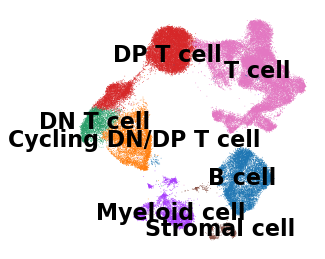

In [4]:
sc.pl.umap(adata, color='major_cluster', legend_loc='on data', title='', frameon=False, save='major_cluster_all')

In [5]:
adata

AnnData object with n_obs × n_vars = 65935 × 1506
    obs: 'sample', 'sample_type', 'site', 'fraction', 'n_genes', 'individual', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden', 'leiden_R', 'major_cluster'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'individual_colors', 'leiden', 'leiden_R_colors', 'leiden_colors', 'major_cluster_colors', 'neighbors', 'pca', 'rank_genes_groups', 'sample_colors', 'site_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [7]:
adata_cp = adata_raw[adata[adata.obs['major_cluster'] == 'Stromal cell'].obs.index].copy()

# for c in ['score_DEGs', 'score_yellow', 'score_GWAS']:
#     adata_cp.obs[c] = adata.obs.loc[adata_cp.obs.index, c]
    
adata = adata_cp.copy()
adata_cp = None

In [8]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
adata.raw = sc.pp.log1p(adata, copy=True)

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


Text(0.5, 1.0, 'Run')

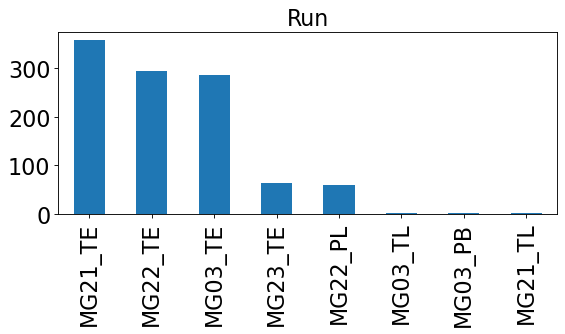

In [9]:
plt.figure(figsize=(8,3))
pd.Series(adata.obs['sample']).value_counts().plot(kind='bar')
plt.grid(None)
plt.title('Run')
# plt.savefig(str(sc.settings.figdir) + '/run.pdf', bbox_inches='tight')

In [10]:
adata = adata[adata.obs['sample'].isin(['MG03_TE', 'MG21_TE', 'MG22_TE', 'MG23_TE'])]

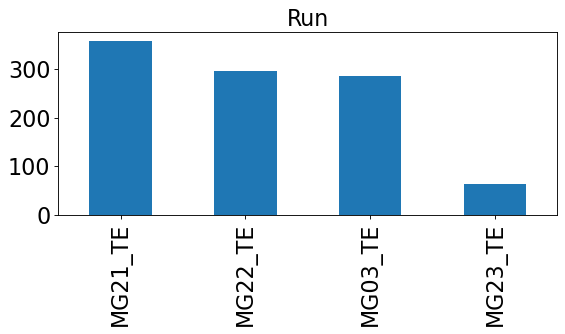

In [11]:
plt.figure(figsize=(8,3))
pd.Series(adata.obs['sample']).value_counts().plot(kind='bar')
plt.grid(None)
plt.title('Run')
plt.savefig(str(sc.settings.figdir) + '/run.pdf', bbox_inches='tight')

extracting highly variable genes
    finished (0:00:00)


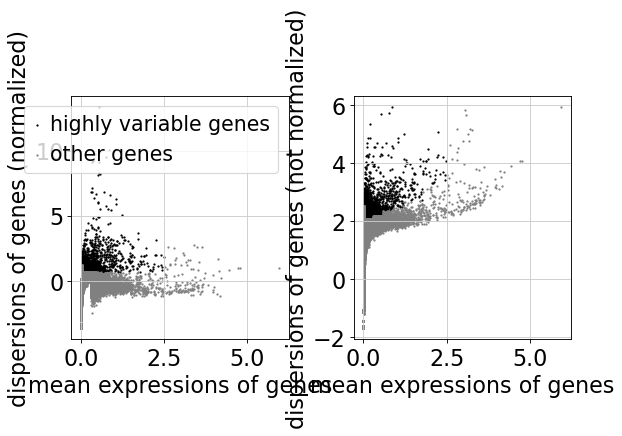

[4087, 36601]


In [12]:
filter_result = sc.pp.filter_genes_dispersion(
    adata.X, min_mean=0.0125, max_mean=2.5, min_disp=0.7)
sc.pl.filter_genes_dispersion(filter_result)
print([sum([i[0] for i in filter_result]),len(filter_result)])

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:375: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=50
    finished (0:00:00)


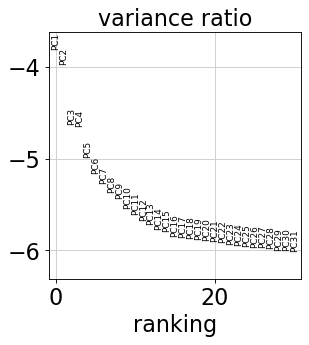

In [13]:
adata = adata[:, filter_result.gene_subset]
sc.pp.log1p(adata)
sc.pp.scale(adata, max_value=10)
sc.tl.pca(adata)
adata.obsm['X_pca'] *= -1  # multiply by -1 to match Seurat
sc.pl.pca_variance_ratio(adata, log=True)

In [14]:
sc.external.pp.bbknn(adata, batch_key='sample')
sc.tl.umap(adata, spread=1.2)
sc.tl.leiden(adata, resolution=1)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)
running Leiden clustering
    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


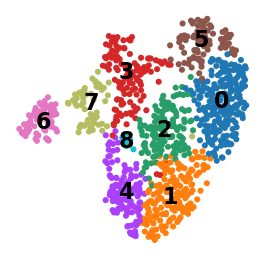

In [15]:
sc.pl.umap(adata, color='leiden', legend_loc='on data', title='', frameon=False, save='leiden.pdf')

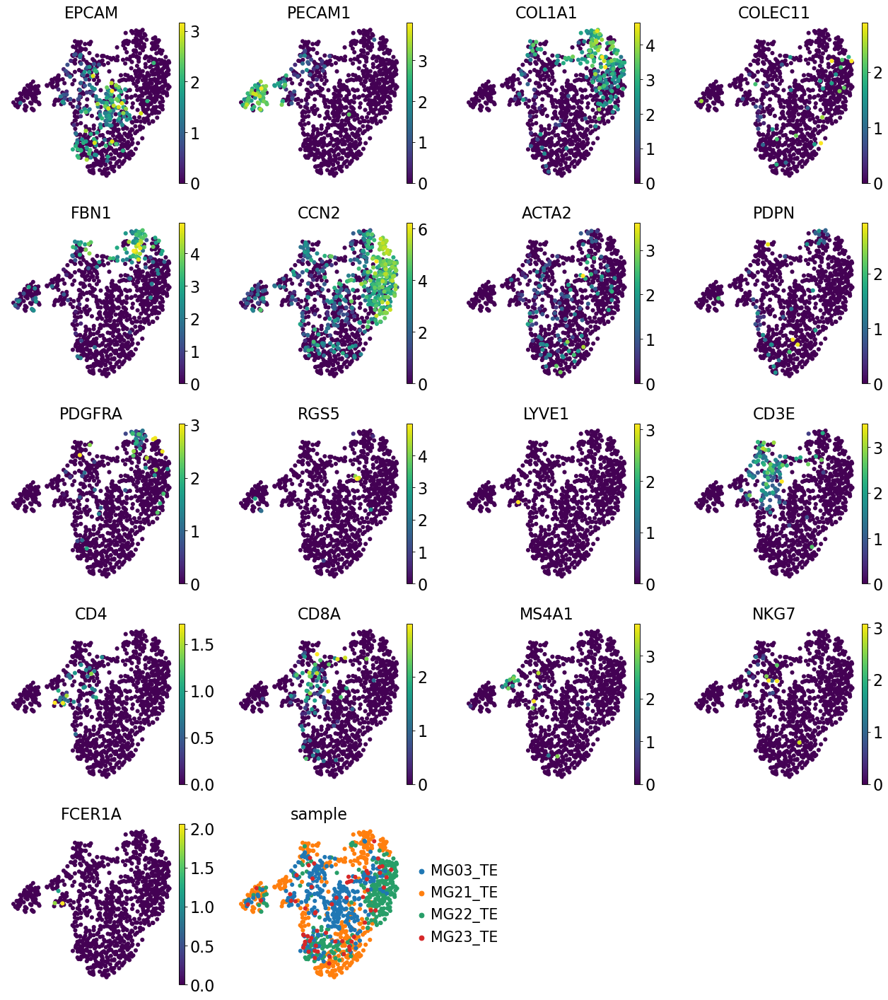

In [16]:
list_stroma = ['EPCAM', 'PECAM1', 'COL1A1', 'COLEC11', 'FBN1', 'CCN2', 'ACTA2', 'PDPN', 'PDGFRA', 'RGS5', 'LYVE1', 'CD3E', 'CD4', 'CD8A', 'MS4A1',
                         'NKG7', 'FCER1A']
sc.pl.umap(adata, color=list_stroma + ['sample'],
          save='stroma_panel', ncols=4)

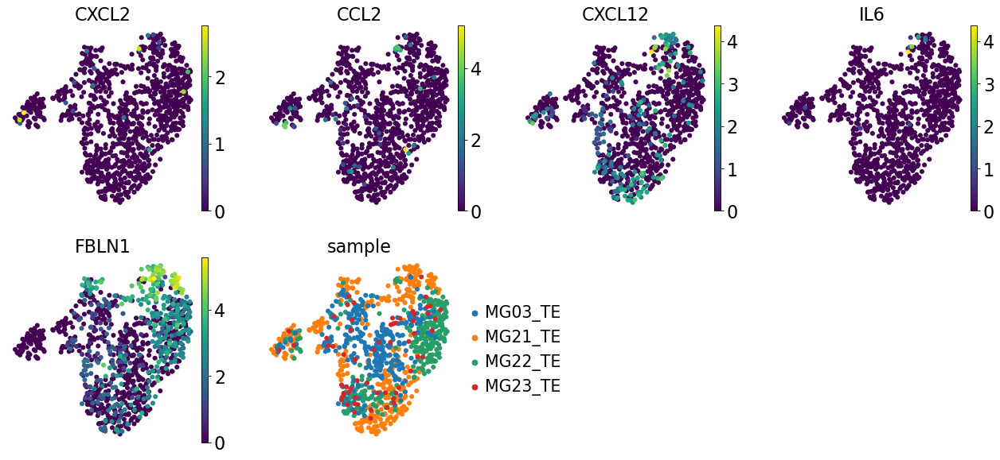

In [17]:
list_stroma = ['CXCL2', 'CCL2', 'CXCL12', 'IL6', 'FBLN1']
sc.pl.umap(adata, color=list_stroma + ['sample'],
          save=False, ncols=4)

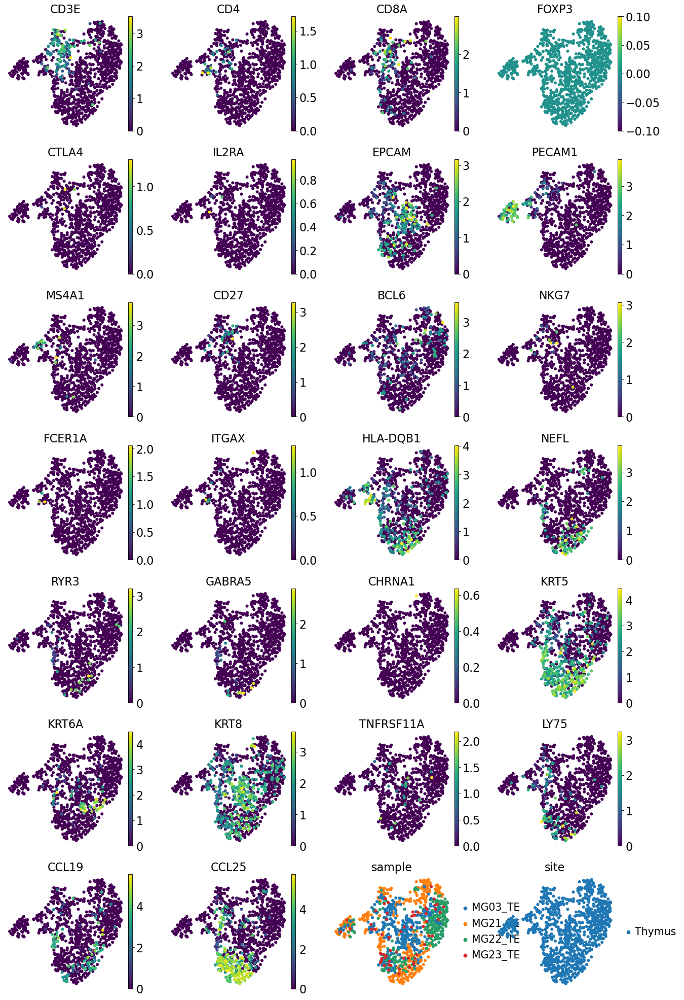

In [18]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata, color=['CD3E', 'CD4', 'CD8A', 'FOXP3', 'CTLA4', 'IL2RA', 'EPCAM', 'PECAM1', 'MS4A1', 'CD27', 'BCL6',
                         'NKG7', 'FCER1A', 'ITGAX', 'HLA-DQB1', 'NEFL', 'RYR3', 'GABRA5', 'CHRNA1', 
                         'KRT5', 'KRT6A', 'KRT8', 'TNFRSF11A', 'LY75', 
                        'CCL19', 'CCL25',
                         'sample', 'site'],
          save='panel', ncols=4)

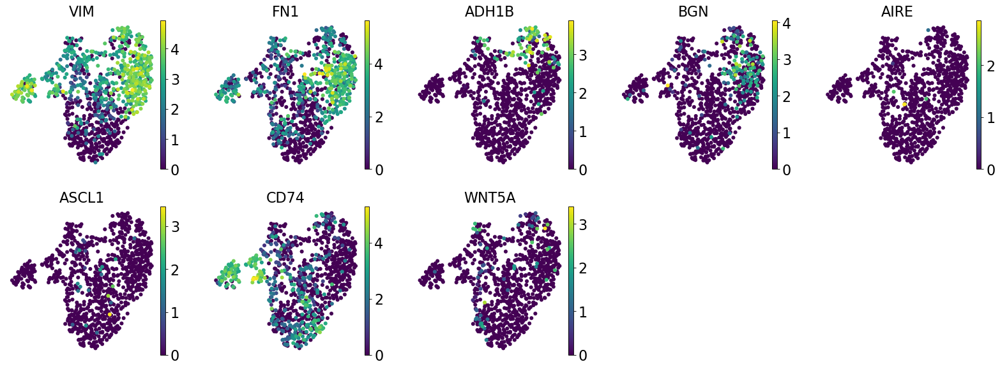

In [19]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata, color=['VIM', 'FN1', 'ADH1B', 'BGN', 'AIRE', 'ASCL1', 'CD74', 'WNT5A'],
          save=False, ncols=5)

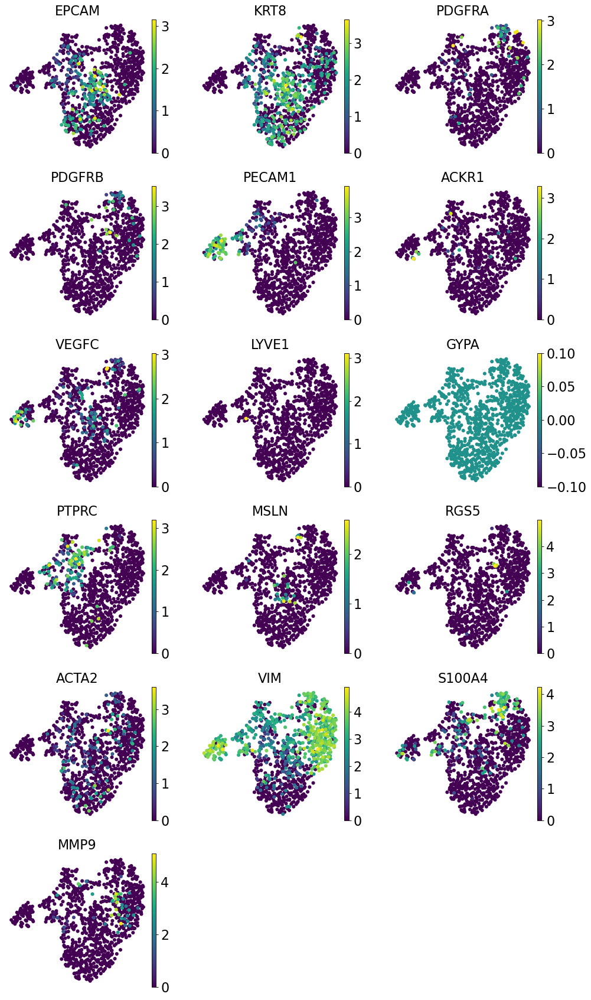

In [20]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata, color=['EPCAM', 'KRT8', 'PDGFRA',
                        'PDGFRB', 'PECAM1', 'ACKR1',
                        'VEGFC', 'LYVE1', 'GYPA', 'PTPRC', 'MSLN',
                        'RGS5', 'ACTA2', 'VIM', 'S100A4', 'MMP9'],
          save=False, ncols=3)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


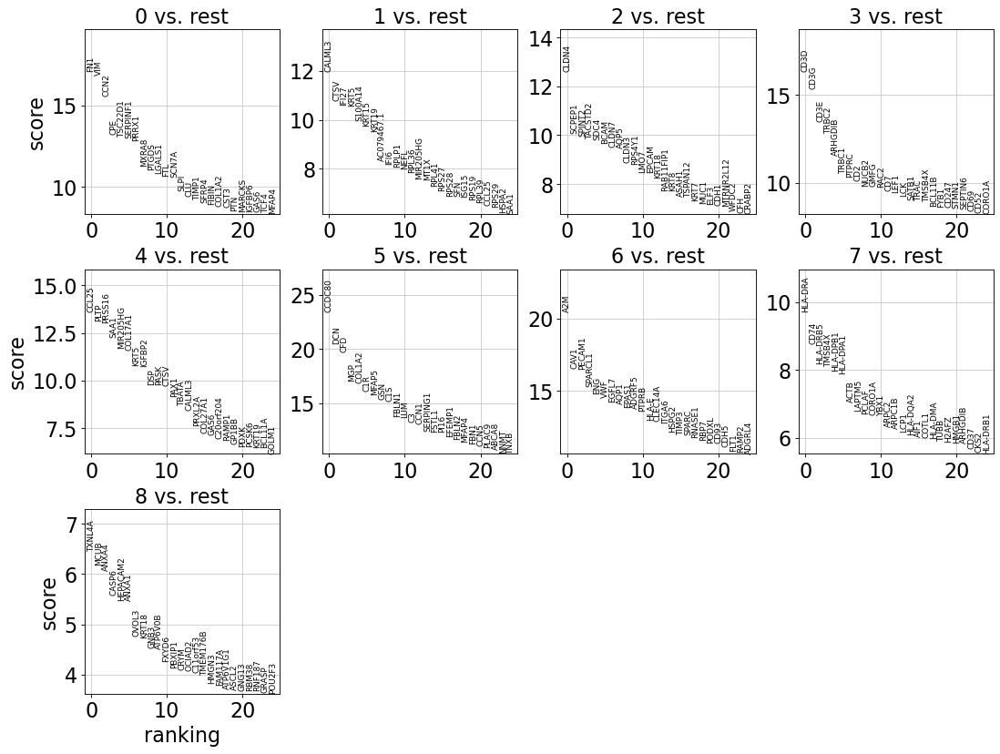

In [21]:
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test_overestim_var')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

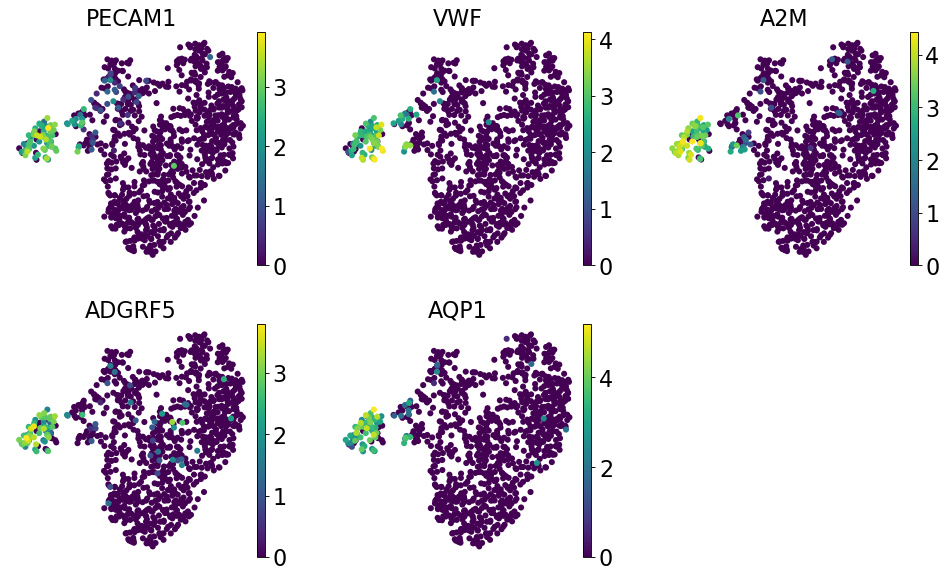

In [22]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata, color=['PECAM1','VWF','A2M','ADGRF5','AQP1'],
          save=False, ncols=3)

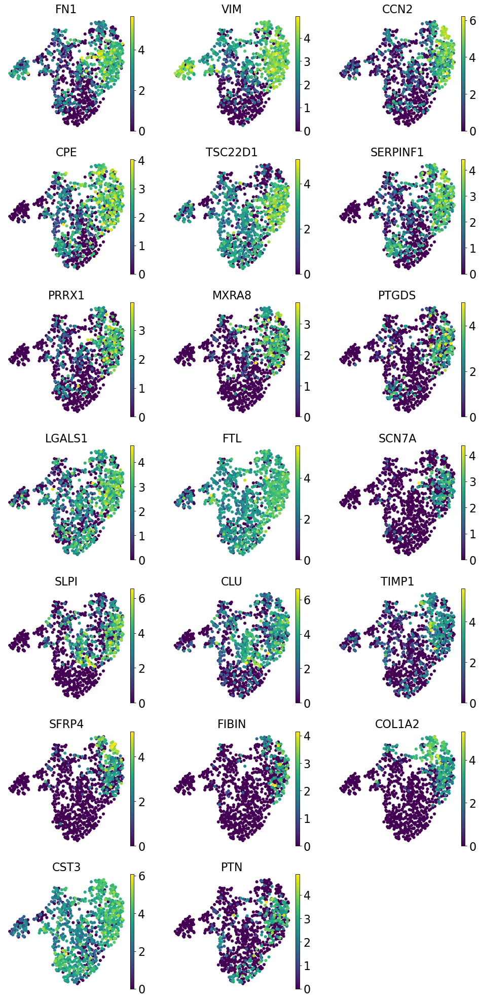

In [23]:
sc.pl.umap(adata, color=list(adata.uns['rank_genes_groups']['names']['0'])[:20],
          save=False, ncols=3)

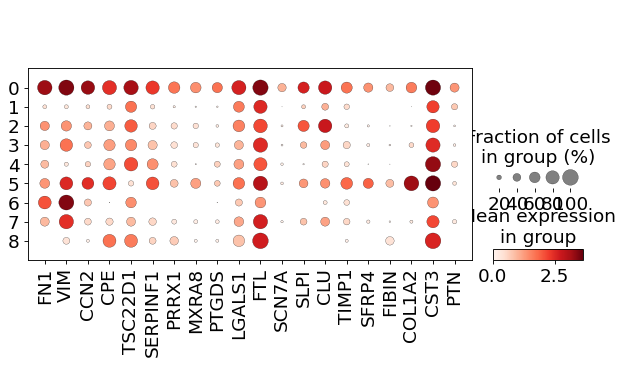

In [24]:
sc.pl.dotplot(adata, list(adata.uns['rank_genes_groups']['names']['0'])[:20], groupby='leiden')

In [25]:
print('\n'.join(list(adata.uns['rank_genes_groups']['names']['0'])[:100]))

FN1
VIM
CCN2
CPE
TSC22D1
SERPINF1
PRRX1
MXRA8
PTGDS
LGALS1
FTL
SCN7A
SLPI
CLU
TIMP1
SFRP4
FIBIN
COL1A2
CST3
PTN
MARCKS
IGFBP6
GAS6
TCF4
MFAP4
PDGFRL
EDNRA
EGFL6
S100A6
CD63
COLEC12
MATN4
ADIRF
CDH11
COL6A2
RPL7A
EMP3
SLIT2
BGN
TSC22D3
RPL13
TPM2
IGFBP5
SERPINE2
EDN3
LHFPL6
GMDS
ID3
CYP1B1
COL1A1
RPL10
MXRA5
DCN
MDK
SBSPON
GADD45B
TAGLN
PHLDA1
RPS3
RPS8
PMP22
H2AFJ
RPL9
CCDC3
RPL32
EGFLAM
RPL29
RARRES2
PCOLCE
SFRP2
LY6K
RPS23
CD81
DDIT4
BMP4
RPS18
RPL18A
MAFB
SIX1
ITM2B
EBF1
RACK1
FBLN1
TMEM204
COL3A1
TWIST1
FGFR1
LONRF1
ANKH
RPL18
CCDC68
RPL10A
NDN
COL6A1
RERG
SERPINI1
NR2F2
MT-CYB
RPL24
NRP2


ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


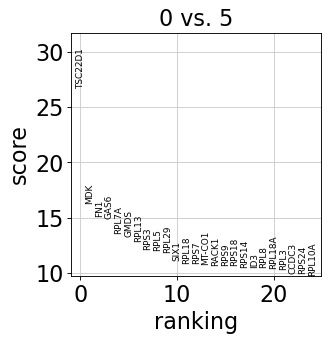

In [26]:
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test_overestim_var', reference='5', groups=['0'])
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

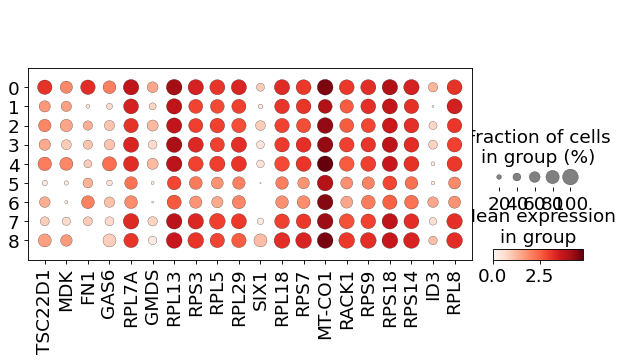

In [27]:
sc.pl.dotplot(adata, list(adata.uns['rank_genes_groups']['names']['0'])[:20], groupby='leiden')

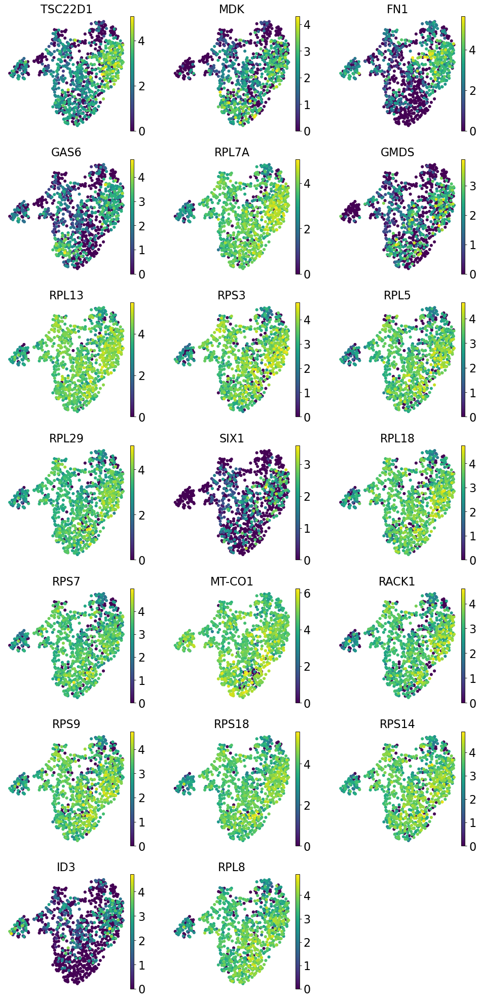

In [28]:
sc.pl.umap(adata, color=list(adata.uns['rank_genes_groups']['names']['0'])[:20],
          save=False, ncols=3)

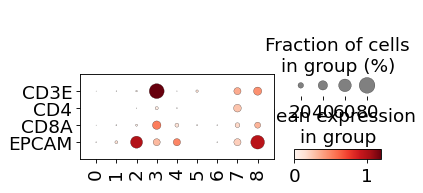

In [29]:
sc.pl.dotplot(adata, var_names=['CD3E', 'CD4', 'CD8A', 'EPCAM'], groupby='leiden', swap_axes=True)

In [30]:
df_clusters =  pd.read_csv('210430_clusters/Stromal_cell_clusters.csv', index_col=0)
df_clusters.index = df_clusters.index.astype(str)
adata.obs['Stromal_cluster'] = [df_clusters.loc[x, 'cluster'] for x in adata.obs['leiden']]
df_clusters

,cluster
leiden,
0,Normal fibroblast
1,TEC
2,TEC
3,Doublet
4,TEC
5,Tumor associated fibroblast
6,Endothelial cell
7,Doublet
8,Doublet


... storing 'Stromal_cluster' as categorical


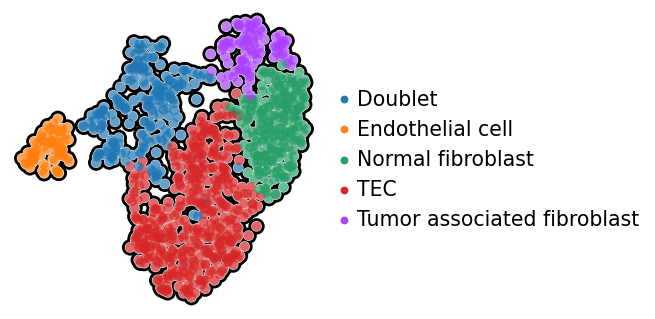

In [31]:
from matplotlib import rcParams

rcParams['figure.figsize'] = 5, 5
sc.pl.umap(adata, color='Stromal_cluster', add_outline=True,
           title='', frameon=False, save='Stromal_cluster.pdf', s=300)

sc.settings.set_figure_params(dpi=80, color_map='viridis', transparent=False, frameon=False, fontsize=20)

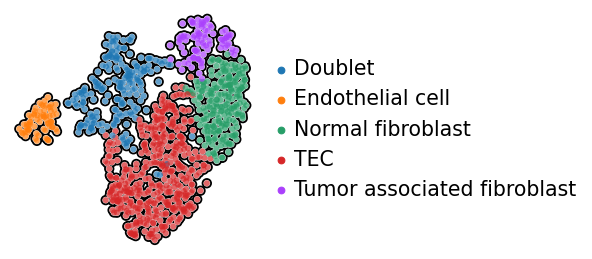

In [32]:
sc.pl.umap(adata, color='Stromal_cluster', title='', add_outline=True, 
           frameon=False, save='Stromal_cluster_out.pdf')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


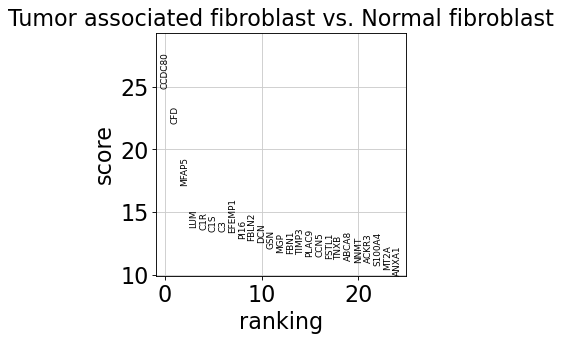

In [33]:
sc.tl.rank_genes_groups(adata, 'Stromal_cluster', method='t-test_overestim_var', 
                        reference='Normal fibroblast', groups=['Tumor associated fibroblast'],
                        rankby_abs=False)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


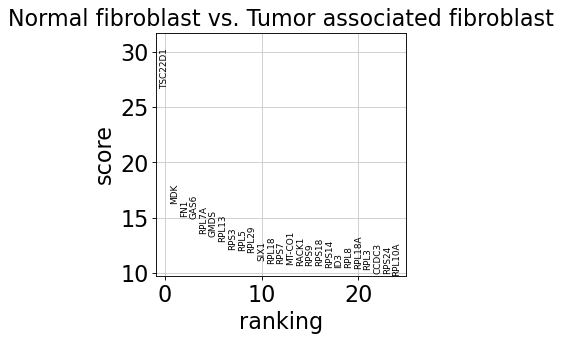

In [34]:
sc.tl.rank_genes_groups(adata, 'Stromal_cluster', method='t-test_overestim_var', 
                        reference='Tumor associated fibroblast', groups=['Normal fibroblast'],
                        rankby_abs=False)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

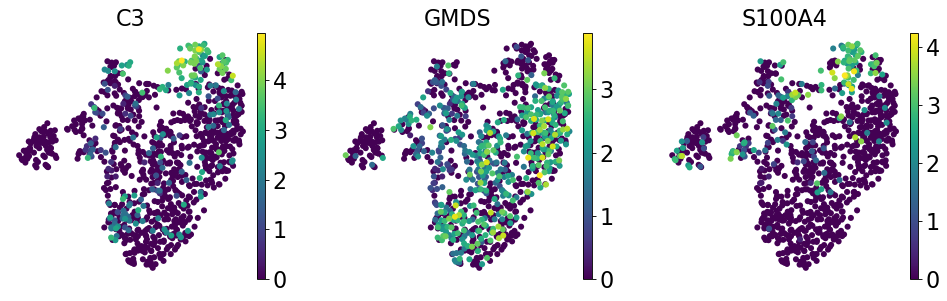

In [35]:
sc.pl.umap(adata, color=['C3', 'GMDS', 'S100A4'])

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


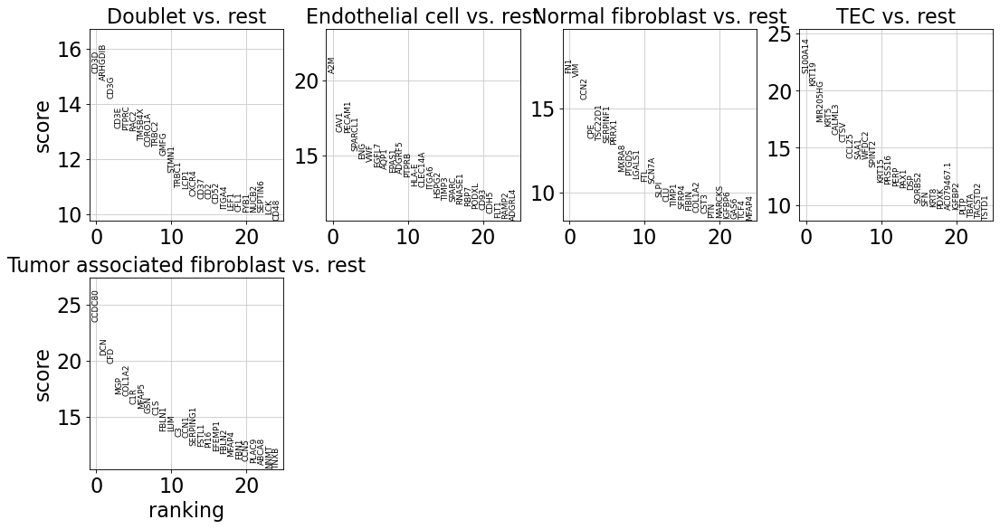

In [36]:
sc.tl.rank_genes_groups(adata, 'Stromal_cluster', method='t-test_overestim_var',
                        rankby_abs=False)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [37]:
print('\n'.join(list(adata.uns['rank_genes_groups']['names']['Normal fibroblast'])[:100]))

FN1
VIM
CCN2
CPE
TSC22D1
SERPINF1
PRRX1
MXRA8
PTGDS
LGALS1
FTL
SCN7A
SLPI
CLU
TIMP1
SFRP4
FIBIN
COL1A2
CST3
PTN
MARCKS
IGFBP6
GAS6
TCF4
MFAP4
PDGFRL
EDNRA
EGFL6
S100A6
CD63
COLEC12
MATN4
ADIRF
CDH11
COL6A2
RPL7A
EMP3
SLIT2
BGN
TSC22D3
RPL13
TPM2
IGFBP5
SERPINE2
EDN3
LHFPL6
GMDS
ID3
CYP1B1
COL1A1
RPL10
MXRA5
DCN
MDK
SBSPON
GADD45B
TAGLN
PHLDA1
RPS3
RPS8
PMP22
H2AFJ
RPL9
CCDC3
RPL32
EGFLAM
RPL29
RARRES2
PCOLCE
SFRP2
LY6K
RPS23
CD81
DDIT4
BMP4
RPS18
RPL18A
MAFB
SIX1
ITM2B
EBF1
RACK1
FBLN1
TMEM204
COL3A1
TWIST1
FGFR1
LONRF1
ANKH
RPL18
CCDC68
RPL10A
NDN
COL6A1
RERG
SERPINI1
NR2F2
MT-CYB
RPL24
NRP2


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_Stromal_cluster']`


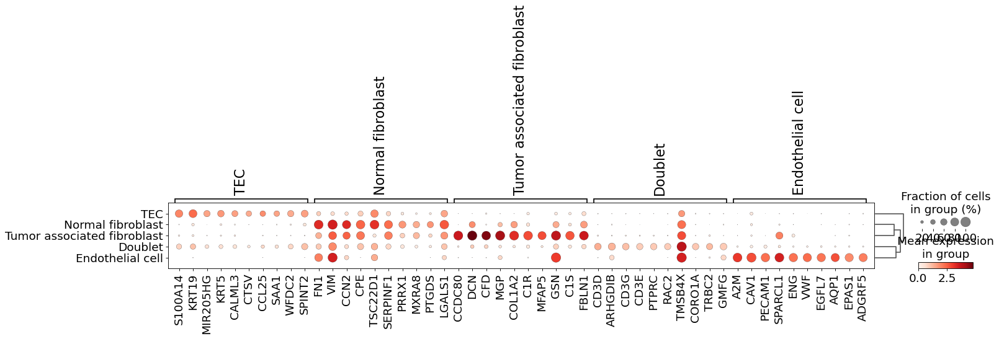

In [38]:
sc.pl.rank_genes_groups_dotplot(adata)

In [40]:
adata.write(results_file_stroma)

## select TEC

In [41]:
adata_raw = sc.read(results_raw_file_master)

adata_cp = adata_raw[adata[adata.obs['Stromal_cluster']=='TEC'].obs.index].copy()
    
adata = adata_cp.copy()
adata_cp = None

sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
adata.raw = sc.pp.log1p(adata, copy=True)

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [42]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

extracting highly variable genes
    finished (0:00:00)


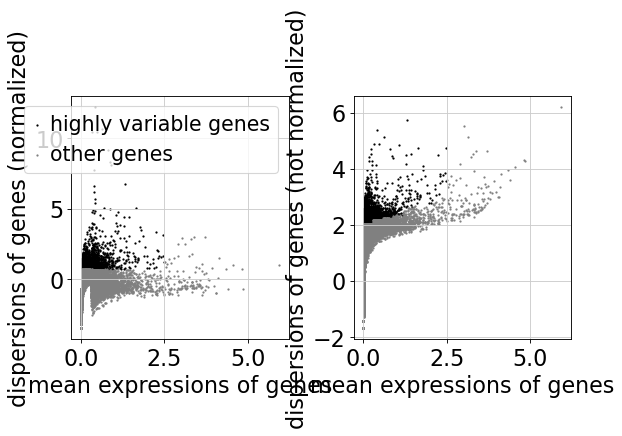

[4065, 36601]


In [43]:
filter_result = sc.pp.filter_genes_dispersion(
    adata.X, min_mean=0.0125, max_mean=2.5, min_disp=0.7)
sc.pl.filter_genes_dispersion(filter_result)
print([sum([i[0] for i in filter_result]),len(filter_result)])

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:375: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=50
    finished (0:00:00)


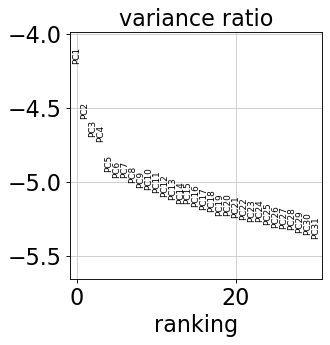

In [44]:
adata = adata[:, filter_result.gene_subset]
sc.pp.log1p(adata)
sc.pp.scale(adata, max_value=10)
sc.tl.pca(adata)
adata.obsm['X_pca'] *= -1  # multiply by -1 to match Seurat
sc.pl.pca_variance_ratio(adata, log=True)

In [45]:
sc.external.pp.bbknn(adata, batch_key='sample', n_pcs=10)
sc.tl.umap(adata, spread=2)
sc.tl.leiden(adata, resolution=1)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)
running Leiden clustering
    finished: found 7 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


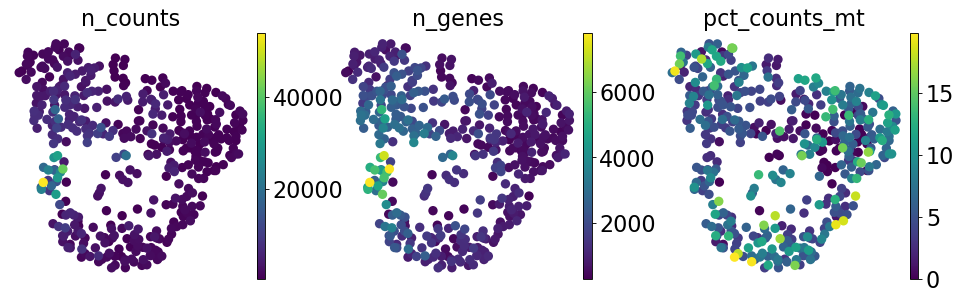

In [46]:
sc.pl.umap(adata, color=['n_counts', 'n_genes', 'pct_counts_mt'], save='qc')

In [47]:
sc.tl.leiden(adata, resolution=1)
# sc.tl.leiden(adata, resolution=0.7, restrict_to=('leiden', ['1']))

running Leiden clustering
    finished: found 7 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


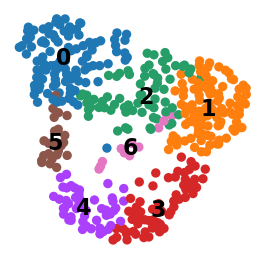

In [48]:
sc.pl.umap(adata, color='leiden', legend_loc='on data', title='', frameon=False, save='TEC_leiden.pdf')

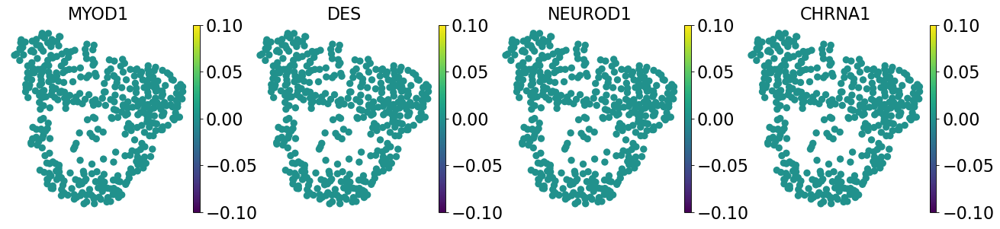

In [52]:
sc.pl.umap(adata, color=['MYOD1', 'DES', 'NEUROD1', 'CHRNA1'], save=False)

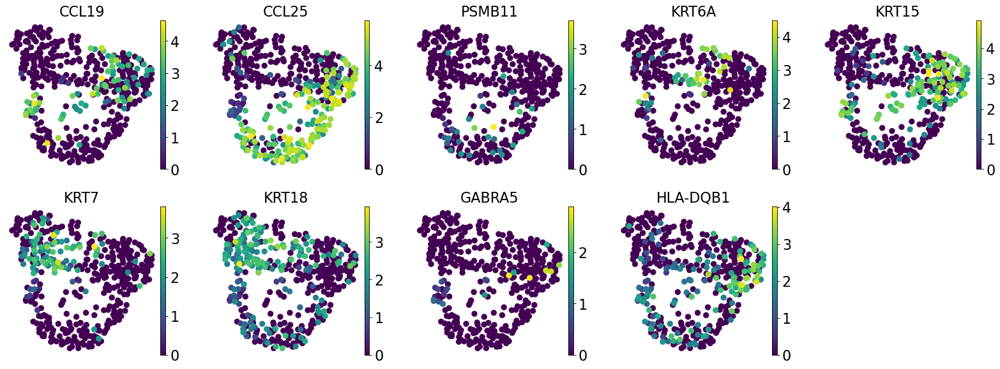

In [159]:
# no expression of MYOD1 and DES
list_panel_small = ['CCL19', 'CCL25', 'PSMB11', 'KRT6A', 'KRT15', 'KRT7', 'KRT18', 'GABRA5', 'HLA-DQB1']
sc.pl.umap(adata, color=list_panel_small,# 'KRT8'],
          save='panel_small', ncols=5)

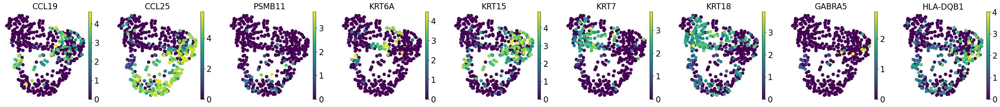

In [157]:
# no expression of MYOD1 and DES
list_panel_small = ['CCL19', 'CCL25', 'PSMB11', 'KRT6A', 'KRT15', 'KRT7', 'KRT18', 'GABRA5', 'HLA-DQB1']
sc.pl.umap(adata, color=list_panel_small,# 'KRT8'],
          save='panel_small2', ncols=10)

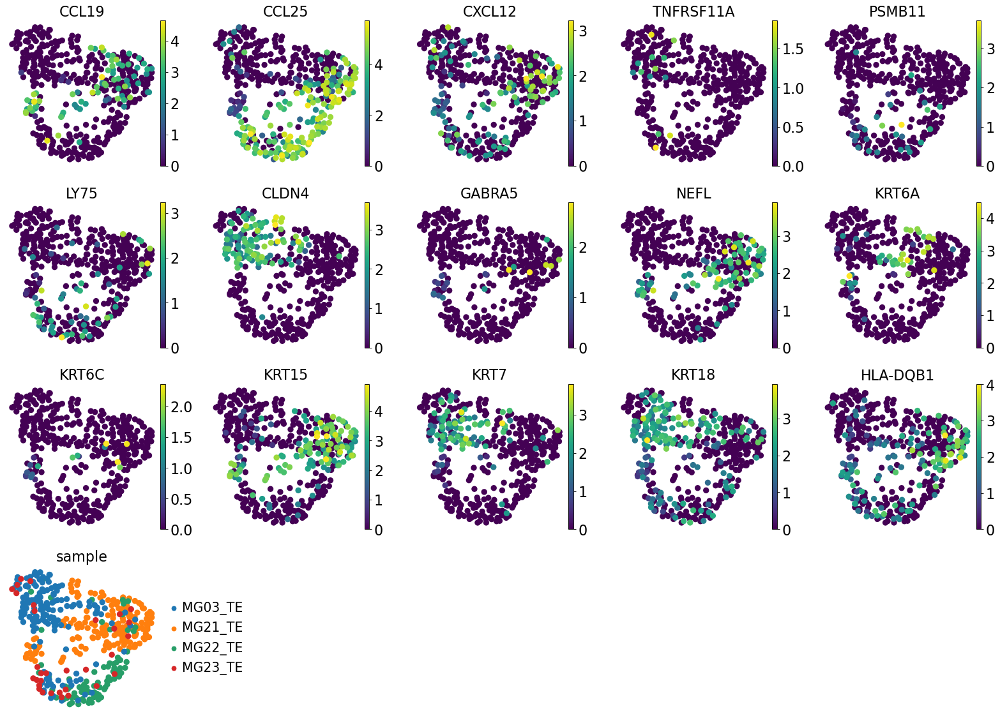

In [54]:
# no expression of MYOD1 and DES
list_panel = ['CCL19', 'CCL25', 'CXCL12', 'TNFRSF11A', 'PSMB11', 'LY75', 'CLDN4',
                         'GABRA5', 'NEFL', 'KRT6A', "KRT6C", 'KRT15', 'KRT7', 'KRT18', 'HLA-DQB1']
sc.pl.umap(adata, color=list_panel + ['sample'],# 'KRT8'],
          save='panel2', ncols=5)

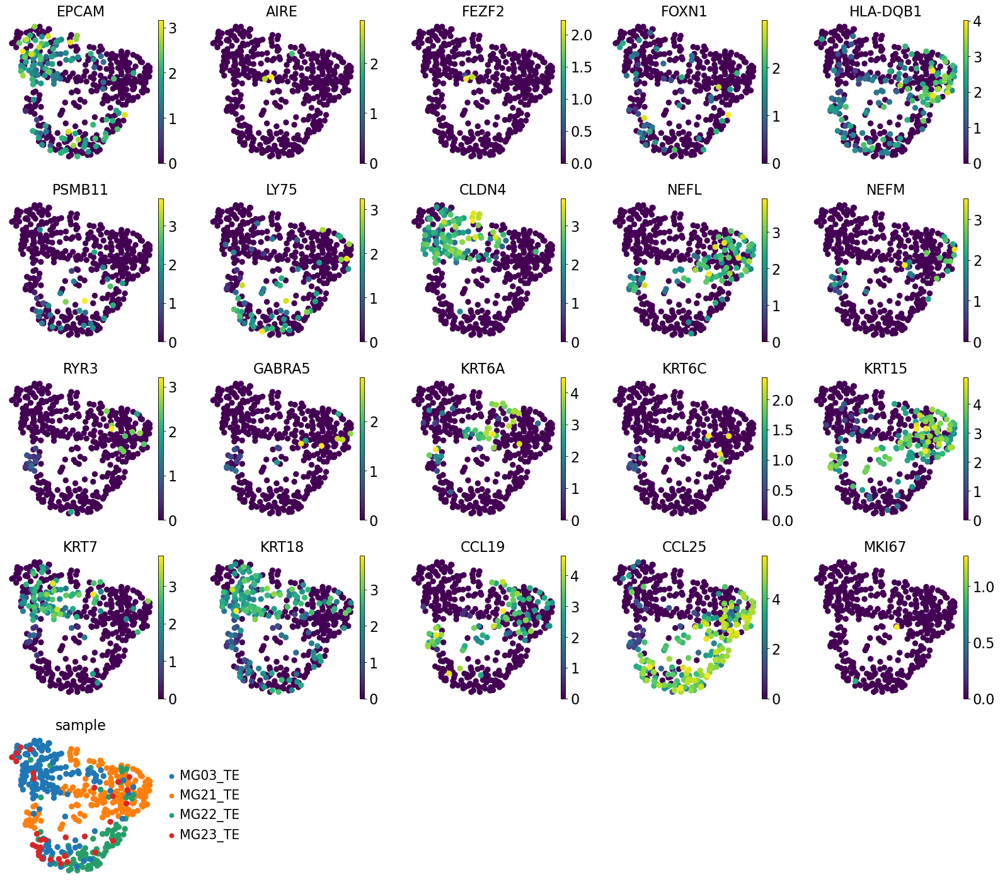

In [160]:
# no expression of MYOD1 and DES
list_panel = ['EPCAM', 'AIRE', 'FEZF2', 'FOXN1', 'HLA-DQB1', 'PSMB11', 'LY75', 'CLDN4',
                         'NEFL', 'NEFM', 'RYR3', 'GABRA5',
                         'KRT6A', "KRT6C", 'KRT15', 'KRT7', 'KRT18', 'CCL19', 'CCL25', 'MKI67']
sc.pl.umap(adata, color=list_panel + ['sample'],# 'KRT8'],
          save='panel2', ncols=5)

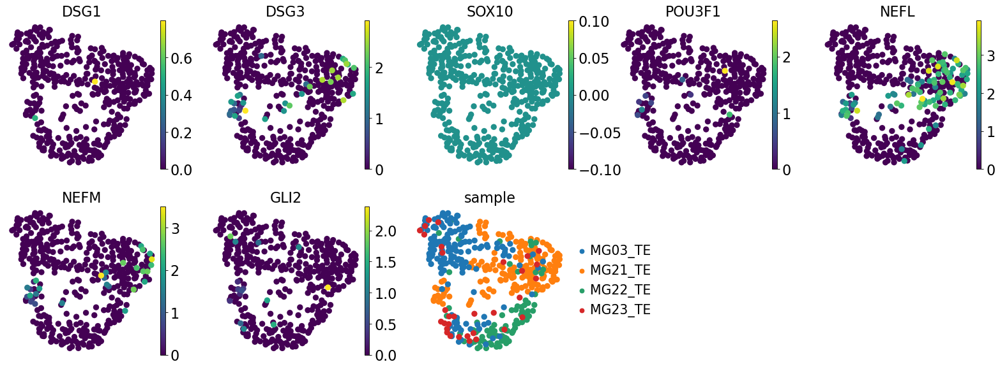

In [164]:
# no expression of MYOD1 and DES
list_panel = ['DSG1', 'DSG3', 'SOX10', 'POU3F1', 'NEFL', 'NEFM', 'GLI2']
sc.pl.umap(adata, color=list_panel + ['sample'],# 'KRT8'],
          save=False, ncols=5)

In [59]:
adata.obs

,sample,sample_type,site,fraction,n_genes,individual,n_counts,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden
AAACGAAGTCACCGCA,MG21_TE,TE,Thymus,Stroma,1084,MG21_TE,1989.0,1084,10000.000000,80.442436,0.804424,2
AACACACGTCGAGTTT,MG21_TE,TE,Thymus,Stroma,1462,MG21_TE,5008.0,1462,10000.000000,15.974441,0.159744,2
AACGAAAAGGCTAGCA,MG21_TE,TE,Thymus,Stroma,966,MG21_TE,2077.0,966,10000.000000,1049.590820,10.495909,1
AACGAAACACATACGT,MG21_TE,TE,Thymus,Stroma,1462,MG21_TE,3309.0,1462,10000.000000,831.066711,8.310667,6
AACGTCAGTATTGACC,MG21_TE,TE,Thymus,Stroma,1541,MG21_TE,4597.0,1541,10000.000977,0.000000,0.000000,2
...,...,...,...,...,...,...,...,...,...,...,...,...
TCAGTGATCACATCAG,MG23_TE,TE,Thymus,Stroma,338,MG23_TE,608.0,338,10000.000000,49.342106,0.493421,1
TCATTGTGTCGAGTTT,MG23_TE,TE,Thymus,Stroma,886,MG23_TE,1634.0,886,10000.000977,1731.946167,17.319460,0
TGGTACATCCTCAGAA,MG23_TE,TE,Thymus,Stroma,5247,MG23_TE,18240.0,5247,9999.999023,275.219299,2.752193,0
TTGCCTGAGAAGCTCG,MG23_TE,TE,Thymus,Stroma,691,MG23_TE,1005.0,691,10000.000977,378.109467,3.781094,0


ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


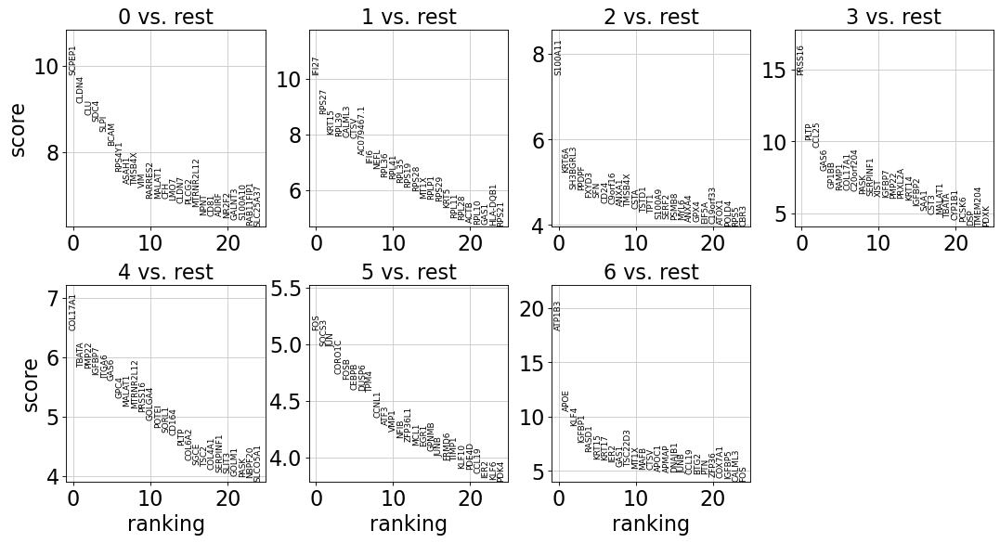

In [60]:
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test_overestim_var')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [61]:
print('\n'.join(list(adata.uns['rank_genes_groups']['names']['2'])[:100]))

S100A11
KRT6A
SH3BGRL3
PPDPF
FXYD3
SFN
CD24
C9orf16
ANXA1
TMSB4X
CSTA
TSTD1
TPT1
S100A9
SERF2
PSMB8
MYL6
ANXA4
GPX4
EIF5A
C19orf33
ATOX1
POLD4
RPS5
CBR3
HEBP2
CFL1
ACTB
KRT19
CALML5
RPLP0
KRT7
EEF1A1
SNCG
BLOC1S1
RPS26
RPL18A
GUK1
PLAC8
DSTN
SAT1
S100A8
MYL12B
HSPB1
CARHSP1
HLA-DPA1
GSTP1
RPS27
SMCO4
S100A10
SCP2
DBI
HMGN3
GPX2
RPS3A
RPS23
RALY
EEF1B2
DAPL1
HIGD1A
RPL21
COX8A
HLA-DPB1
NACA
TAF10
ACTG1
ADIRF
SRI
ATP5MD
PRR13
HINT1
ANXA2
H3F3A
TACSTD2
MYL12A
BRK1
TMEM258
SCAND1
TALDO1
RPL28
CITED4
GABARAP
TMEM219
RPS29
SSU72
CHCHD5
VAMP8
MAP1LC3A
MRPL33
PSMD8
COPE
CAPG
DYNLL1
NDUFB4
ISG15
AP2S1
ATP5F1E
ARPC3
FAU
NDUFB7


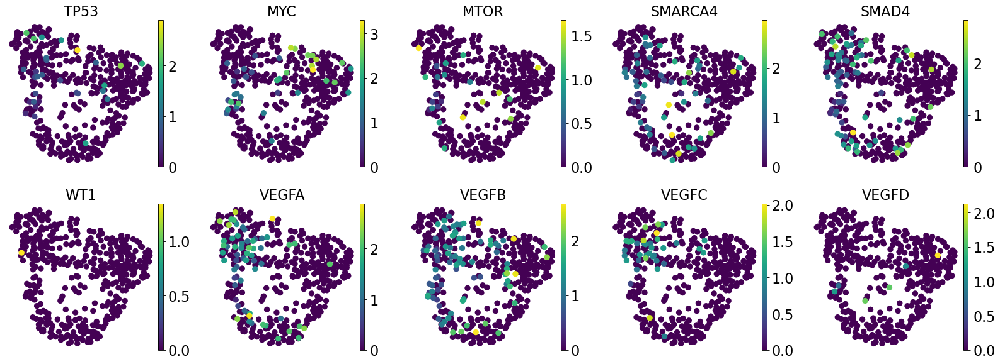

In [62]:
# no expression of MYOD1 and DES
sc.pl.umap(adata, color=['TP53', 'MYC', 'MTOR', 'SMARCA4', 'SMAD4', 'WT1', 'VEGFA', 
                         'VEGFB', 'VEGFC', 'VEGFD'],
          save=False, ncols=5)

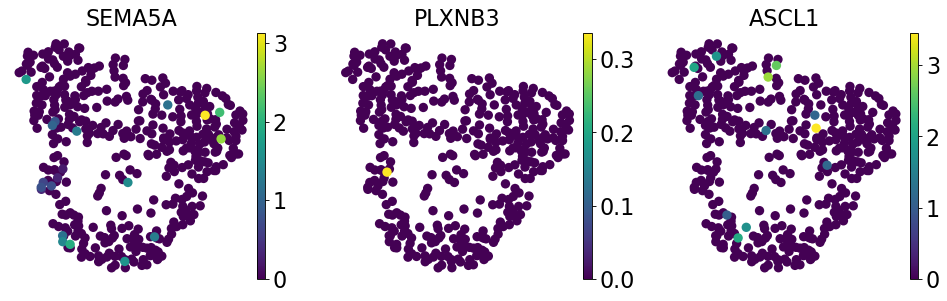

In [63]:
# no expression of MYOD1 and DES
sc.pl.umap(adata, color=['SEMA5A', 'PLXNB3', 'ASCL1'],
          save=False, ncols=5)

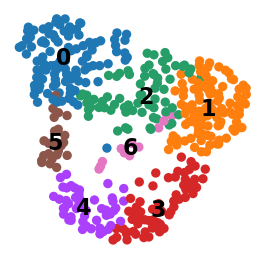

In [64]:
sc.pl.umap(adata, color='leiden', legend_loc='on data', title='', frameon=False, save='TEC_leiden.pdf')

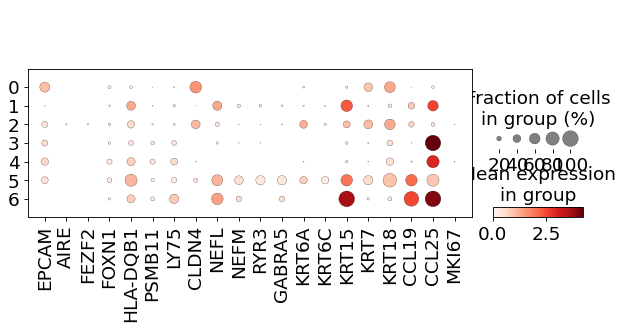

In [65]:
# no expression of MYOD1 and DES
sc.pl.dotplot(adata, list_panel,
          save='panel2', groupby='leiden')

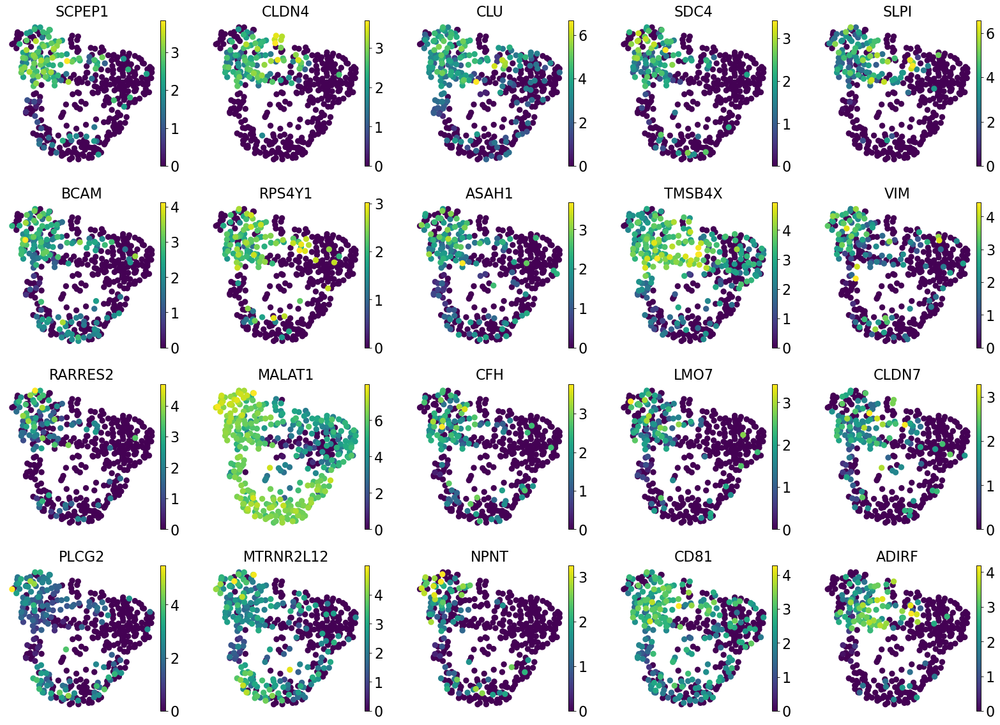

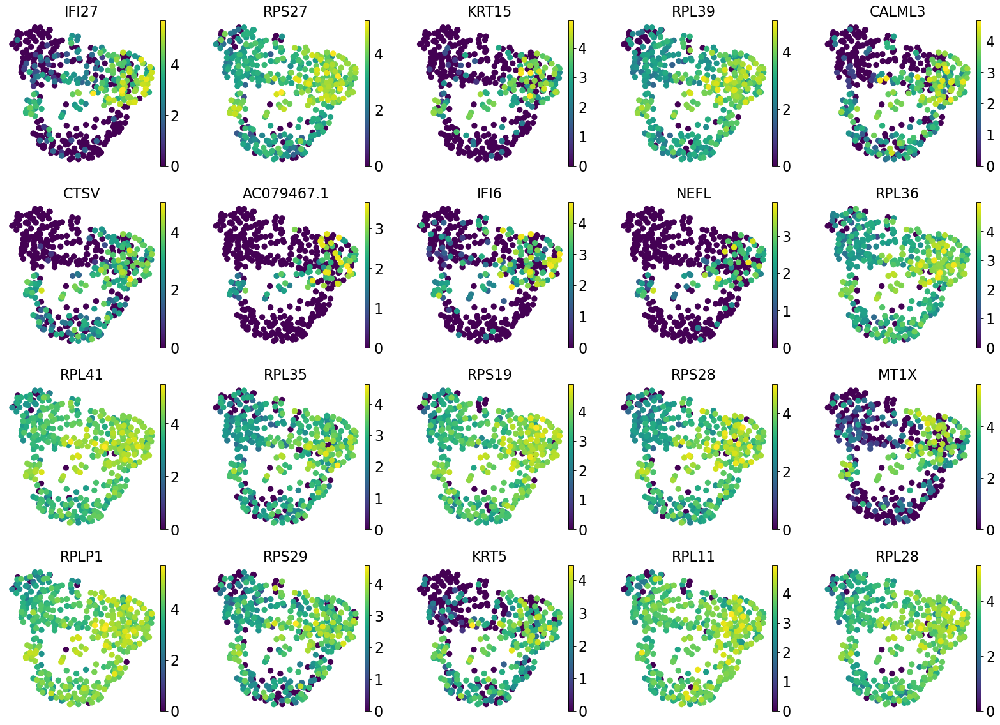

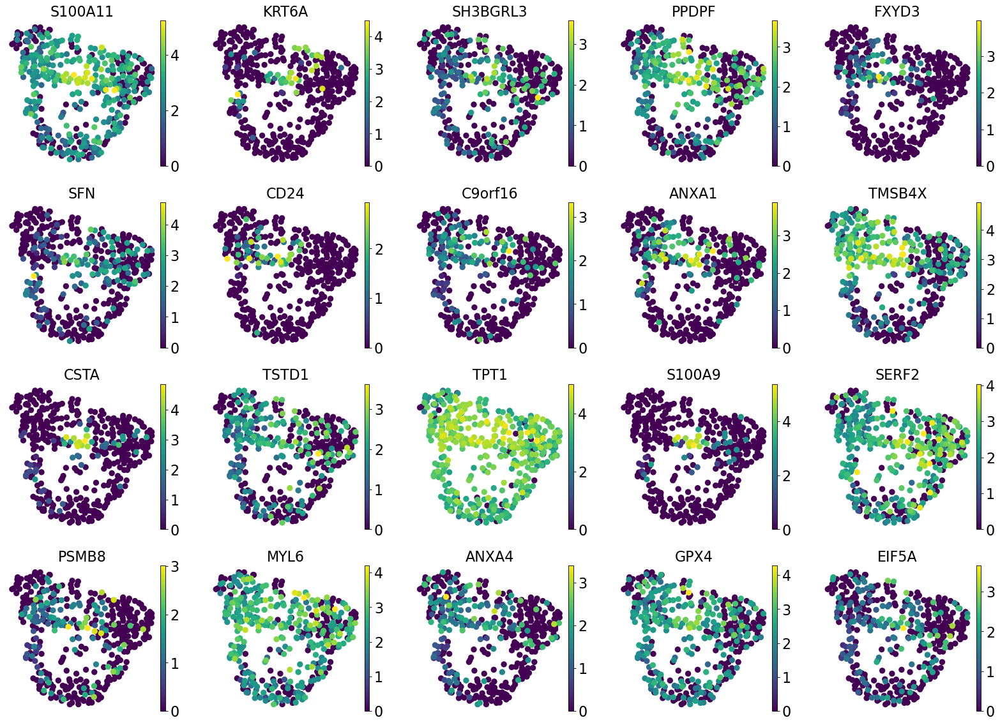

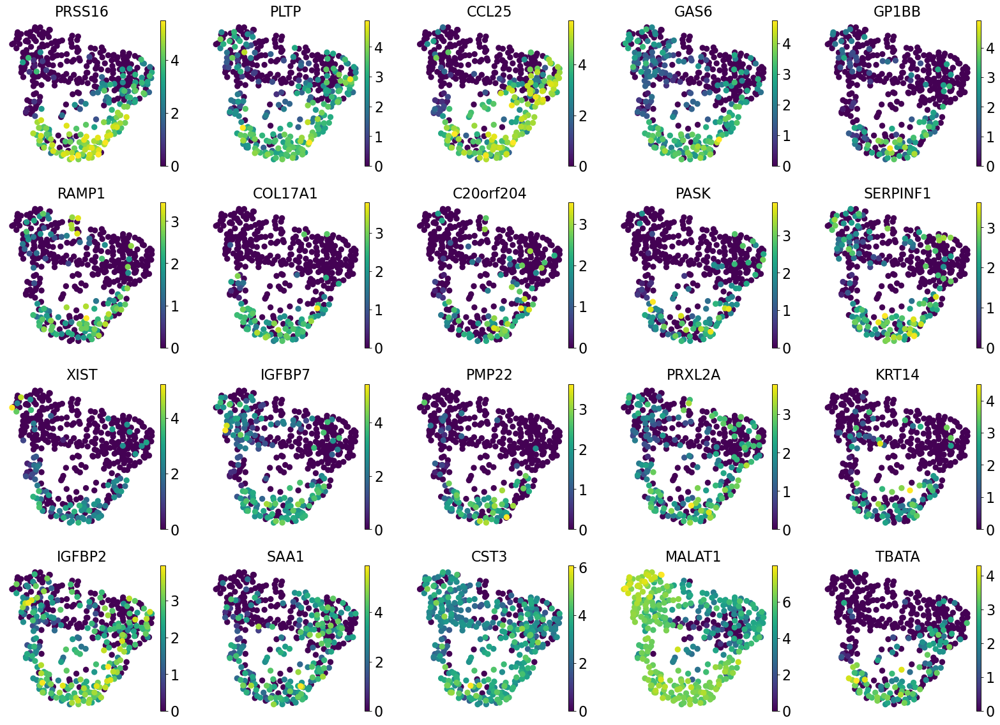

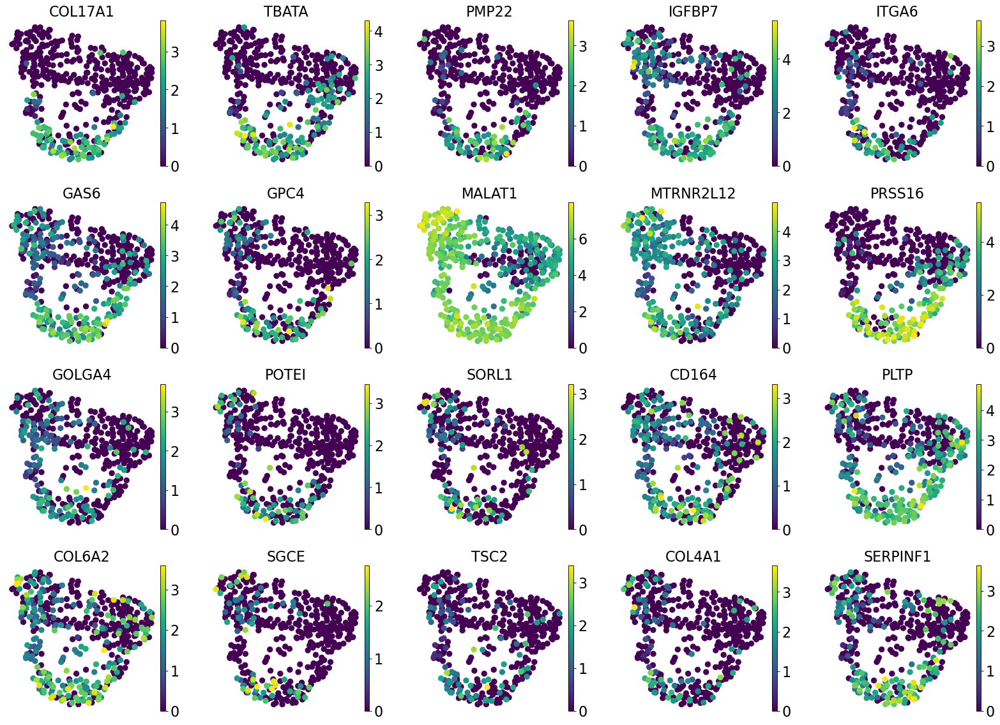

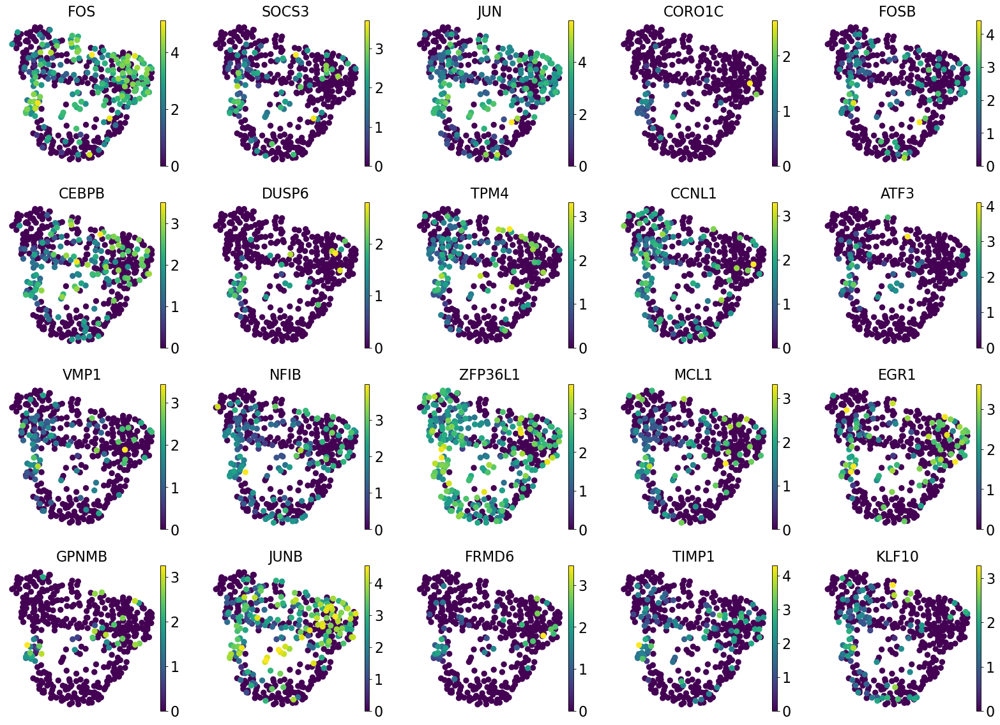

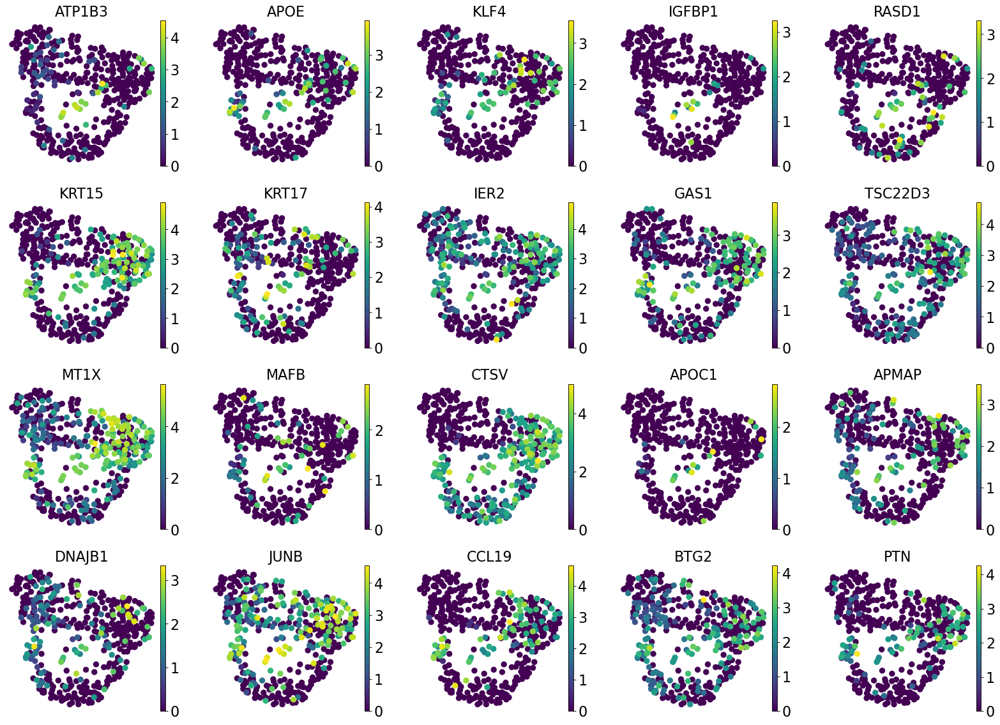

In [66]:
for c in adata.obs['leiden'].cat.categories:
    sc.pl.umap(adata, color=list(adata.uns['rank_genes_groups']['names'][c])[:20],
          save='TEC_leiden{}'.format(c), ncols=5)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


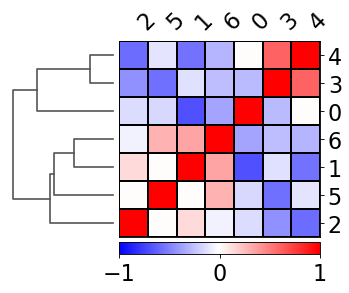

In [67]:
ax = sc.pl.correlation_matrix(adata, 'leiden', figsize=(5,3.5))

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


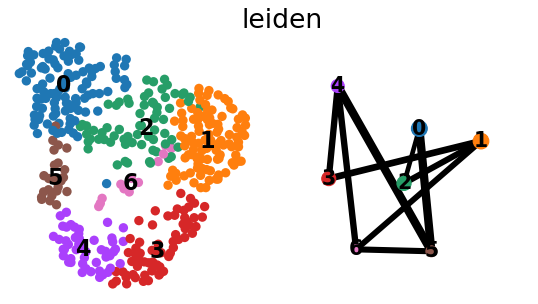

In [68]:
sc.tl.paga(adata, groups='leiden')
sc.pl.paga_compare(adata, threshold=0.5, basis='umap')

In [69]:
df_clusters =  pd.read_csv('210430_clusters/TEC_clusters.csv', index_col=0)
df_clusters.index = df_clusters.index.astype(str)
adata.obs['TEC_cluster'] = [df_clusters.loc[x, 'cluster'] for x in adata.obs['leiden']]
df_clusters

,cluster
leiden,
0,mTEC (II)
1,mTEC (I)
2,mTEC (I)
3,cTEC
4,cTEC
5,nmTEC
6,mTEC (I)


... storing 'TEC_cluster' as categorical


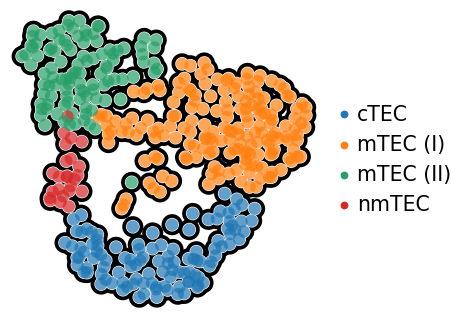

In [70]:
with plt.rc_context({"figure.figsize": (5, 5)}):
    sc.pl.umap(adata, color='TEC_cluster', add_outline=True,
           title='', frameon=False, save='TEC_cluster.pdf', s=500)

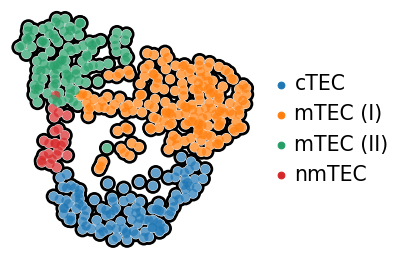

In [71]:
sc.pl.umap(adata, color='TEC_cluster', title='', add_outline=True, 
    frameon=False, save='TEC_cluster_out.pdf')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


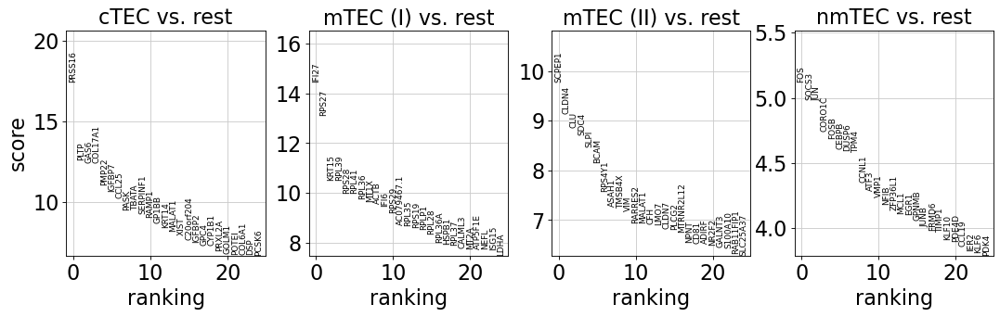

In [72]:
sc.tl.rank_genes_groups(adata, 'TEC_cluster', method='t-test_overestim_var')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_TEC_cluster']`


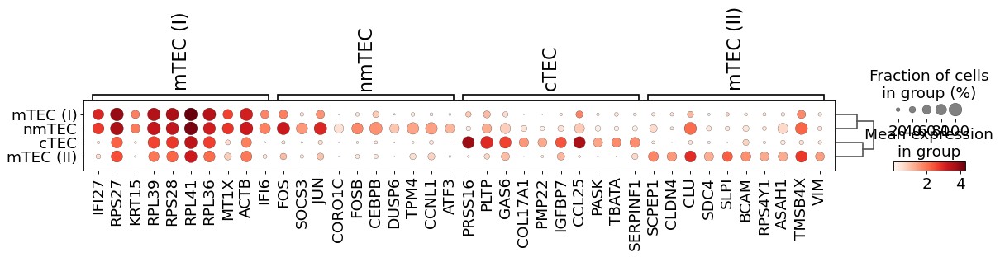

In [73]:
sc.pl.rank_genes_groups_dotplot(adata, n_genes=10, groupby='TEC_cluster', save='TEC.pdf')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


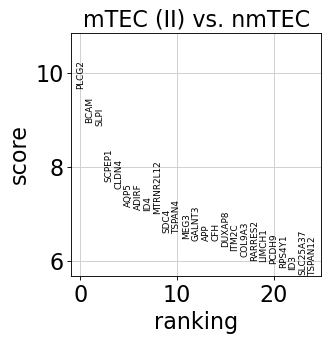

In [74]:
sc.tl.rank_genes_groups(adata, 'TEC_cluster', method='t-test_overestim_var', reference='nmTEC', 
                        groups=['mTEC (II)'])
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

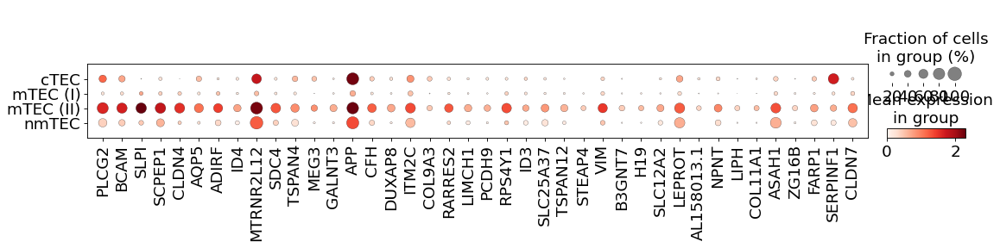

In [75]:
sc.pl.dotplot(adata, list(adata.uns['rank_genes_groups']['names']['mTEC (II)'])[:40], groupby='TEC_cluster')

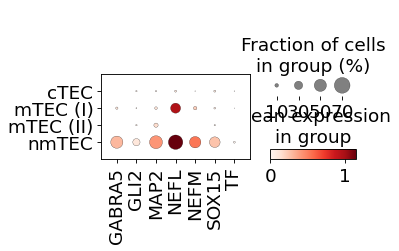

In [76]:
list_ihc = ['GABRA5', 'GLI2', 'MAP2', 'NEFL', 'NEFM', 'SOX15', 'TF']
sc.pl.dotplot(adata, list_ihc, groupby='TEC_cluster', save='ihc.pdf')

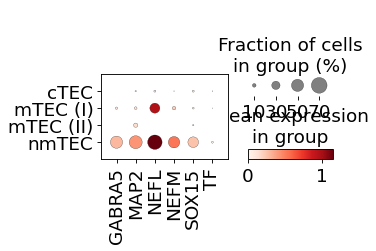

In [6]:
list_ihc = ['GABRA5', 'MAP2', 'NEFL', 'NEFM', 'SOX15', 'TF']
sc.pl.dotplot(adata, list_ihc, groupby='TEC_cluster', save='ihc2.pdf')

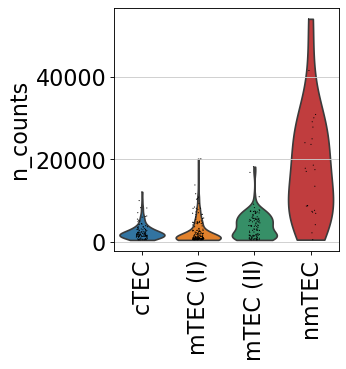

In [78]:
sc.pl.violin(adata, 'n_counts', groupby='TEC_cluster', rotation=90, save='ncounts')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


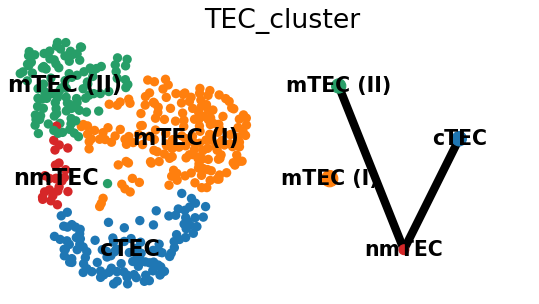

In [79]:
sc.tl.paga(adata, groups='TEC_cluster')
sc.pl.paga_compare(adata, threshold=0.4, basis='umap', save='TEC_cluster')

--> added 'pos', the PAGA positions (adata.uns['paga'])


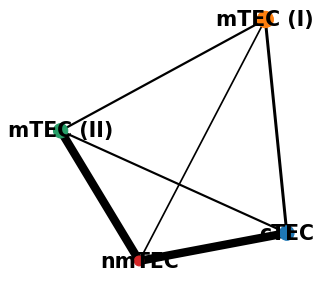

In [80]:
sc.pl.paga(adata)

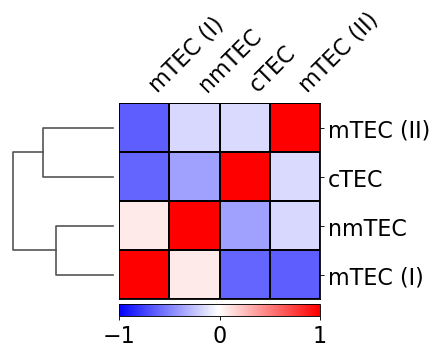

In [81]:
ax = sc.pl.correlation_matrix(adata, 'TEC_cluster', figsize=(5,3.5), save='TEC_cluster')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


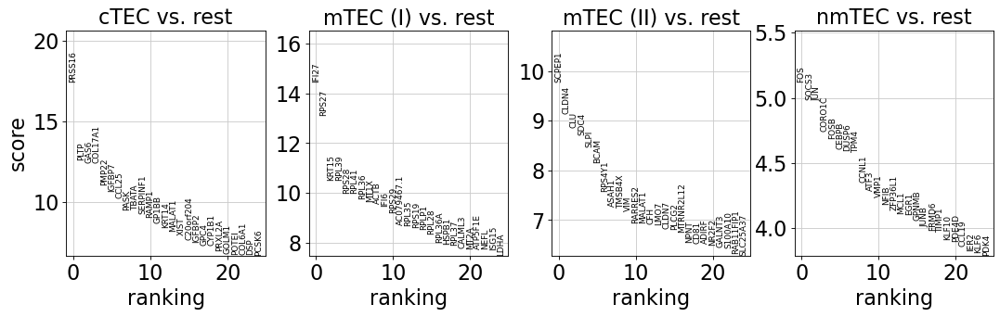

In [82]:
sc.tl.rank_genes_groups(adata, 'TEC_cluster', method='t-test_overestim_var')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [83]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
df_res = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj']})
df_res.head()

,cTEC_n,cTEC_p,mTEC (I)_n,mTEC (I)_p,mTEC (II)_n,mTEC (II)_p,nmTEC_n,nmTEC_p
0,PRSS16,5.150040e-38,IFI27,3.358034e-32,SCPEP1,1.791017e-14,FOS,0.141165
1,PLTP,2.961555e-23,RPS27,2.885894e-27,CLDN4,6.885922e-13,SOCS3,0.141165
2,GAS6,3.947674e-23,KRT15,2.852305e-18,CLU,1.775486e-12,JUN,0.141165
3,COL17A1,3.587820e-20,RPL39,8.155653e-19,SDC4,1.407432e-11,CORO1C,0.209240
4,PMP22,1.301602e-16,RPS28,2.651627e-17,SLPI,2.141656e-11,FOSB,0.209240


In [84]:
df_res[df_res['nmTEC_p'] < 0.05]['nmTEC_n']

Series([], Name: nmTEC_n, dtype: object)

In [85]:
# print('\n'.join(list(df_res[df_res['nmTEC_p'] < 0.05]['nmTEC_n'])))

In [86]:
print('\n'.join(list(adata.uns['rank_genes_groups']['names']['nmTEC'])[:100]))

FOS
SOCS3
JUN
CORO1C
FOSB
CEBPB
DUSP6
TPM4
CCNL1
ATF3
VMP1
NFIB
ZFP36L1
MCL1
EGR1
GPNMB
JUNB
FRMD6
TIMP1
KLF10
PDE4D
CCL19
IER2
KLF6
PDK4
GAS1
MTSS1
DUSP1
NFIC
INTS6
HSP90AA1
HSPB1
UBC
SUSD6
IFI16
GADD45A
AL035425.3
DPYS
NDRG1
AKT3
LMNA
MAFF
RHOB
ZFP36
SGIP1
PALLD
ERRFI1
IMPAD1
COL7A1
PVT1
ARF1
ATP1B1
GADD45B
HIF1A
SULF2
TCEAL9
SLC22A4
MAPK6
JUND
ZNF106
C2CD4B
DNAJB1
DSG3
AL035425.1
IER5
BTG1
DSC2
B3GNT5
BNC2
PTN
NFKBIZ
LEO1
PHLDB2
ARF6
UBE3A
CNN2
TIPARP
APOE
ADRB2
KLF9
POLR2J3
SYBU
GBP1
AC055874.1
LIMA1
PRRC2C
TAGLN2
PIK3R1
HSPA2
NBL1
PNRC1
EPC1
MIDN
H2AFZ
DDX3X
SVIL
VAMP3
TOB2
ARL4A
RO60


In [87]:
adata.obs['TEC_cluster']

AAACGAAGTCACCGCA     mTEC (I)
AACACACGTCGAGTTT     mTEC (I)
AACGAAAAGGCTAGCA     mTEC (I)
AACGAAACACATACGT     mTEC (I)
AACGTCAGTATTGACC     mTEC (I)
                      ...    
TCAGTGATCACATCAG     mTEC (I)
TCATTGTGTCGAGTTT    mTEC (II)
TGGTACATCCTCAGAA    mTEC (II)
TTGCCTGAGAAGCTCG    mTEC (II)
TTGTTCAAGAGGCTGT         cTEC
Name: TEC_cluster, Length: 422, dtype: category
Categories (4, object): ['cTEC', 'mTEC (I)', 'mTEC (II)', 'nmTEC']

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


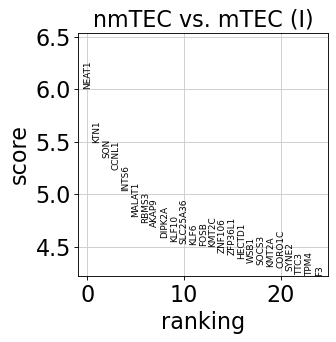

In [88]:
sc.tl.rank_genes_groups(adata, 'TEC_cluster', method='t-test_overestim_var', 
                        reference='mTEC (I)', groups=['nmTEC'],
                        rankby_abs=False)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, save='nmTEC_mTEC1')

In [89]:
print('\n'.join(list(adata.uns['rank_genes_groups']['names']['nmTEC'])[:100]))

NEAT1
KTN1
SON
CCNL1
INTS6
MALAT1
RBMS3
AKAP9
DIPK2A
KLF10
SLC25A36
KLF6
FOSB
KMT2C
ZNF106
ZFP36L1
HECTD1
WSB1
SOCS3
KMT2A
CORO1C
SYNE2
TTC3
TPM4
F3
AKT3
LIFR
APLP2
UBE3A
SUSD6
IMPAD1
DUSP6
PARP14
PRRC2C
JPX
VEZT
PDE4D
DHX36
ATF3
LIMA1
MIR29B2CHG
MTDH
NRIP1
SRRM1
COPA
NDRG1
DST
VMP1
HSP90B1
TTBK2
CHD1
PSMA3-AS1
EPC1
STAT3
SARAF
GALNT18
SVIL
BIRC6
ETS2
KIAA2026
PAWR
TPR
PLEC
TMEM69
AFF4
ROCK1
ZBTB20
FAM210B
TBC1D13
SETX
PHLDB2
TAF15
PNRC1
DNAJC1
NRP1
GXYLT2
ZBTB44
JUN
LMNA
IRF2BP2
CALD1
HSP90AA1
MCL1
GLG1
NFKBIZ
TFDP2
BPTF
NPTN
BOD1L1
POLR2J3
SGPL1
DCAF5
PTPRF
NFIB
CLSTN1
GOLGB1
CREBBP
TRA2B
FOXP1
DSC2


In [90]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
df_res = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj', 'scores']})
df_res.head()

,nmTEC_n,nmTEC_p,nmTEC_s
0,NEAT1,0.010712,6.004928
1,KTN1,0.038093,5.486404
2,SON,0.038093,5.342071
3,CCNL1,0.038093,5.234482
4,INTS6,0.107483,5.031857


<AxesSubplot:>

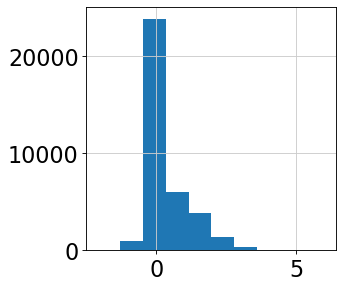

In [91]:
df_res['nmTEC_s'].hist()

In [92]:
df_res.loc[df_res['nmTEC_n'].isin(['NEFL', 'NEFM', 'GABRA5', 'MAP2', 'GLI2', 'CHRNA1', 'SOX15', 'OLIG1'])]

,nmTEC_n,nmTEC_p,nmTEC_s
1146,MAP2,0.917498,2.268338
2029,SOX15,1.000000,1.905965
3426,GABRA5,1.000000,1.559167
3437,NEFM,1.000000,1.554909
5288,GLI2,1.000000,1.229169
10772,NEFL,1.000000,0.533329
15695,CHRNA1,1.000000,0.000000
35197,OLIG1,1.000000,-0.365148


In [93]:
df_rank = pd.DataFrame(adata.uns['rank_genes_groups']['names']['nmTEC'], columns=['gene'])
df_rank['scores'] = adata.uns['rank_genes_groups']['scores']['nmTEC']
df_rank.head()
df_rank.to_csv(str(sc.settings.figdir) + '/nmTEC_mTEC1_rank.rnk', index=None, sep='\t')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


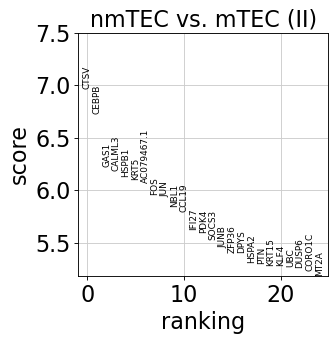

In [94]:
sc.tl.rank_genes_groups(adata, 'TEC_cluster', method='t-test_overestim_var', 
                        reference='mTEC (II)', groups=['nmTEC'],
                        rankby_abs=False)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, save='nmTEC_mTEC2')

In [95]:
print('\n'.join(list(adata.uns['rank_genes_groups']['names']['nmTEC'])[:100]))

CTSV
CEBPB
GAS1
CALML3
HSPB1
KRT5
AC079467.1
FOS
JUN
NBL1
CCL19
IFI27
PDK4
SOCS3
JUNB
ZFP36
DPYS
HSPA2
PTN
KRT15
KLF4
UBC
DUSP6
CORO1C
MT2A
CYCS
CHCHD10
MTSS1
BCL11A
DUSP1
CEBPD
FRMD6
PALLD
GPNMB
NEFL
FOSL2
ENPP3
NFIL3
IFI27L2
IFI16
EGR1
FOSB
GADD45A
APOE
JUND
RPS10
RPL36A
HLA-DQB1
ALDH1L1
SEC61G
SULF2
ACTB
HIF1A
MT1X
MTRNR2L1
NFIB
EEF1D
LGALS7B
COL7A1
PART1
IFI6
KHDRBS3
TIMP1
SAA1
RPL39
TGFBI
RYR3
SFN
RHOB
ATP1B1
IER2
TRIM69
DSG3
NFKBIA
ZBED2
GADD45B
ISG15
ATP6V1F
LDHA
PVT1
PIK3R1
VAV3
COX8A
AC093673.1
FBXO2
TP63
BTG2
PDE1A
NUPR1
ATF3
FKBP5
PDLIM1
C2CD4B
SLC6A1
PLPP3
ING2
MCL1
AL035425.3
ARL4A
MAPK6


In [96]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
df_res = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj', 'scores']})
df_res.head()

,nmTEC_n,nmTEC_p,nmTEC_s
0,CTSV,0.002403,6.967306
1,CEBPB,0.000874,6.723962
2,GAS1,0.003303,6.222758
3,CALML3,0.002403,6.180361
4,HSPB1,0.002403,6.128771


In [97]:
df_res.loc[df_res['nmTEC_n'].isin(['NEFL', 'NEFM', 'GABRA5', 'MAP2', 'GLI2', 'CHRNA1', 'SOX15', 'OLIG1'])]

,nmTEC_n,nmTEC_p,nmTEC_s
34,NEFL,0.041963,4.857145
102,GABRA5,0.138756,4.062633
183,NEFM,0.288082,3.527237
375,SOX15,0.567637,2.931721
1141,MAP2,1.000000,2.104635
4016,GLI2,1.000000,1.086642
14340,CHRNA1,1.000000,0.000000
29696,OLIG1,1.000000,0.000000


In [98]:
df_rank = pd.DataFrame(adata.uns['rank_genes_groups']['names']['nmTEC'], columns=['gene'])
df_rank['scores'] = adata.uns['rank_genes_groups']['scores']['nmTEC']
df_rank.head()
df_rank.to_csv(str(sc.settings.figdir) + '/nmTEC_mTEC2_rank.rnk', index=None, sep='\t')

In [99]:
gene = "GABRA5"
threshold = 1

adata.obs['bin_{}'.format(gene)] = (np.array(adata.raw[:,gene].X.todense()) > threshold).flatten()
df_cross = pd.crosstab(adata.obs['bin_{}'.format(gene)], adata.obs['TEC_cluster'])
df_cross /= df_cross.sum()
df_cross

TEC_cluster,cTEC,mTEC (I),mTEC (II),nmTEC
bin_GABRA5,,,,
False,1.0,0.955556,1.0,0.916667
True,0.0,0.044444,0.0,0.083333


In [100]:
df_cross.columns

CategoricalIndex(['cTEC', 'mTEC (I)', 'mTEC (II)', 'nmTEC'], categories=['cTEC', 'mTEC (I)', 'mTEC (II)', 'nmTEC'], ordered=False, name='TEC_cluster', dtype='category')

In [101]:
genes = ["GABRA5", 'NEFL', 'NEFM', 'SOX6', 'KRT6A', 'KRT15']
cols = ['cTEC', 'mTEC (I)', 'mTEC (II)', 'nmTEC']
threshold = 1

list_cross = []
for gene in genes:
    adata.obs['bin_{}'.format(gene)] = (np.array(adata.raw[:,gene].X.todense()) > threshold).flatten()
    df_cross = pd.crosstab(adata.obs['bin_{}'.format(gene)], adata.obs['TEC_cluster'])
    df_cross /= df_cross.sum()
    list_cross.append(list(df_cross.loc[True, cols]))

<AxesSubplot:>

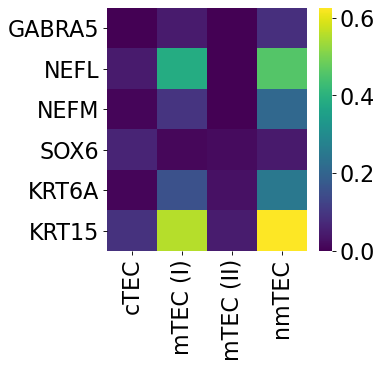

In [102]:
sns.heatmap(pd.DataFrame(list_cross, columns=cols, index=genes) ,cmap='viridis')

In [103]:
df_cross = pd.crosstab(adata.obs['bin_{}'.format(gene)], adata.obs['TEC_cluster'])

In [104]:
df_cross = pd.crosstab(adata.obs['bin_{}'.format(gene)], adata.obs['TEC_cluster'])
df_cross = df_cross[[x for x in df_cross.columns if x != 'nmTEC']].sum(axis=1)
df_cross.loc[True] / df_cross.loc[False]
# df_cross /= df_cross.sum()

0.40636042402826855

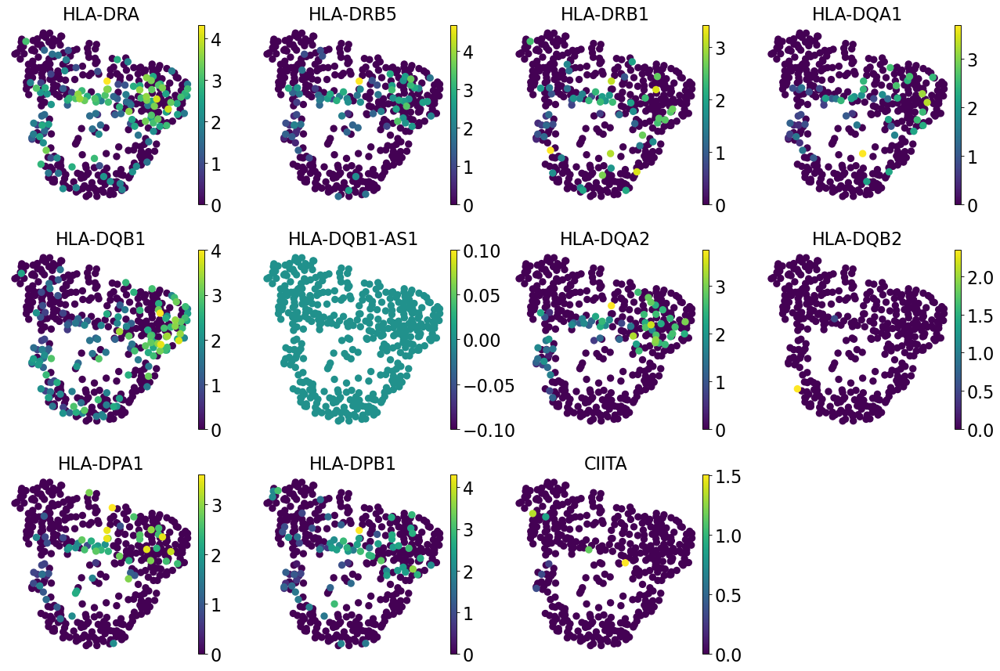

In [105]:
sc.pl.umap(adata, 
           color=[x for x in adata.raw.var.index 
                  if ('HLA-DP' in x) or ('HLA-DQ' in x) or ('HLA-DR' in x)] + ['CIITA'], 
           save='HLA.ciia.pdf')

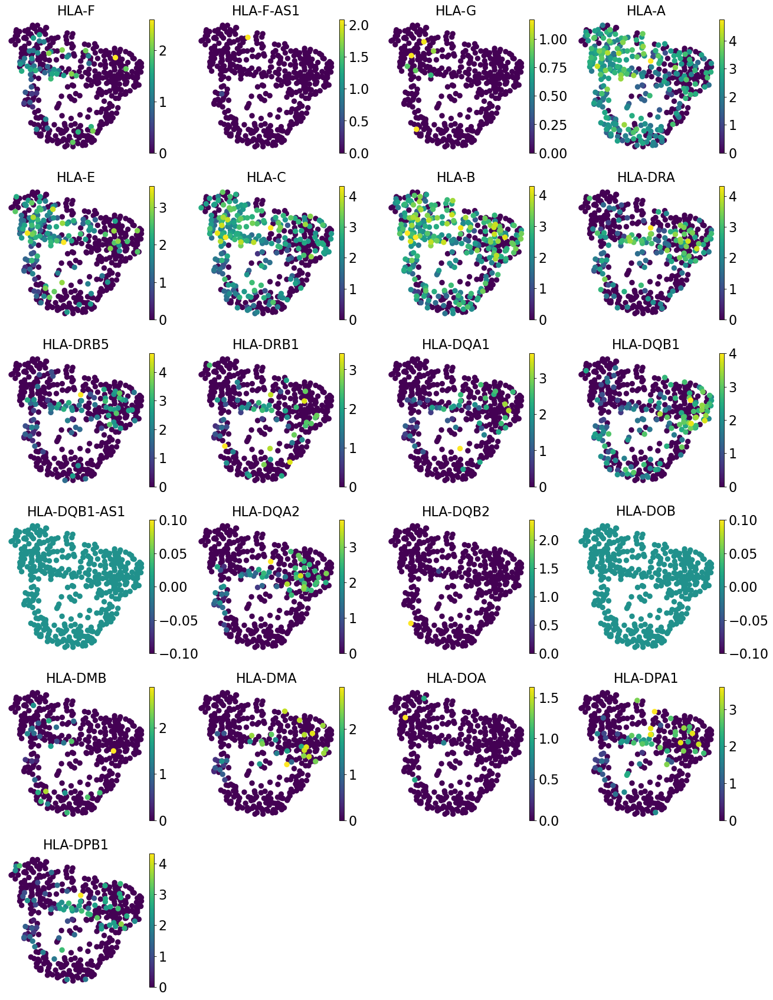

In [106]:
sc.pl.umap(adata, color=[x for x in adata.raw.var.index if x.startswith("HLA")], save="HLA")

In [ ]:
sc.pl.umap(adata, color=[x for x in adata.raw.var.index if x.startswith("HLA")], save="HLA")

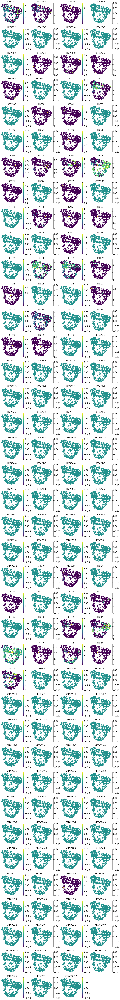

In [107]:
sc.pl.umap(adata, color=[x for x in adata.raw.var.index if x.startswith("KRT")], save="KRT")

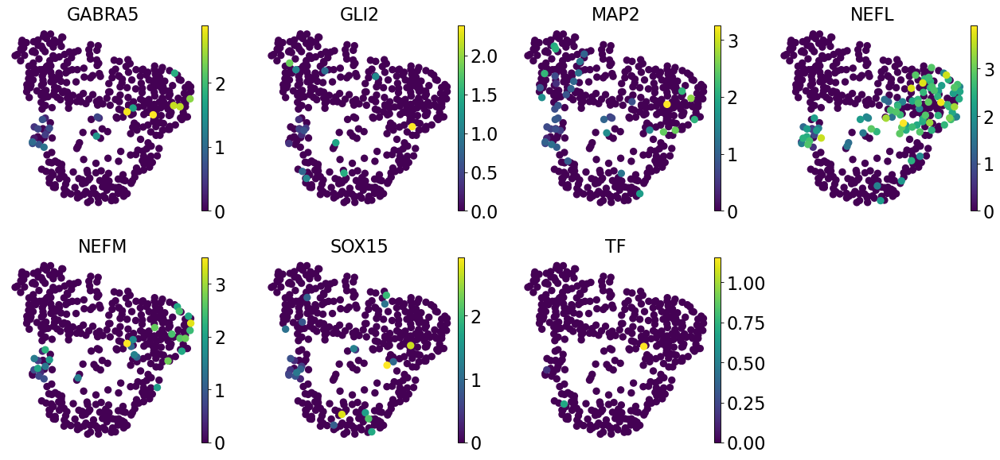

In [108]:
sc.pl.umap(adata, 
           color=['GABRA5', 'GLI2', 'MAP2', 'NEFL', 'NEFM', 'SOX15', 'TF'], 
           save=False)

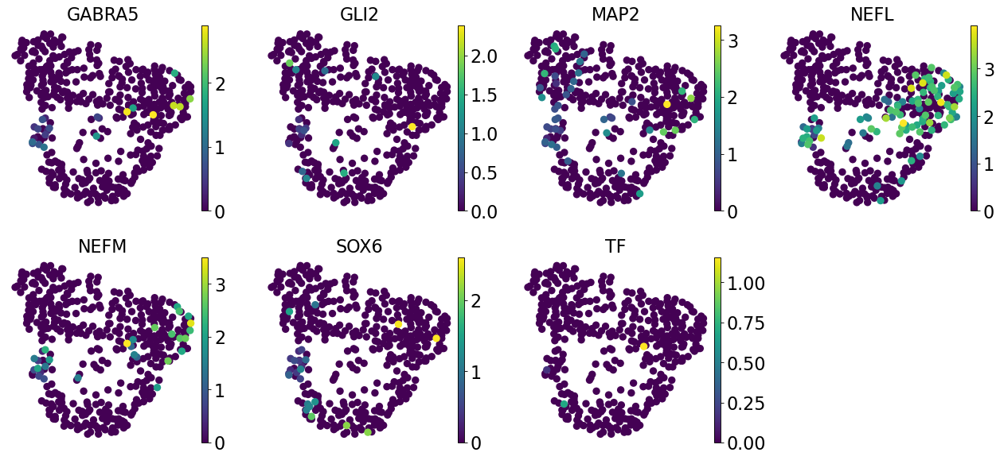

In [109]:
sc.pl.umap(adata, 
           color=['GABRA5', 'GLI2', 'MAP2', 'NEFL', 'NEFM', 'SOX6', 'TF'], 
           save=False)

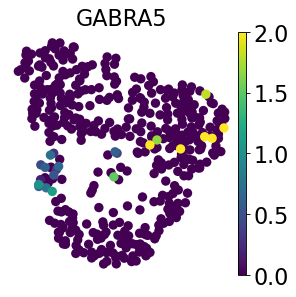

In [11]:
sc.pl.umap(adata, color=['GABRA5'],
          ncols=5, vmax=2, save='gabra5')

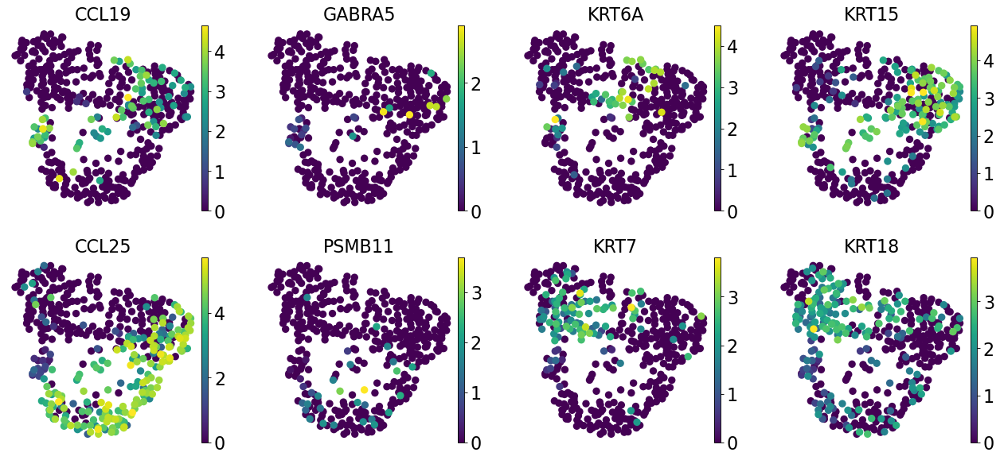

In [14]:
sc.pl.umap(adata, color=['CCL19', 'GABRA5', 'KRT6A', 'KRT15', 
                         'CCL25', 'PSMB11', 'KRT7', 'KRT18'],
          ncols=4, save='fig3c')

In [134]:
list_kegg_cancer = list(pd.read_csv('data/KEGG_PATHWAYS_IN_CANCER.txt', skiprows=2, header=None)[0])

In [135]:
# https://www.genome.jp/entry/pathway+hsa05200
sc.tl.score_genes(adata, list_kegg_cancer, use_raw=True, score_name="score_cancer")

computing score 'score_cancer'
    finished: added
    'score_cancer', score of gene set (adata.obs).
    686 total control genes are used. (0:00:00)


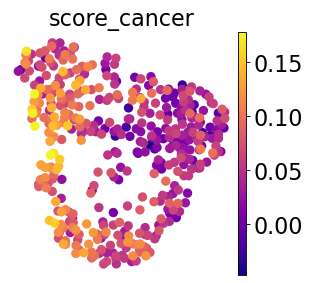

In [136]:
sc.pl.umap(adata, color=['score_cancer'], cmap='plasma', save='kegg_cancer')

In [137]:
adata.obs['TEC_cluster'].value_counts()

mTEC (I)     180
cTEC         112
mTEC (II)    106
nmTEC         24
Name: TEC_cluster, dtype: int64

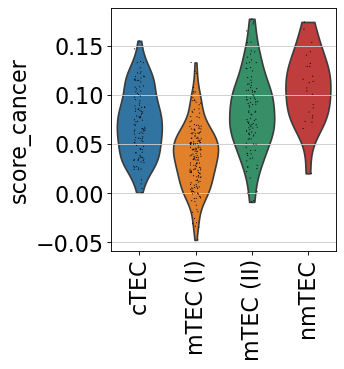

In [114]:
sc.pl.violin(adata, ['score_cancer'], groupby='TEC_cluster', log=False,
             rotation=90, save='cancer.pdf')

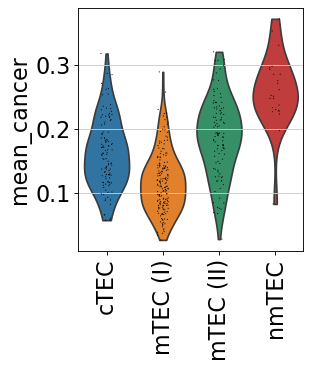

In [195]:
adata.obs['mean_cancer'] = np.array(adata.raw[:,adata.raw.var.index.isin(list_kegg_cancer)].X.mean(axis=1)).flatten()
sc.pl.violin(adata, ['mean_cancer'], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/cancer_mean.pdf'.format(id_gs))

In [115]:
list_label = ['cTEC', 'mTEC (I)', 'mTEC (II)', 'nmTEC']
df_marker = pd.read_csv('./210430_clusters/markergenes_manual.csv', index_col=0)
df_marker = df_marker.loc[list_label]

dict_markers = {pos:[row[0], row[1], row[2], row[3], row[4]] for pos,row in df_marker.iterrows()}

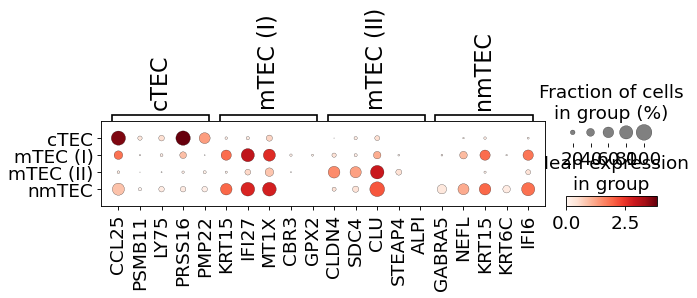

In [116]:
sc.pl.dotplot(adata, dict_markers, 'TEC_cluster', categories_order=list_label, dendrogram=False, save='minor_manual_5')

In [118]:
adata.write(results_file_TEC)

## summarize clusters

In [119]:
adata_stroma = sc.read(results_file_stroma)
adata_tec = sc.read(results_file_TEC)

In [120]:
df_cluster = adata_stroma.obs[['Stromal_cluster']]
df_cluster.columns = ['minor_cluster']
df_cluster['minor_cluster'] = df_cluster['minor_cluster'].astype(str)
df_cluster.head()

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,minor_cluster
AAACGAAGTCACCGCA,TEC
AAAGGGCGTCGACGCT,Doublet
AAAGTGAGTACCATAC,Doublet
AACACACGTAGTATAG,Endothelial cell
AACACACGTCGAGTTT,TEC


In [121]:
df_cluster_tec = adata_tec.obs[['TEC_cluster']]
df_cluster_tec.columns = ['minor_cluster']
df_cluster_tec['minor_cluster'] = df_cluster_tec['minor_cluster'].astype(str)
df_cluster_tec.head()

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,minor_cluster
AAACGAAGTCACCGCA,mTEC (I)
AACACACGTCGAGTTT,mTEC (I)
AACGAAAAGGCTAGCA,mTEC (I)
AACGAAACACATACGT,mTEC (I)
AACGTCAGTATTGACC,mTEC (I)


In [122]:
df_cluster.loc[df_cluster_tec.index, 'minor_cluster'] = list(df_cluster_tec['minor_cluster'])
adata_stroma.obs['minor_cluster'] = list(df_cluster['minor_cluster'])

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)


... storing 'minor_cluster' as categorical


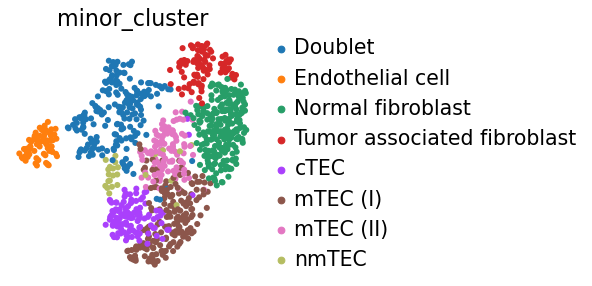

In [123]:
sc.pl.umap(adata_stroma, 
           color=['minor_cluster'], 
           save='minor_cluster')

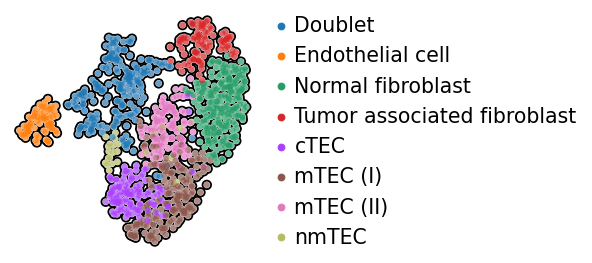

In [124]:
sc.pl.umap(adata_stroma, color='minor_cluster', title='', add_outline=True, 
           frameon=False, save='minor_cluster_out.pdf')

In [125]:
adata_stroma.write(results_file_stroma_minor_cluster)

In [127]:
adata = sc.read(results_file_stroma_minor_cluster)
adata_raw = sc.read(results_raw_file_master)

adata_cg = adata_raw[adata.obs.index].copy()
adata_cg.obs = adata.obs
adata_cg.obsm = adata.obsm
adata_cg.uns = adata.uns

sc.pp.log1p(adata_cg)
sc.pp.normalize_per_cell(adata_cg, counts_per_cell_after=1e4)

adata_cg.write(results_file_cg_stroma_minor_cluster)

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


## dotplot

In [128]:
adata = sc.read(results_file_stroma_minor_cluster)

In [129]:
adata

AnnData object with n_obs × n_vars = 1000 × 4087
    obs: 'sample', 'sample_type', 'site', 'fraction', 'n_genes', 'individual', 'n_counts', 'leiden', 'Stromal_cluster', 'minor_cluster'
    var: 'mean', 'std'
    uns: 'Stromal_cluster_colors', 'dendrogram_Stromal_cluster', 'leiden', 'leiden_colors', 'minor_cluster_colors', 'neighbors', 'pca', 'rank_genes_groups', 'sample_colors', 'site_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [130]:
adata = adata[adata.obs.minor_cluster.isin(['Endothelial cell', 'Normal fibroblast', 'Tumor associated fibroblast', 'cTEC', 'mTEC (I)', 'mTEC (II)', 'nmTEC'])]

ranking genes
Trying to set attribute `.uns` of view, copying.
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


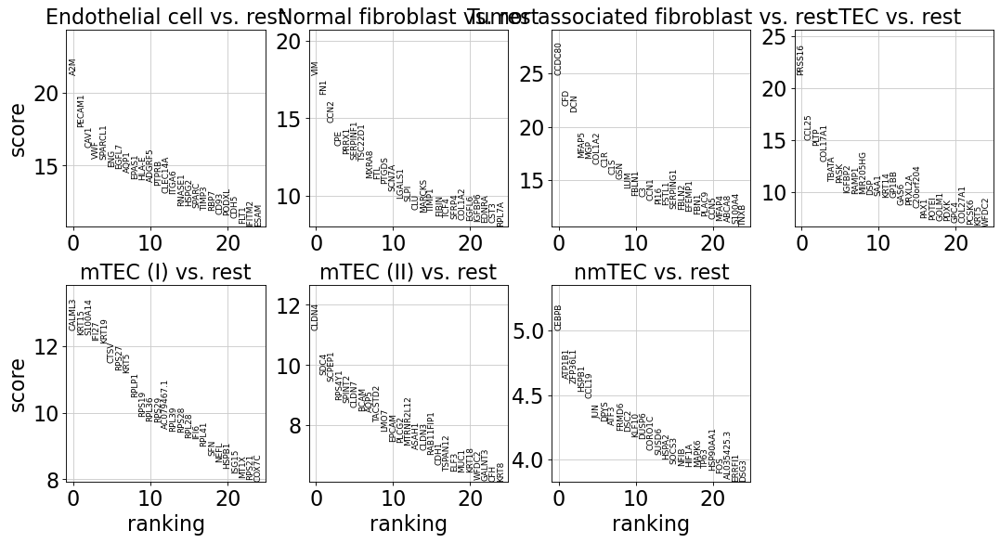

In [131]:
sc.tl.rank_genes_groups(adata, 'minor_cluster', method='t-test_overestim_var')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_minor_cluster']`


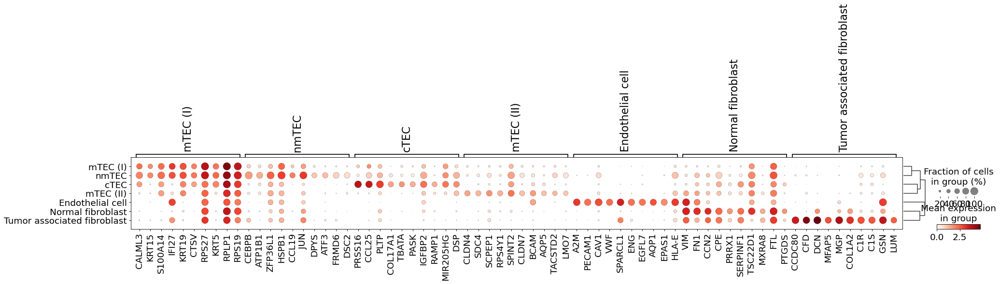

In [132]:
sc.pl.rank_genes_groups_dotplot(adata, n_genes=10, groupby='minor_cluster', save='minor.pdf')

## Gene set analysis

In [4]:
adata = sc.read(results_file_TEC)

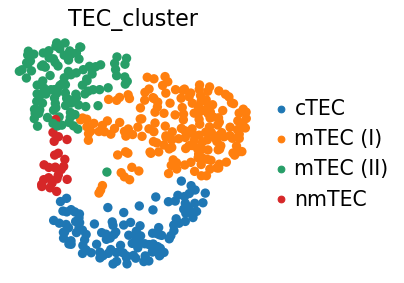

In [5]:
sc.pl.umap(adata, color=['TEC_cluster'])

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


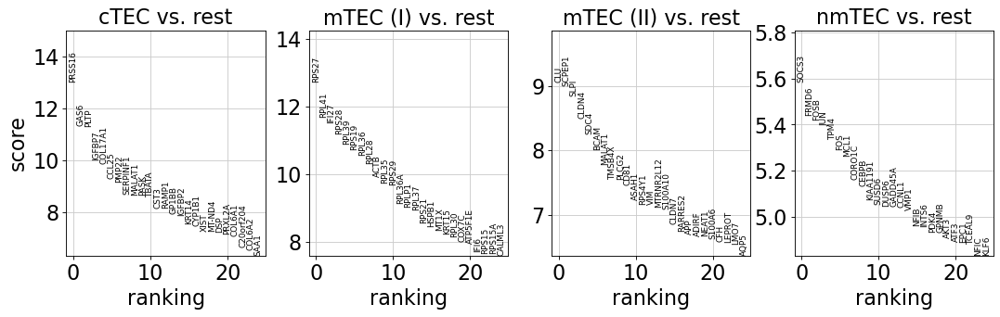

In [194]:
# sc.tl.rank_genes_groups(adata, 'TEC_cluster', method='t-test_overestim_var')
sc.tl.rank_genes_groups(adata, 'TEC_cluster', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [195]:
pd.DataFrame(adata.uns['rank_genes_groups']['names']).to_csv('scanpy/210430_merged_thymoma_MG21.22.23.03_TEC/gene.rank')

In [196]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
df_res = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj', 'scores']})

In [197]:
result

{'params': {'groupby': 'TEC_cluster',
  'reference': 'rest',
  'method': 'wilcoxon',
  'use_raw': True,
  'layer': None,
  'corr_method': 'benjamini-hochberg'},
 'names': rec.array([('PRSS16', 'RPS27', 'CLU', 'SOCS3'),
            ('GAS6', 'RPL41', 'SCPEP1', 'FRMD6'),
            ('PLTP', 'IFI27', 'SLPI', 'FOSB'), ...,
            ('IFI27', 'APP', 'CTSV', 'RPS12'),
            ('RPS27', 'NEAT1', 'KRT5', 'RPS18'),
            ('TMSB4X', 'MALAT1', 'RPLP1', 'CST3')],
           dtype=[('cTEC', 'O'), ('mTEC (I)', 'O'), ('mTEC (II)', 'O'), ('nmTEC', 'O')]),
 'scores': rec.array([(13.015562,  12.713968,   9.057018,  5.5836515),
            (11.319353,  11.668492,   9.002722,  5.43889  ),
            (11.282292,  11.511933,   8.833849,  5.41821  ), ...,
            (-8.451663, -11.01724 ,  -9.744014, -2.3609884),
            (-8.818203, -11.506688,  -9.960281, -2.5608969),
            (-8.954244, -15.105529, -10.78348 , -2.8159525)],
           dtype=[('cTEC', '<f4'), ('mTEC (I)', '<f4'), ('m

In [198]:
df_res.loc[(df_res['nmTEC_p'] < 0.2) & (df_res['nmTEC_l'] > 1), ['nmTEC_n']
          ].to_csv('scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/nmTEC.padj0.05lfc2.csv', 
                   index=None, header=None)

In [199]:
df_res

,cTEC_n,cTEC_l,cTEC_p,cTEC_s,mTEC (I)_n,mTEC (I)_l,mTEC (I)_p,mTEC (I)_s,mTEC (II)_n,mTEC (II)_l,mTEC (II)_p,mTEC (II)_s,nmTEC_n,nmTEC_l,nmTEC_p,nmTEC_s
0,PRSS16,5.807768,3.652991e-34,13.015562,RPS27,2.119629,9.051307e-33,12.713968,CLU,3.377830,6.133627e-16,9.057018,SOCS3,3.478525,0.000636,5.583652
1,GAS6,3.466054,1.926040e-25,11.319353,RPL41,1.350532,2.252985e-27,11.668492,SCPEP1,3.489048,8.954642e-16,9.002722,FRMD6,3.415787,0.000636,5.438890
2,PLTP,3.464117,1.958245e-25,11.282292,IFI27,4.457000,8.936279e-27,11.511933,SLPI,3.922433,3.365110e-15,8.833849,FOSB,3.423939,0.000636,5.418210
3,IGFBP7,3.633251,1.664532e-19,9.982454,RPS28,1.685175,3.372599e-25,11.172992,CLDN4,3.511583,5.260993e-14,8.486900,JUN,3.166789,0.000636,5.392360
4,COL17A1,5.554400,5.688694e-19,9.837375,RPL39,1.819497,7.203954e-24,10.871574,SDC4,3.431155,3.529194e-13,8.253147,TPM4,2.762843,0.000704,5.333766
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36596,ACTG1,-1.556431,6.931673e-12,-7.868182,DDX17,-2.467114,9.889365e-16,-8.909341,CALML3,-4.539637,4.482179e-17,-9.387862,MT-ATP6,-0.215578,0.213285,-2.333415
36597,RPS26,-1.913480,3.075383e-12,-7.982980,MTRNR2L12,-2.962180,2.663187e-18,-9.567858,RPS28,-1.744849,4.180259e-18,-9.657507,COX4I1,-0.629918,0.207814,-2.348925
36598,IFI27,-4.730676,7.507952e-14,-8.451663,APP,-3.031798,1.650129e-24,-11.017240,CTSV,-8.394314,2.387229e-18,-9.744014,RPS12,-0.299334,0.204069,-2.360988
36599,RPS27,-1.758680,4.730101e-15,-8.818203,NEAT1,-3.440827,8.936279e-27,-11.506688,KRT5,-3.942225,4.161850e-19,-9.960281,RPS18,-0.263612,0.145239,-2.560897


In [201]:
df_res['nmTEC_n']

,cTEC_n,cTEC_l,cTEC_p,cTEC_s,mTEC (I)_n,mTEC (I)_l,mTEC (I)_p,mTEC (I)_s,mTEC (II)_n,mTEC (II)_l,mTEC (II)_p,mTEC (II)_s,nmTEC_n,nmTEC_l,nmTEC_p,nmTEC_s
0,PRSS16,5.807768,3.652991e-34,13.015562,RPS27,2.119629,9.051307e-33,12.713968,CLU,3.377830,6.133627e-16,9.057018,SOCS3,3.478525,0.000636,5.583652
1,GAS6,3.466054,1.926040e-25,11.319353,RPL41,1.350532,2.252985e-27,11.668492,SCPEP1,3.489048,8.954642e-16,9.002722,FRMD6,3.415787,0.000636,5.438890
2,PLTP,3.464117,1.958245e-25,11.282292,IFI27,4.457000,8.936279e-27,11.511933,SLPI,3.922433,3.365110e-15,8.833849,FOSB,3.423939,0.000636,5.418210
3,IGFBP7,3.633251,1.664532e-19,9.982454,RPS28,1.685175,3.372599e-25,11.172992,CLDN4,3.511583,5.260993e-14,8.486900,JUN,3.166789,0.000636,5.392360
4,COL17A1,5.554400,5.688694e-19,9.837375,RPL39,1.819497,7.203954e-24,10.871574,SDC4,3.431155,3.529194e-13,8.253147,TPM4,2.762843,0.000704,5.333766
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36596,ACTG1,-1.556431,6.931673e-12,-7.868182,DDX17,-2.467114,9.889365e-16,-8.909341,CALML3,-4.539637,4.482179e-17,-9.387862,MT-ATP6,-0.215578,0.213285,-2.333415
36597,RPS26,-1.913480,3.075383e-12,-7.982980,MTRNR2L12,-2.962180,2.663187e-18,-9.567858,RPS28,-1.744849,4.180259e-18,-9.657507,COX4I1,-0.629918,0.207814,-2.348925
36598,IFI27,-4.730676,7.507952e-14,-8.451663,APP,-3.031798,1.650129e-24,-11.017240,CTSV,-8.394314,2.387229e-18,-9.744014,RPS12,-0.299334,0.204069,-2.360988
36599,RPS27,-1.758680,4.730101e-15,-8.818203,NEAT1,-3.440827,8.936279e-27,-11.506688,KRT5,-3.942225,4.161850e-19,-9.960281,RPS18,-0.263612,0.145239,-2.560897


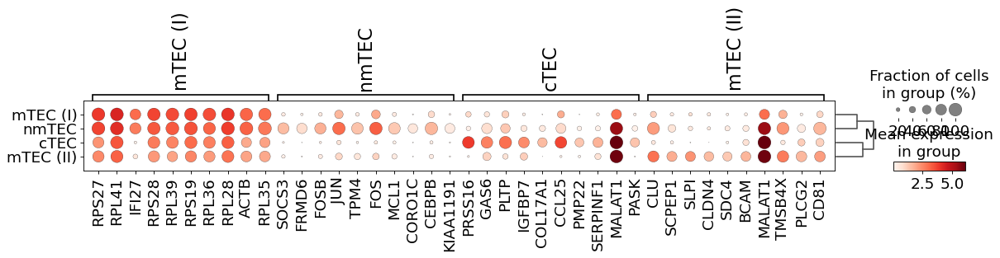

In [200]:
sc.pl.rank_genes_groups_dotplot(adata, n_genes=10, groupby='TEC_cluster', save=False)

In [141]:
df_res[['nmTEC_n', 'nmTEC_s']].to_csv('scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/nmTEC.rnk', sep='\t', header=None, index=None)

In [142]:
df_res[['cTEC_n', 'cTEC_s']].to_csv('scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/cTEC.rnk', sep='\t', header=None, index=None)
df_res[['mTEC (I)_n', 'mTEC (I)_s']].to_csv('scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/mTECI.rnk', sep='\t', header=None, index=None)
df_res[['mTEC (II)_n', 'mTEC (II)_s']].to_csv('scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/mTECII.rnk', sep='\t', header=None, index=None)

In [143]:
import os
import gseapy as gp
from gseapy.plot import barplot, dotplot
gp.__version__

'0.10.4'

In [144]:
pre_res = gp.prerank(rnk='scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/nmTEC.rnk', gene_sets='data/ReactomePathways.gmt',
                     processes=4,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_reactome/gseapy/', format='png', seed=6)

In [145]:
pre_res.res2d.sort_values(by='nes', ascending=False).head(20)

,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
Term,,,,,,,,
Peptide ligand-binding receptors,-0.288294,inf,NaN,0.670367,198,197,CCL19;NPFFR2;CCL5;EDN1;NPY1R;MC5R;NLN;ANXA1;AC...,CXCL6;CCL11;PPBP;CXCL11;CXCL13;CCL3;CCR6;KEL;I...
Transcriptional regulation by the AP-2 (TFAP2) family of transcription factors,0.790668,1.400051,0.000000,0.863265,36,36,APOE;MYC;ATAD2;CDKN1A;EP300;NPM1;CREBBP;YY1;KD...,APOE;MYC;ATAD2;CDKN1A;EP300;NPM1;CREBBP;YY1;KD...
T41 mutants of beta-catenin aren't phosphorylated,0.840445,1.397511,0.006417,0.710723,15,15,CSNK1A1;PPP2CA;PPP2CB;PPP2R5E;APC;CTNNB1;GSK3B...,CSNK1A1;PPP2CA;PPP2CB;PPP2R5E;APC;CTNNB1;GSK3B...
S37 mutants of beta-catenin aren't phosphorylated,0.840445,1.392373,0.009615,0.624280,15,15,CSNK1A1;PPP2CA;PPP2CB;PPP2R5E;APC;CTNNB1;GSK3B...,CSNK1A1;PPP2CA;PPP2CB;PPP2R5E;APC;CTNNB1;GSK3B...
Signaling by GSK3beta mutants,0.840445,1.392308,0.006417,0.535528,15,15,CSNK1A1;PPP2CA;PPP2CB;PPP2R5E;APC;CTNNB1;GSK3B...,CSNK1A1;PPP2CA;PPP2CB;PPP2R5E;APC;CTNNB1;GSK3B...
Signaling by CTNNB1 phospho-site mutants,0.840445,1.381203,0.004246,0.534199,15,15,CSNK1A1;PPP2CA;PPP2CB;PPP2R5E;APC;CTNNB1;GSK3B...,CSNK1A1;PPP2CA;PPP2CB;PPP2R5E;APC;CTNNB1;GSK3B...
Formation of tubulin folding intermediates by CCT/TriC,0.791579,1.380444,0.001018,0.478866,26,26,TUBB2A;TUBA1A;TUBB4B;TCP1;CCT4;CCT7;TUBB2B;TUB...,TUBB2A;TUBA1A;TUBB4B;TCP1;CCT4;CCT7;TUBB2B;TUB...
Negative regulation of NOTCH4 signaling,0.765359,1.378833,0.000000,0.440230,54,54,UBC;YWHAZ;PSMB4;PSMA5;PSMD12;PSMB7;FBXW7;PSMA7...,UBC;YWHAZ;PSMB4;PSMA5;PSMD12;PSMB7;FBXW7;PSMA7...
S33 mutants of beta-catenin aren't phosphorylated,0.840445,1.376394,0.015890,0.411910,15,15,CSNK1A1;PPP2CA;PPP2CB;PPP2R5E;APC;CTNNB1;GSK3B...,CSNK1A1;PPP2CA;PPP2CB;PPP2R5E;APC;CTNNB1;GSK3B...


In [146]:
names = gp.get_library_name() # default: Human
names

['ARCHS4_Cell-lines',
 'ARCHS4_IDG_Coexp',
 'ARCHS4_Kinases_Coexp',
 'ARCHS4_TFs_Coexp',
 'ARCHS4_Tissues',
 'Achilles_fitness_decrease',
 'Achilles_fitness_increase',
 'Aging_Perturbations_from_GEO_down',
 'Aging_Perturbations_from_GEO_up',
 'Allen_Brain_Atlas_10x_scRNA_2021',
 'Allen_Brain_Atlas_down',
 'Allen_Brain_Atlas_up',
 'BioCarta_2013',
 'BioCarta_2015',
 'BioCarta_2016',
 'BioPlanet_2019',
 'BioPlex_2017',
 'CCLE_Proteomics_2020',
 'CORUM',
 'COVID-19_Related_Gene_Sets',
 'COVID-19_Related_Gene_Sets_2021',
 'Cancer_Cell_Line_Encyclopedia',
 'CellMarker_Augmented_2021',
 'ChEA_2013',
 'ChEA_2015',
 'ChEA_2016',
 'Chromosome_Location',
 'Chromosome_Location_hg19',
 'ClinVar_2019',
 'DSigDB',
 'Data_Acquisition_Method_Most_Popular_Genes',
 'DepMap_WG_CRISPR_Screens_Broad_CellLines_2019',
 'DepMap_WG_CRISPR_Screens_Sanger_CellLines_2019',
 'Descartes_Cell_Types_and_Tissue_2021',
 'DisGeNET',
 'Disease_Perturbations_from_GEO_down',
 'Disease_Perturbations_from_GEO_up',
 'Disease_

In [ ]:
for clu in adata.obs['TEC_cluster'].unique():
    os.makedirs('scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_reactome/gseapy/{}'.format(clu), exist_ok=True)
    df_res[['{}_n'.format(clu), '{}_s'.format(clu)]].to_csv('scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_reactome/{}.rnk'.format(clu), 
                                                            sep='\t', header=None, index=None)
    pre_res = gp.prerank(rnk='scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_reactome/{}.rnk'.format(clu), 
                         gene_sets='data/ReactomePathways.gmt',
                     processes=10,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_reactome/gseapy/{}'.format(clu), 
                         format='png', seed=6)

In [ ]:
for clu in adata.obs['TEC_cluster'].unique():
    os.makedirs('scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_wp/gseapy/{}'.format(clu), exist_ok=True)
    df_res[['{}_n'.format(clu), '{}_s'.format(clu)]].to_csv('scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_reactome/{}.rnk'.format(clu), 
                                                            sep='\t', header=None, index=None)
    pre_res = gp.prerank(rnk='scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_reactome/{}.rnk'.format(clu), 
                         gene_sets='WikiPathways_2019_Human',
                     processes=10,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_wp/gseapy/{}'.format(clu), 
                         format='png', seed=6)

In [ ]:
for clu in adata.obs['TEC_cluster'].unique():
    os.makedirs('scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_kegg/gseapy/{}'.format(clu), exist_ok=True)
    df_res[['{}_n'.format(clu), '{}_s'.format(clu)]].to_csv('scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_reactome/{}.rnk'.format(clu), 
                                                            sep='\t', header=None, index=None)
    pre_res = gp.prerank(rnk='scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_reactome/{}.rnk'.format(clu), 
                         gene_sets='KEGG_2021_Human',
                     processes=10,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_kegg/gseapy/{}'.format(clu), 
                         format='png', seed=6)

In [ ]:
for clu in adata.obs['TEC_cluster'].unique():
    os.makedirs('scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_gobp/gseapy/{}'.format(clu), exist_ok=True)
    df_res[['{}_n'.format(clu), '{}_s'.format(clu)]].to_csv('scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_reactome/{}.rnk'.format(clu), 
                                                            sep='\t', header=None, index=None)
    pre_res = gp.prerank(rnk='scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_reactome/{}.rnk'.format(clu), 
                         gene_sets='GO_Biological_Process_2018',
                     processes=10,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir='scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_gobp/gseapy/{}'.format(clu), 
                         format='png', seed=6)

In [9]:
from adjustText import adjust_text

In [10]:
clu = 'nmTEC'
th_fdr = 0.05

df_gs = pd.read_csv(
    'scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_reactome/gseapy/{}/gseapy.prerank.gene_sets.report.csv'.format(clu))
df_q = df_gs[df_gs['fdr'] < th_fdr]
df_q = df_q[df_q.nes != np.inf]
df_q['-log10padj'] = -np.log10(df_q['fdr'] + 10e-10)

In [11]:
cm = plt.cm.get_cmap('viridis')

In [13]:
df_q

,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes,-log10padj


In [241]:
clu = 'nmTEC'
th_fdr = 0.2
list_term_annot = ['Diseases of programmed cell death',
                   'RIP-mediated NFkB activation via ZBP1',
                   'TP53 Regulates Transcription of DNA Repair Genes',
                   'Interleukin-1 family signaling',
                   'E3 ubiquitin ligases ubiquitinate target proteins',
                   'Interferon gamma signaling',
                  'Smooth Muscle Contraction',
                   'Antigen processing-Cross presentation',
                   'Class I MHC mediated antigen processing & presentation',
                   'MHC class II antigen presentation',
                  'Neuronal System']

df_gs = pd.read_csv(
    'scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_reactome/gseapy/{}/gseapy.prerank.gene_sets.report.csv'.format(clu))
df_gs['sig'] = df_gs['fdr'] < th_fdr
df_gs = df_gs[df_gs.nes != np.inf]
df_gs['-log10padj'] = -np.log10(df_gs['fdr'] + 10e-10)

In [242]:
df_gs

,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes,sig,-log10padj
0,Diseases of programmed cell death,0.718698,1.276550,0.008024,0.144297,71,43,JUN;LMNA;YWHAE;SOD2;RBBP7;CAPNS1;CAST;GSDME;EZ...,JUN;LMNA;YWHAE;SOD2;RBBP7;CAPNS1;CAST;GSDME;EZ...,True,0.840744
1,RHOF GTPase cycle,0.718685,1.276055,0.014141,0.144618,42,42,PIK3R1;VAMP3;RAB7A;ACTB;MCAM;DIAPH2;SOWAHC;DIA...,PIK3R1;VAMP3;RAB7A;ACTB;MCAM;DIAPH2;SOWAHC;DIA...,True,0.839779
2,Transferrin endocytosis and recycling,0.730897,1.276693,0.021450,0.144839,31,31,STEAP2;ATP6V1F;ATP6V1B2;ATP6V1D;ATP6V0E1;ATP6V...,STEAP2;ATP6V1F;ATP6V1B2;ATP6V1D;ATP6V0E1;ATP6V...,True,0.839115
3,Transcription of the HIV genome,0.707977,1.276945,0.001000,0.145163,74,70,TAF15;TAF2;POLR2I;CCNK;GTF2B;ELOA;TCEA1;POLR2A...,TAF15;TAF2;POLR2I;CCNK;GTF2B;ELOA;TCEA1;POLR2A...,True,0.838144
4,p75NTR signals via NF-kB,0.770408,1.277107,0.053088,0.145712,16,16,UBC;NFKBIA;SQSTM1;MYD88;UBB;NFKB1;RIPK2;RELA;I...,UBC;NFKBIA;SQSTM1;MYD88;UBB;NFKB1;RIPK2;RELA;I...,True,0.836506
...,...,...,...,...,...,...,...,...,...,...,...
1216,Collagen chain trimerization,0.349285,0.624998,0.991935,0.989117,44,44,COL7A1;COL22A1;COL4A5;COL27A1;COL21A1;COL5A3;C...,COL7A1;COL22A1;COL4A5;COL27A1;COL21A1;COL5A3;C...,False,0.004752
1217,Defensins,0.340101,0.603969,0.989950,0.991403,49,44,TLR2;DEFA5;CD4;DEFB126;DEFB125;DEFB132;DEFB128...,TLR2;DEFA5,False,0.003750
1218,Acyl chain remodelling of PI,0.345055,0.575907,0.982365,0.994892,17,17,PLA2G4C;PLA2G4A;MBOAT7;PLAAT3;PLA2G12A;PLA2G2D...,PLA2G4C,False,0.002224
1219,Collagen degradation,0.320606,0.563492,0.994970,0.995623,40,40,MMP10;ADAM17;MMP14;MMP9;CTSL;MMP19;ADAM10;ADAM...,MMP10;ADAM17;MMP14;MMP9;CTSL;MMP19;ADAM10;ADAM...,False,0.001905


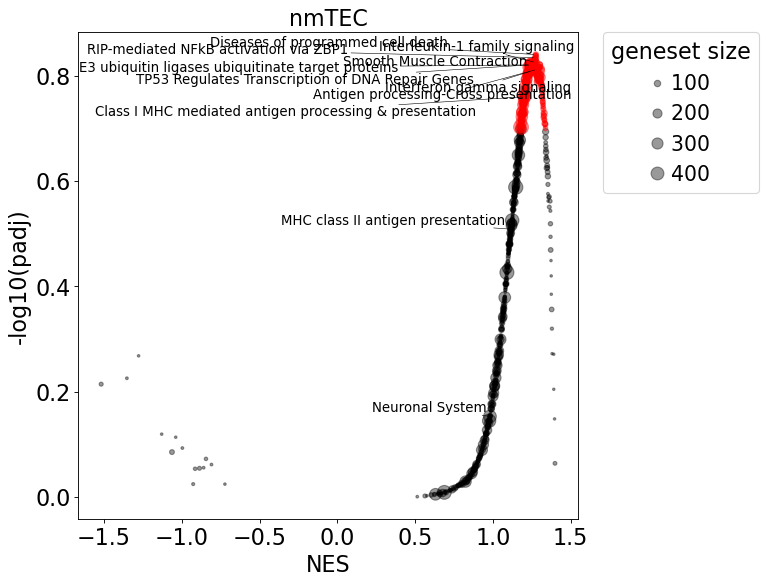

In [243]:
fig, ax = plt.subplots(figsize=(8,8))
scatter = ax.scatter(df_gs.loc[~df_gs['sig'], 'nes'], df_gs.loc[~df_gs['sig'], '-log10padj'], s=df_gs.loc[~df_gs['sig'], 'geneset_size']/3,
           alpha=0.4, color='k')
ax.scatter(df_gs.loc[df_gs['sig'], 'nes'], df_gs.loc[df_gs['sig'], '-log10padj'], s=df_gs.loc[df_gs['sig'], 'geneset_size']/3,
           alpha=0.4, color='r')
ax.grid(None)
ax.set_xlabel('NES')
ax.set_ylabel('-log10(padj)')
ax.set_title(clu)

texts = []
for pos,row in df_gs[df_gs['Term'].isin(list_term_annot)].iterrows():
    texts.append(plt.text(row['nes'], row['-log10padj'], row['Term'], size=12))
adjust_text(texts, arrowprops=dict(arrowstyle="-", color='k', lw=0.5))

kw = dict(prop="sizes", num=5,
          func=lambda s: s*3)
legend2 = ax.legend(*scatter.legend_elements(**kw), title="geneset size",
                    bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.savefig('scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_reactome/gseapy/{}/vol.pdf'.format(clu),
                   bbox_inches='tight')

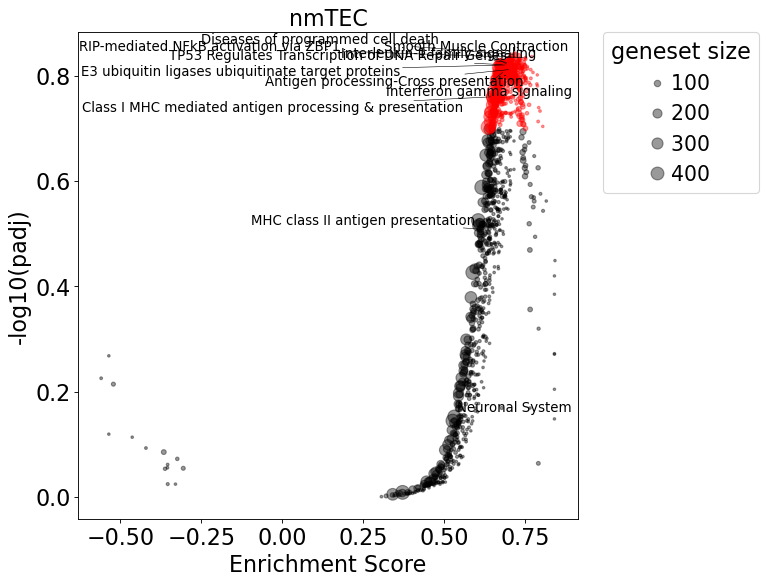

In [244]:
fig, ax = plt.subplots(figsize=(8,8))
scatter = ax.scatter(df_gs.loc[~df_gs['sig'], 'es'], df_gs.loc[~df_gs['sig'], '-log10padj'], s=df_gs.loc[~df_gs['sig'], 'geneset_size']/3,
           alpha=0.4, color='k')
ax.scatter(df_gs.loc[df_gs['sig'], 'es'], df_gs.loc[df_gs['sig'], '-log10padj'], s=df_gs.loc[df_gs['sig'], 'geneset_size']/3,
           alpha=0.4, color='r')
ax.grid(None)
ax.set_xlabel('Enrichment Score')
ax.set_ylabel('-log10(padj)')
ax.set_title(clu)

texts = []
for pos,row in df_gs[df_gs['Term'].isin(list_term_annot)].iterrows():
    texts.append(plt.text(row['es'], row['-log10padj'], row['Term'], size=12))
adjust_text(texts, arrowprops=dict(arrowstyle="-", color='k', lw=0.5))

kw = dict(prop="sizes", num=5,
          func=lambda s: s*3)
legend2 = ax.legend(*scatter.legend_elements(**kw), title="geneset size",
                    bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.savefig('scanpy/210711_merged_thymoma_MG21.22.23.03_TEC/gsea_reactome/gseapy/{}/vol.es.pdf'.format(clu),
                   bbox_inches='tight')

In [102]:
df_res[df_res['nmTEC_n'] == 'CHRNA1']

NameError: name 'df_res' is not defined

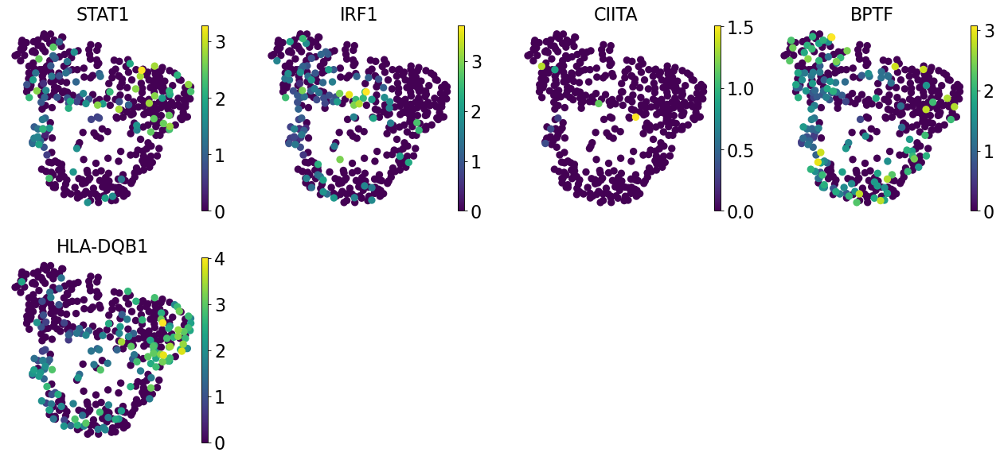

In [103]:
sc.pl.umap(adata, color=['STAT1', 'IRF1', 'CIITA', 'BPTF', 'HLA-DQB1'])

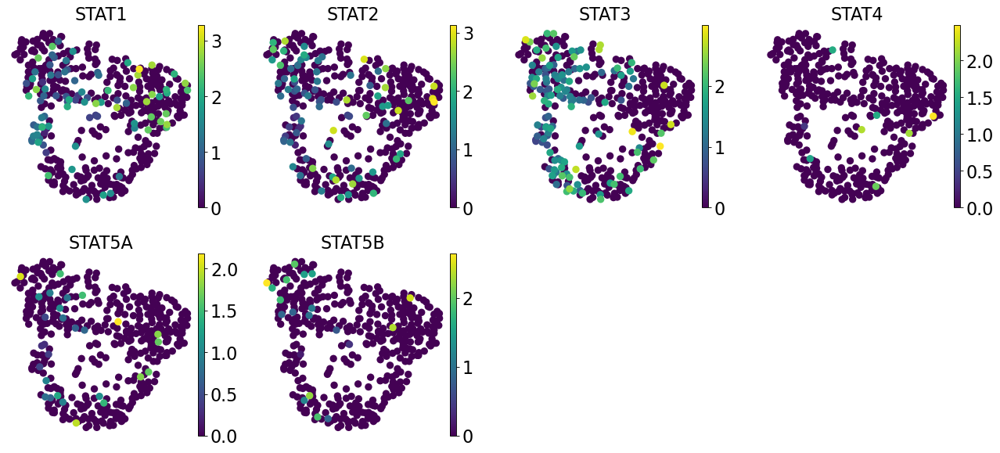

In [104]:
sc.pl.umap(adata, color=['STAT1', 'STAT2', 'STAT3', 'STAT4', 'STAT5A', 'STAT5B'])

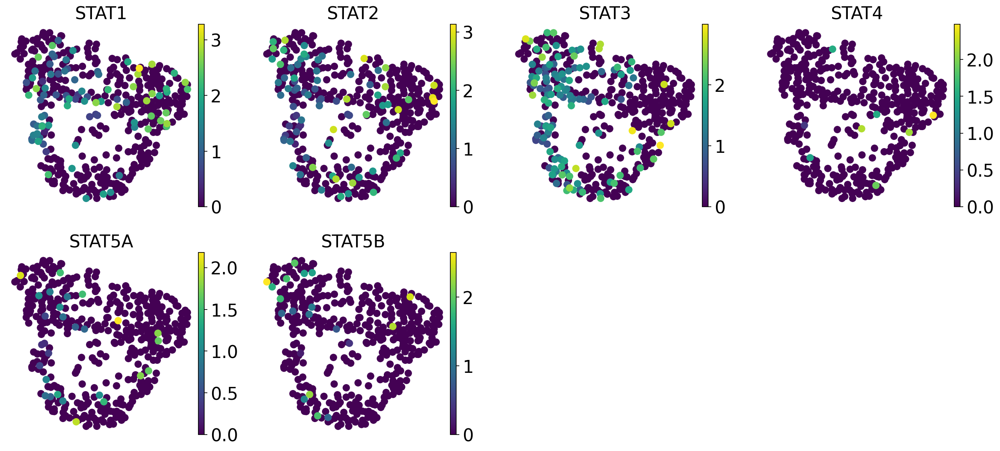

In [243]:
sc.pl.umap(bdata, color=['STAT1', 'STAT2', 'STAT3', 'STAT4', 'STAT5A', 'STAT5B'])

In [25]:
with open('./data/ReactomePathways.gmt', 'r') as f:
    txt = f.read()
    
df_reactome = pd.DataFrame([[x.split('\t')[0], x.split('\t')[1], x.split('\t')[2:]] for x in txt.split('\n') if len(x.split('\t')) > 10],
            columns=['geneset', 'id', 'genes'])
df_reactome.index = df_reactome['id']
df_reactome.head()

,geneset,id,genes
id,,,
R-HSA-164843,2-LTR circle formation,R-HSA-164843,"[BANF1, HMGA1, LIG4, PSIP1, XRCC4, XRCC5, XRCC..."
R-HSA-1971475,A tetrasaccharide linker sequence is required ...,R-HSA-1971475,"[AGRN, B3GALT6, B3GAT1, B3GAT2, B3GAT3, B4GALT..."
R-HSA-5619084,ABC transporter disorders,R-HSA-5619084,"[ABCA1, ABCA12, ABCA3, ABCB11, ABCB4, ABCB6, A..."
R-HSA-1369062,ABC transporters in lipid homeostasis,R-HSA-1369062,"[ABCA10, ABCA12, ABCA2, ABCA3, ABCA5, ABCA6, A..."
R-HSA-382556,ABC-family proteins mediated transport,R-HSA-382556,"[ABCA10, ABCA12, ABCA2, ABCA3, ABCA4, ABCA5, A..."


computing score 'score_R-HSA-1971475'
    finished: added
    'score_R-HSA-1971475', score of gene set (adata.obs).
    499 total control genes are used. (0:00:00)


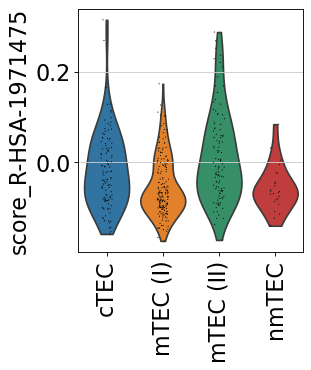

In [29]:
id_gs = 'R-HSA-1971475'

genes = [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index]
sc.tl.score_genes(adata, genes, score_name='score_{}'.format(id_gs), use_raw=True)
sc.pl.violin(adata, ['score_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}.pdf'.format(id_gs))

computing score 'score_R-HSA-112316'
    finished: added
    'score_R-HSA-112316', score of gene set (adata.obs).
    6416 total control genes are used. (0:00:00)


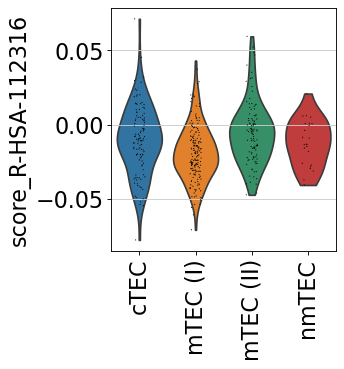

In [28]:
## neuronal system
id_gs = 'R-HSA-112316'
th = 0

genes = [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index]
genes = [g for g,b in zip(genes, list(np.array(adata.raw[:,genes].X.sum(axis=0) > th).flatten())) if b]
sc.tl.score_genes(adata, genes, score_name='score_{}'.format(id_gs), use_raw=True, ctrl_size=500)
sc.pl.violin(adata, ['score_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}.pdf'.format(id_gs))

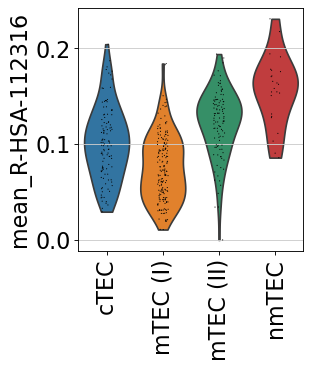

In [49]:
adata.obs['mean_{}'.format(id_gs)] = np.array(adata.raw[:,adata.raw.var.index.isin(genes)].X.mean(axis=1)).flatten()
sc.pl.violin(adata, ['mean_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}_mean.pdf'.format(id_gs))

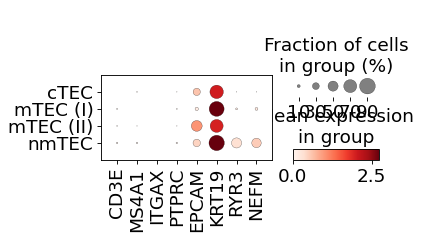

In [22]:
sc.pl.dotplot(adata, ['CD3E', 'MS4A1', 'ITGAX', 'PTPRC', 'EPCAM', 'KRT19', 'RYR3', 'NEFM'], groupby='TEC_cluster', save='nodoublet')

In [161]:
adata

AnnData object with n_obs × n_vars = 422 × 4065
    obs: 'sample', 'sample_type', 'site', 'fraction', 'n_genes', 'individual', 'score_DEGs', 'score_yellow', 'score_GWAS', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'TEC_cluster', 'bin_GABRA5', 'bin_NEFL', 'bin_NEFM', 'bin_SOX6', 'bin_KRT6A', 'bin_KRT15', 'score_cancer', 'score_R-HSA-112316', 'mean_R-HSA-112316'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'TEC_cluster_colors', 'TEC_cluster_sizes', 'dendrogram_TEC_cluster', 'dendrogram_leiden', 'leiden', 'leiden_colors', 'leiden_sizes', 'neighbors', 'paga', 'pca', 'rank_genes_groups', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

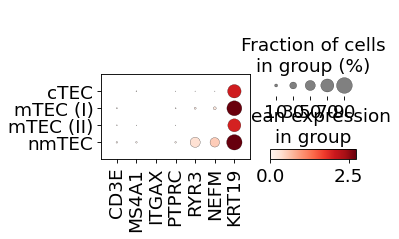

In [18]:
sc.pl.dotplot(adata, ['CD3E', 'MS4A1', 'ITGAX', 'PTPRC', 'KRT19', 'RYR3', 'NEFM'], groupby='TEC_cluster', save=False)

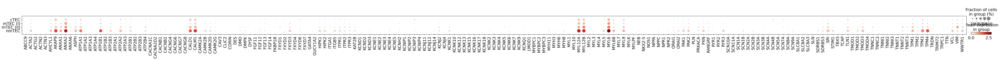

In [27]:
sc.pl.dotplot(adata, [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index], groupby='TEC_cluster')

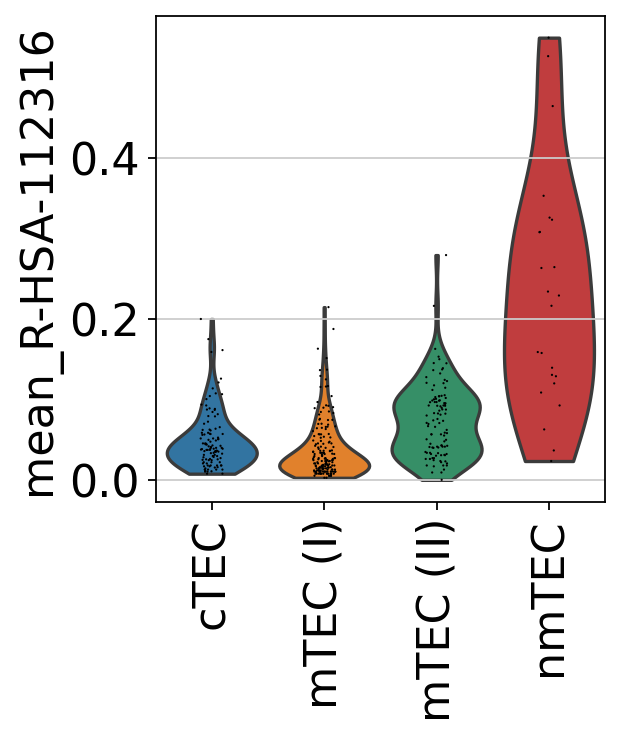

In [97]:
adata.obs['mean_{}'.format(id_gs)] = X.mean(axis=1)
sc.pl.violin(adata, ['mean_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}_mean.pdf'.format(id_gs))

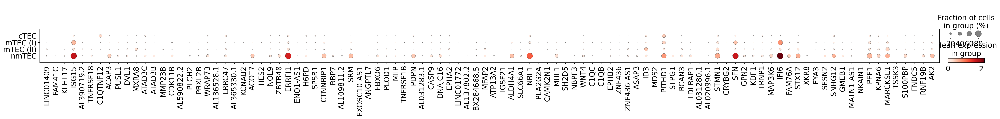

In [60]:
sc.pl.dotplot(adata, adata.var.index[:100], groupby='TEC_cluster')

computing score 'score_R-HSA-111465'
    finished: added
    'score_R-HSA-111465', score of gene set (adata.obs).
    546 total control genes are used. (0:00:00)


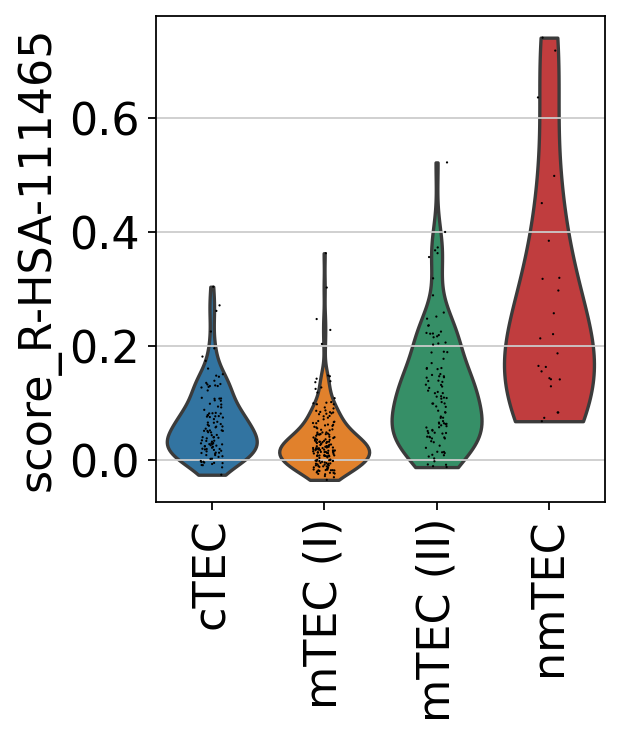

In [136]:
id_gs = 'R-HSA-111465'
sc.tl.score_genes(adata, df_reactome.loc[id_gs, 'genes'], score_name='score_{}'.format(id_gs), use_raw=True)
sc.pl.violin(adata, ['score_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save=False)

computing score 'score_R-HSA-445355'
    finished: added
    'score_R-HSA-445355', score of gene set (adata.obs).
    550 total control genes are used. (0:00:00)


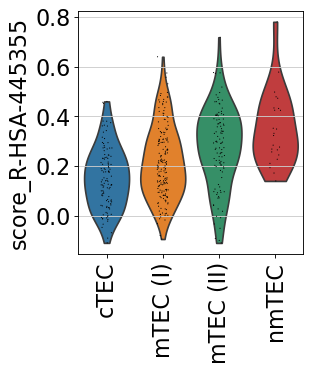

In [56]:
## Smooth Muscle Contraction
id_gs = 'R-HSA-445355'
sc.tl.score_genes(adata, df_reactome.loc[id_gs, 'genes'], score_name='score_{}'.format(id_gs), use_raw=True)
sc.pl.violin(adata, ['score_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}.pdf'.format(id_gs))

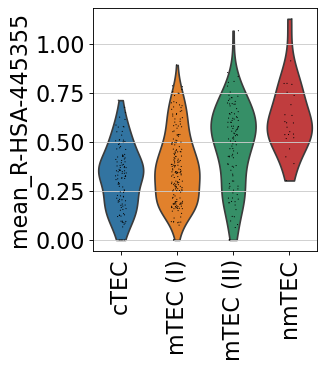

In [57]:
genes = [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index]
genes = [g for g,b in zip(genes, list(np.array(adata.raw[:,genes].X.sum(axis=0) > th).flatten())) if b]
adata.obs['mean_{}'.format(id_gs)] = np.array(adata.raw[:,genes].X.todense()).mean(axis=1)
sc.pl.violin(adata, ['mean_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}_mean.pdf'.format(id_gs))

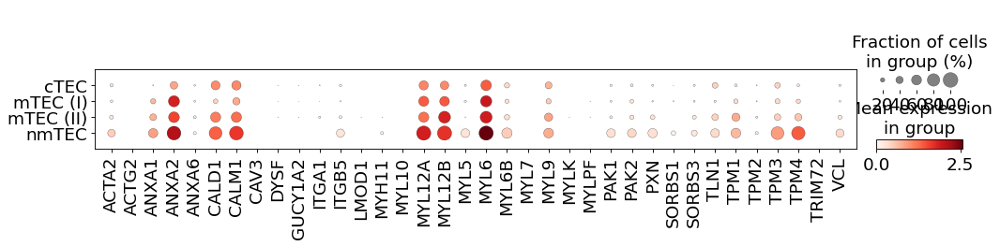

In [58]:
sc.pl.dotplot(adata, [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index], groupby='TEC_cluster')

computing score 'score_R-HSA-397014'
    finished: added
    'score_R-HSA-397014', score of gene set (adata.obs).
    696 total control genes are used. (0:00:00)


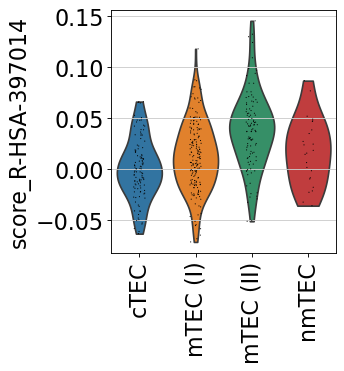

In [63]:
## Muscle contraction
id_gs = 'R-HSA-397014'

sc.tl.score_genes(adata, df_reactome.loc[id_gs, 'genes'], score_name='score_{}'.format(id_gs), use_raw=True)
sc.pl.violin(adata, ['score_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}.pdf'.format(id_gs))

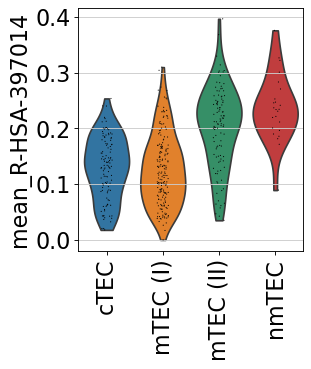

In [64]:
genes = [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index]
genes = [g for g,b in zip(genes, list(np.array(adata.raw[:,genes].X.sum(axis=0) > th).flatten())) if b]
adata.obs['mean_{}'.format(id_gs)] = np.array(adata.raw[:,genes].X.todense()).mean(axis=1)
sc.pl.violin(adata, ['mean_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}_mean.pdf'.format(id_gs))

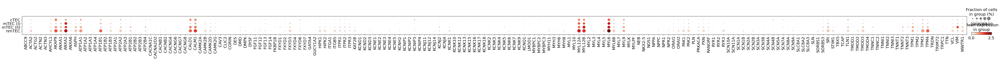

In [62]:
sc.pl.dotplot(adata, [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index], groupby='TEC_cluster')

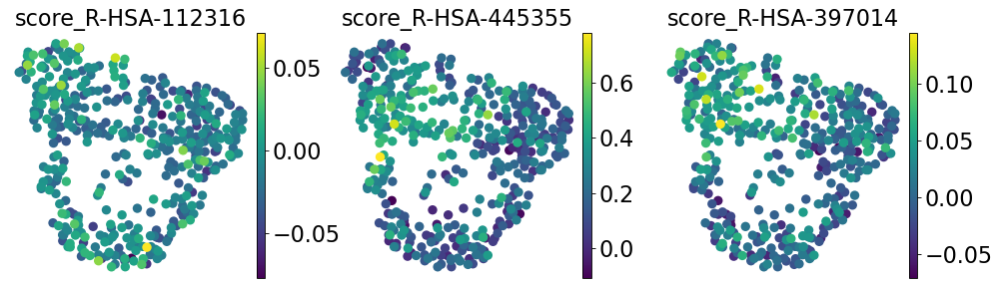

In [59]:
sc.pl.umap(adata, color=['score_R-HSA-112316', 'score_R-HSA-445355', 'score_R-HSA-397014'])

computing score 'score_R-HSA-912694'
    finished: added
    'score_R-HSA-912694', score of gene set (adata.obs).
    400 total control genes are used. (0:00:00)


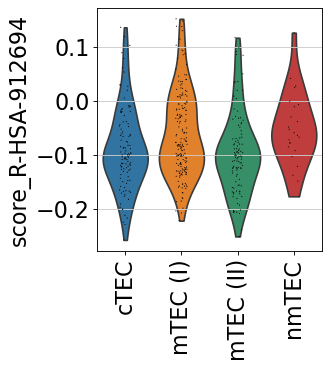

In [121]:
## Regulation of IFNA signaling
id_gs = 'R-HSA-912694'

sc.tl.score_genes(adata, df_reactome.loc[id_gs, 'genes'], score_name='score_{}'.format(id_gs), use_raw=True)
sc.pl.violin(adata, ['score_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}.pdf'.format(id_gs))

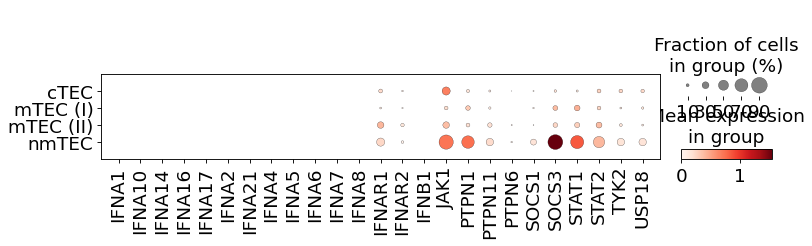

In [122]:
sc.pl.dotplot(adata, [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index], groupby='TEC_cluster')

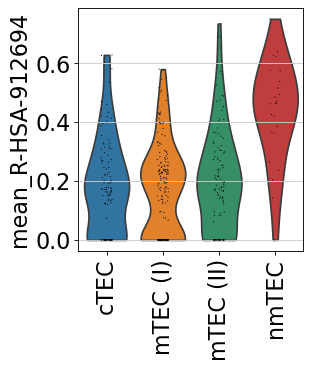

In [123]:
genes = [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index]
genes = [g for g,b in zip(genes, list(np.array(adata.raw[:,genes].X.sum(axis=0) > 0).flatten())) if b]
adata.obs['mean_{}'.format(id_gs)] = np.array(adata.raw[:,genes].X.todense()).mean(axis=1)
sc.pl.violin(adata, ['mean_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}_mean.pdf'.format(id_gs))

computing score 'score_R-HSA-912694'
    finished: added
    'score_R-HSA-912694', score of gene set (adata.obs).
    349 total control genes are used. (0:00:00)


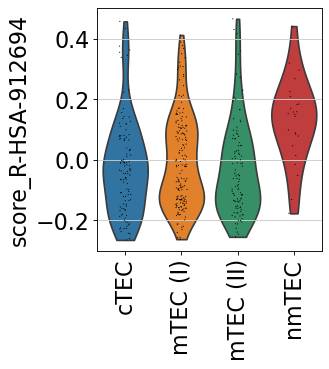

In [124]:
sc.tl.score_genes(adata, genes, score_name='score_{}'.format(id_gs), use_raw=True)
sc.pl.violin(adata, ['score_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}.pdf'.format(id_gs))

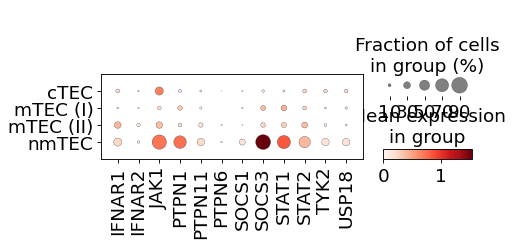

In [125]:
sc.pl.dotplot(adata, genes, groupby='TEC_cluster')

computing score 'score_R-HSA-8866654'
    finished: added
    'score_R-HSA-8866654', score of gene set (adata.obs).
    400 total control genes are used. (0:00:00)


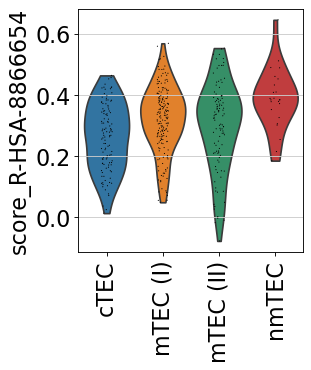

In [126]:
## E3 ubiquitin ligases ubiquitinate target proteins
id_gs = 'R-HSA-8866654'

sc.tl.score_genes(adata, df_reactome.loc[id_gs, 'genes'], score_name='score_{}'.format(id_gs), use_raw=True)
sc.pl.violin(adata, ['score_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}.pdf'.format(id_gs))

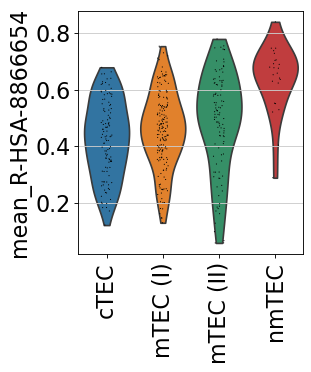

In [127]:
genes = [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index]
genes = [g for g,b in zip(genes, list(np.array(adata.raw[:,genes].X.sum(axis=0) > 0).flatten())) if b]
adata.obs['mean_{}'.format(id_gs)] = np.array(adata.raw[:,genes].X.todense()).mean(axis=1)
sc.pl.violin(adata, ['mean_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}_mean.pdf'.format(id_gs))

computing score 'score_R-HSA-8866654'
    finished: added
    'score_R-HSA-8866654', score of gene set (adata.obs).
    400 total control genes are used. (0:00:00)


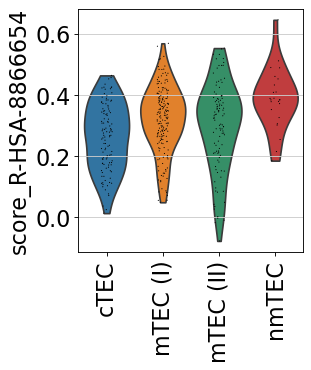

In [128]:
sc.tl.score_genes(adata, genes, score_name='score_{}'.format(id_gs), use_raw=True)
sc.pl.violin(adata, ['score_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}.pdf'.format(id_gs))

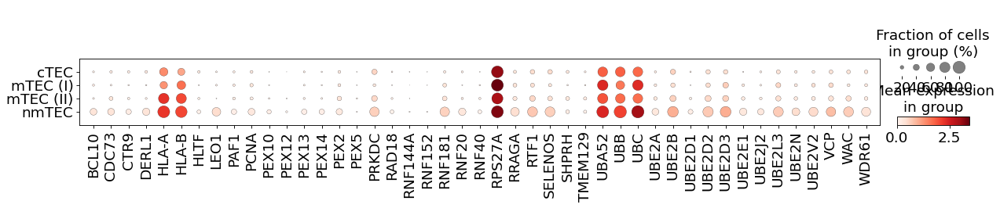

In [129]:
sc.pl.dotplot(adata, genes, groupby='TEC_cluster')

computing score 'score_R-HSA-1236975'
    finished: added
    'score_R-HSA-1236975', score of gene set (adata.obs).
    647 total control genes are used. (0:00:00)


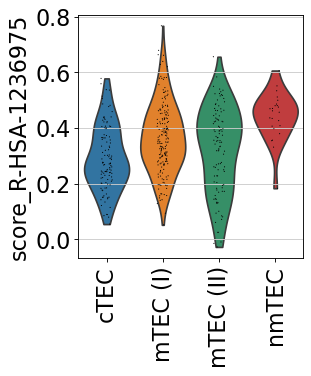

In [130]:
## Antigen processing-Cross presentation
id_gs = 'R-HSA-1236975'

sc.tl.score_genes(adata, df_reactome.loc[id_gs, 'genes'], score_name='score_{}'.format(id_gs), use_raw=True)
sc.pl.violin(adata, ['score_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}.pdf'.format(id_gs))

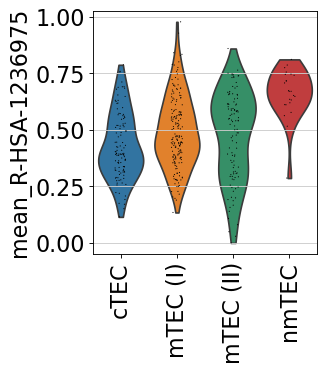

In [131]:
genes = [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index]
genes = [g for g,b in zip(genes, list(np.array(adata.raw[:,genes].X.sum(axis=0) > 0).flatten())) if b]
adata.obs['mean_{}'.format(id_gs)] = np.array(adata.raw[:,genes].X.todense()).mean(axis=1)
sc.pl.violin(adata, ['mean_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}_mean.pdf'.format(id_gs))

computing score 'score_R-HSA-1236975'
    finished: added
    'score_R-HSA-1236975', score of gene set (adata.obs).
    593 total control genes are used. (0:00:00)


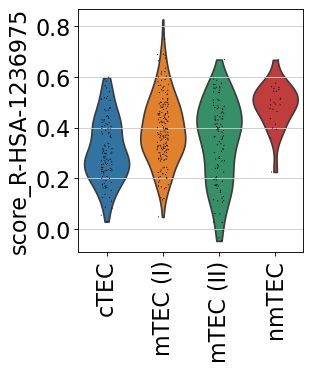

In [132]:
sc.tl.score_genes(adata, genes, score_name='score_{}'.format(id_gs), use_raw=True)
sc.pl.violin(adata, ['score_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}.pdf'.format(id_gs))


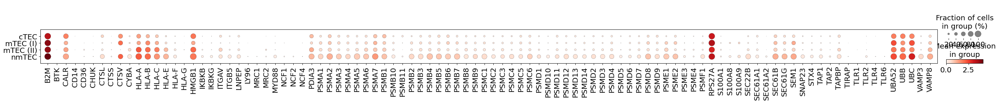

In [133]:
sc.pl.dotplot(adata, genes, groupby='TEC_cluster')

In [143]:
list_kegg_cancer = list(pd.read_csv('data/KEGG_PATHWAYS_IN_CANCER.txt', skiprows=2, header=None)[0])

genes = [x for x in list_kegg_cancer if x in adata.raw.var.index]
genes = [g for g,b in zip(genes, list(np.array(adata.raw[:,genes].X.sum(axis=0) > 0).flatten())) if b]
adata.obs['mean_cancer'] = np.array(adata.raw[:,genes].X.todense()).mean(axis=1)
# sc.pl.violin(adata, ['mean_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
#              rotation=90, save='reactome/{}_mean.pdf'.format(id_gs))

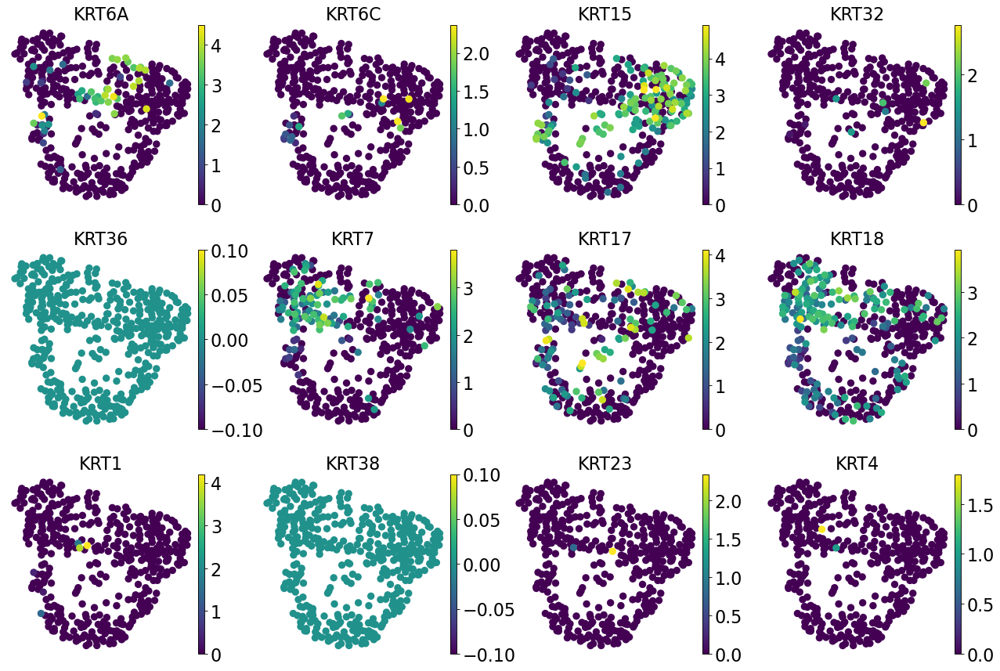

In [156]:
sc.pl.umap(adata, color=['KRT6A', 'KRT6C', 'KRT15', 'KRT32', 
                        'KRT36', 'KRT7', 'KRT17', 'KRT18', 'KRT1', 'KRT38', 'KRT23', 'KRT4'])

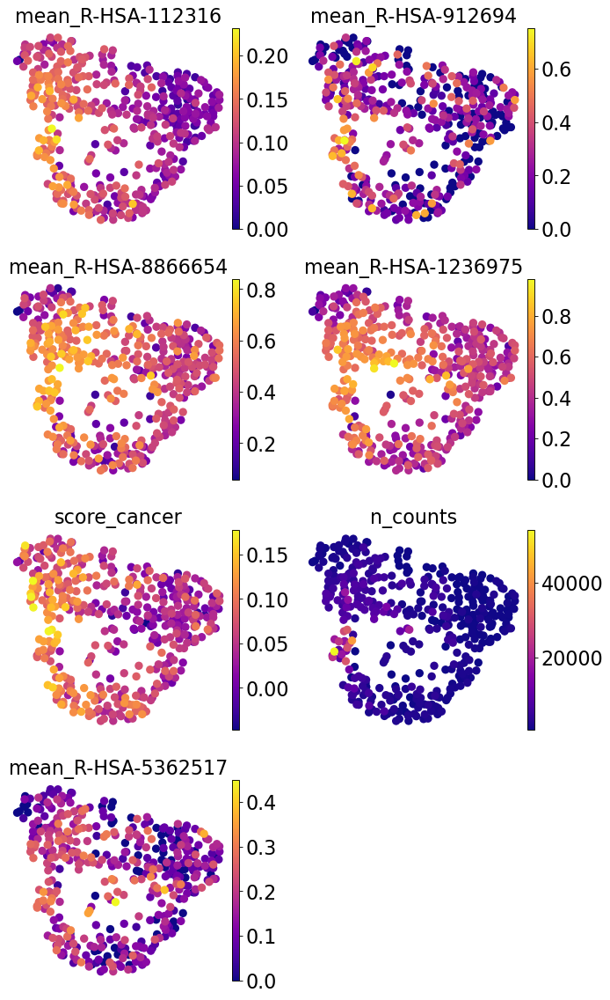

In [194]:
sc.pl.umap(adata, color=['mean_R-HSA-112316', 'mean_R-HSA-912694', 'mean_R-HSA-8866654', 'mean_R-HSA-1236975', 'score_cancer', 'n_counts', 'mean_R-HSA-5362517'], 
           cmap='plasma', save='pathways',
          ncols=2)

computing score 'score_R-HSA-877300'
    finished: added
    'score_R-HSA-877300', score of gene set (adata.obs).
    646 total control genes are used. (0:00:00)


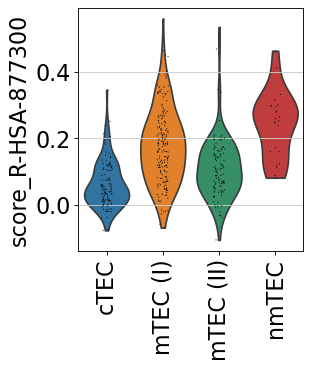

In [239]:
## Interferon gamma signaling
id_gs = 'R-HSA-877300'

sc.tl.score_genes(adata, df_reactome.loc[id_gs, 'genes'], score_name='score_{}'.format(id_gs), use_raw=True)
sc.pl.violin(adata, ['score_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}.pdf'.format(id_gs))

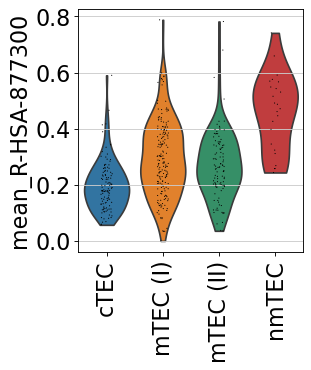

In [240]:
genes = [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index]
genes = [g for g,b in zip(genes, list(np.array(adata.raw[:,genes].X.sum(axis=0) > 0).flatten())) if b]
adata.obs['mean_{}'.format(id_gs)] = np.array(adata.raw[:,genes].X.todense()).mean(axis=1)
sc.pl.violin(adata, ['mean_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}_mean.pdf'.format(id_gs))

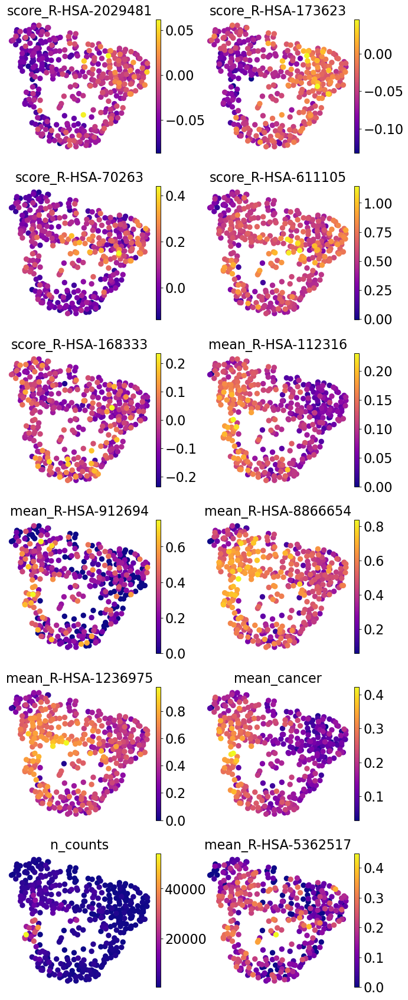

In [193]:
sc.pl.umap(adata, color=['score_R-HSA-2029481', 'score_R-HSA-173623', 'score_R-HSA-70263', 'score_R-HSA-611105',
                         'score_R-HSA-168333',
                         'mean_R-HSA-112316', 'mean_R-HSA-912694', 'mean_R-HSA-8866654', 'mean_R-HSA-1236975', 'mean_cancer', 'n_counts', 'mean_R-HSA-5362517'], 
           cmap='plasma', save='pathways',
          ncols=2)

computing score 'score_R-HSA-9707616'
    finished: added
    'score_R-HSA-9707616', score of gene set (adata.obs).
    597 total control genes are used. (0:00:00)


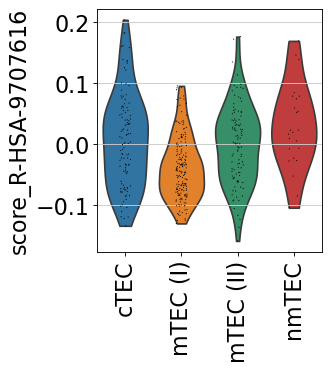

In [99]:
## RUNX2 regulates bone development (negative control)
id_gs = 'R-HSA-9707616'

sc.tl.score_genes(adata, df_reactome.loc[id_gs, 'genes'], score_name='score_{}'.format(id_gs), use_raw=True)
sc.pl.violin(adata, ['score_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}.pdf'.format(id_gs))

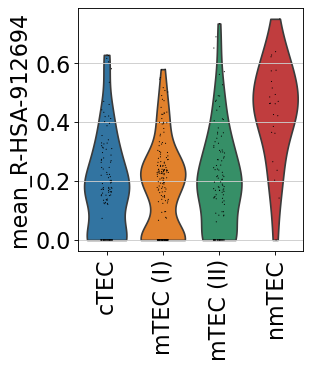

In [111]:
genes = [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index]
genes = [g for g,b in zip(genes, list(np.array(adata.raw[:,genes].X.sum(axis=0) > th).flatten())) if b]
adata.obs['mean_{}'.format(id_gs)] = np.array(adata.raw[:,genes].X.todense()).mean(axis=1)
sc.pl.violin(adata, ['mean_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}_mean.pdf'.format(id_gs))

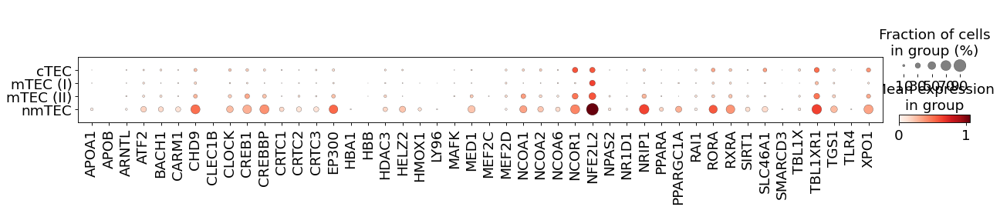

In [101]:
sc.pl.dotplot(adata, [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index], groupby='TEC_cluster')

computing score 'score_R-HSA-5362517'
    finished: added
    'score_R-HSA-5362517', score of gene set (adata.obs).
    547 total control genes are used. (0:00:00)


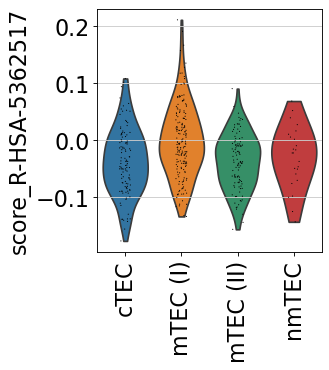

In [87]:
## Signaling by Retinoic Acid (negative control)
id_gs = 'R-HSA-5362517'

sc.tl.score_genes(adata, df_reactome.loc[id_gs, 'genes'], score_name='score_{}'.format(id_gs), use_raw=True)
sc.pl.violin(adata, ['score_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}.pdf'.format(id_gs))

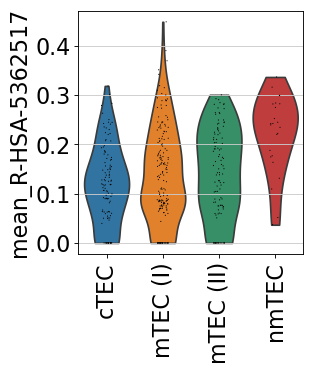

In [88]:
genes = [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index]
genes = [g for g,b in zip(genes, list(np.array(adata.raw[:,genes].X.sum(axis=0) > th).flatten())) if b]
adata.obs['mean_{}'.format(id_gs)] = np.array(adata.raw[:,genes].X.todense()).mean(axis=1)
sc.pl.violin(adata, ['mean_{}'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='reactome/{}_mean.pdf'.format(id_gs))

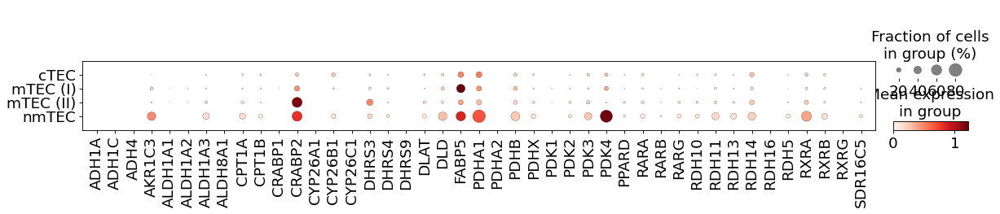

In [89]:
sc.pl.dotplot(adata, [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index], groupby='TEC_cluster')

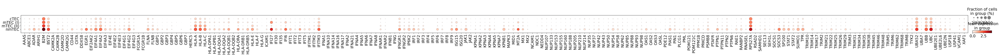

In [30]:
id_gs = 'R-HSA-913531'
sc.pl.dotplot(adata, [x for x in df_reactome.loc[id_gs, 'genes'] if x in adata.raw.var.index], groupby='TEC_cluster')

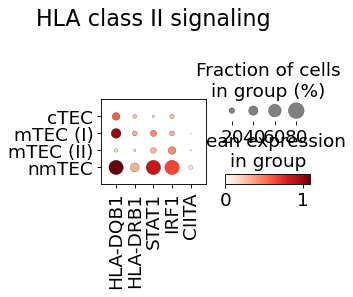

In [50]:
sc.pl.dotplot(adata, ['HLA-DQB1', 'HLA-DRB1', 'STAT1', 'IRF1', 'CIITA'], groupby='TEC_cluster', title='HLA class II signaling',
             save='hlaclassII.pdf')

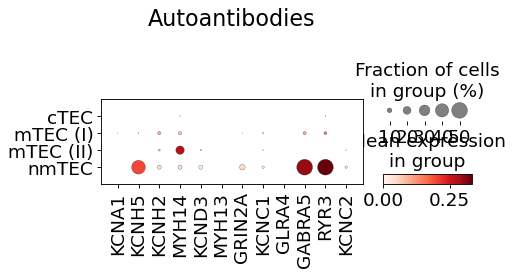

In [16]:
sc.pl.dotplot(adata, ['KCNA1', 'KCNH5', 'KCNH2', 'MYH14', 'KCND3', 'MYH13', 'GRIN2A',
                     'KCNC1', 'GLRA4', 'GABRA5', 'RYR3', 'KCNC2'], groupby='TEC_cluster', title='Autoantibodies',
             save='autoantibodies.pdf')

## TF and TRA

### TF database
Lambert SA, Jolma A, Campitelli LF, Das PK, Yin Y, Albu M, Chen X, Taipale J, Hughes TR, Weirauch MT.(2018) The Human Transcription Factors. Cell. 172(4):650-665. doi: 10.1016/j.cell.2018.01.029. Review.

In [196]:
from scipy.stats import mannwhitneyu
import statsmodels.stats.multitest as multi

df_yellow_lfc1 = pd.read_csv('../TCGA_thymoma/200703_DSeq2WGCNA/yellowlfc1.txt', header=None)
df_yellow_lfc1.head()
list_yellow_ex = [x for x in list(df_yellow_lfc1[0]) if x in adata.raw.var.index]
df_yellow_ex = pd.DataFrame(list_yellow_ex)
df_yellow_ex.columns= ['gene']

list_p = []
for g in df_yellow_ex.gene:
    try:
        stat, p = mannwhitneyu(adata_TEC.raw[adata_TEC.obs['TEC_cluster'] == 'nmTEC', g].X,
                           adata_TEC.raw[adata_TEC.obs['TEC_cluster'] != 'nmTEC', g].X)
    except:
        p = 1
    list_p.append(p)
df_yellow_ex['pval'] = list_p
df_yellow_ex['FDR'] = multi.multipletests(df_yellow_ex['pval'], method='fdr_bh')[1]

In [197]:
list_TF = list(pd.read_csv('data/TF_names_v_1.01.txt', header=None)[0])
df_yellow_ex['TF'] = df_yellow_ex['gene'].isin(list_TF)

In [198]:
df_gtex = pd.read_csv(
    '/home/yyasumizu/media32TB/bioinformatics/reference/gtex/GTEx_Analysis_2017-06-05_v8_RNASeQCv1.1.9_gene_tpm.gct.gz',
sep='\t', skiprows=2)
df_gtex.index = df_gtex['Description']
df_gtex.index.name = 'gene'
df_gtex = df_gtex.drop(columns=['Name', 'Description'])

df_gtex_annot = pd.read_csv(
    "/home/yyasumizu/media32TB/bioinformatics/reference/gtex/GTEx_Analysis_v8_Annotations_SampleAttributesDS.txt", 
    sep='\t', index_col=0
)

df_gtex_annot = df_gtex_annot[['SMTS']]

In [199]:
def gini(array):
    """Calculate the Gini coefficient of a numpy array."""
    # based on bottom eq:
    # http://www.statsdirect.com/help/generatedimages/equations/equation154.svg
    # from:
    # http://www.statsdirect.com/help/default.htm#nonparametric_methods/gini.htm
    # All values are treated equally, arrays must be 1d:
    array = array.flatten()
    if np.amin(array) < 0:
        # Values cannot be negative:
        array -= np.amin(array)
    # Values cannot be 0:
    array += 0.0000001
    # Values must be sorted:
    array = np.sort(array)
    # Index per array element:
    index = np.arange(1,array.shape[0]+1)
    # Number of array elements:
    n = array.shape[0]
    # Gini coefficient:
    return ((np.sum((2 * index - n  - 1) * array)) / (n * np.sum(array)))

In [200]:
l_tis = []
l_max_tis = []
l_mean_tis = []
l_gini = []
for g in df_yellow_ex.gene:
    try:
        d_g = pd.DataFrame(df_gtex.loc[g])
        d_g.columns = [g]
        d_g['tissue'] = df_gtex_annot.loc[d_g.index]
        d_m = d_g.groupby(by='tissue').mean()
        l_tis.append(list(d_m[d_m > d_m.mean()].dropna().sort_values(by=g, ascending=False).index))
        l_max_tis.append(d_m.max()[g])
        l_mean_tis.append(d_m.mean()[g])
        l_gini.append(gini(np.array(d_m[g])))
    except:
        l_tis.append([np.nan])
        l_max_tis.append(np.nan)
        l_mean_tis.append(np.nan)
        l_gini.append(np.nan)
    
df_yellow_ex['GTEx tissues'] = l_tis
df_yellow_ex['GTEx mean exp across tissues'] = l_mean_tis
df_yellow_ex['GTEx max exp across tissues'] = l_max_tis
df_yellow_ex['GTEx Gini index'] = l_gini

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]),
 [Text(0, 0, 'Adipose Tissue'),
  Text(1, 0, 'Muscle'),
  Text(2, 0, 'Blood Vessel'),
  Text(3, 0, 'Heart'),
  Text(4, 0, 'Uterus'),
  Text(5, 0, 'Vagina'),
  Text(6, 0, 'Breast'),
  Text(7, 0, 'Skin'),
  Text(8, 0, 'Salivary Gland'),
  Text(9, 0, 'Brain'),
  Text(10, 0, 'Adrenal Gland'),
  Text(11, 0, 'Thyroid'),
  Text(12, 0, 'Lung'),
  Text(13, 0, 'Spleen'),
  Text(14, 0, 'Pancreas'),
  Text(15, 0, 'Esophagus'),
  Text(16, 0, 'Stomach'),
  Text(17, 0, 'Colon'),
  Text(18, 0, 'Small Intestine'),
  Text(19, 0, 'Prostate'),
  Text(20, 0, 'Testis'),
  Text(21, 0, 'Nerve'),
  Text(22, 0, 'Blood'),
  Text(23, 0, 'Pituitary'),
  Text(24, 0, 'Ovary'),
  Text(25, 0, 'Liver'),
  Text(26, 0, 'Kidney'),
  Text(27, 0, 'Cervix Uteri'),
  Text(28, 0, 'Fallopian Tube'),
  Text(29, 0, 'Bladder')])

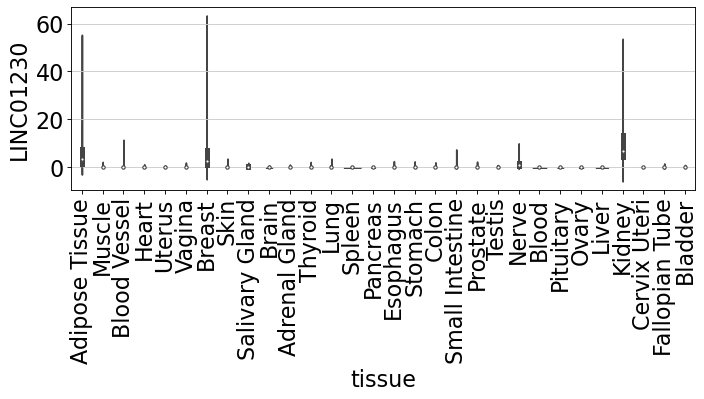

In [202]:
d_g = pd.DataFrame(df_gtex.loc[g])
d_g.columns = [g]
d_g['tissue'] = df_gtex_annot.loc[d_g.index]

plt.figure(figsize=(10,3))
sns.violinplot(data=d_g, x="tissue", y=g)
plt.xticks(rotation=90)

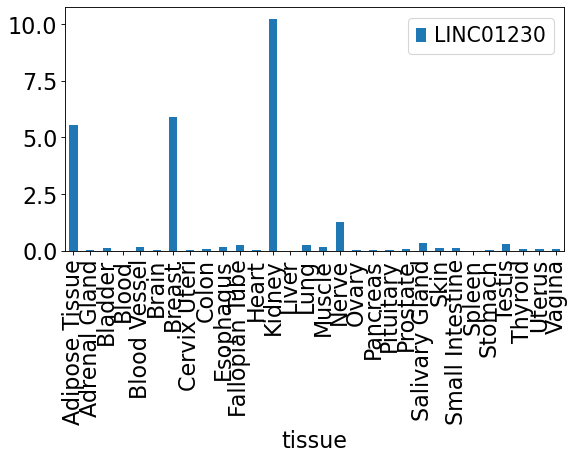

In [203]:

d_g.groupby(by='tissue').mean().plot.bar(figsize=(8,4))
plt.grid(False)

In [204]:
df_yellow_ex

,gene,pval,FDR,TF,GTEx tissues,GTEx mean exp across tissues,GTEx max exp across tissues,GTEx Gini index
0,ETV1,1,1.0,True,"[Brain, Lung, Adrenal Gland, Nerve, Pituitary,...",5.009985,31.260577,0.526663
126,WFIKKN2,1,1.0,False,[Ovary],10.090602,275.458767,0.926626
127,PCSK1,1,1.0,False,"[Pituitary, Brain, Blood Vessel, Salivary Glan...",2.549759,24.906004,0.630173
128,PLEKHD1,1,1.0,False,"[Thyroid, Brain, Testis, Skin, Kidney, Breast,...",0.770823,5.741364,0.667889
129,TCERG1L,1,1.0,False,"[Thyroid, Ovary, Testis, Brain, Pituitary]",1.899454,32.163870,0.843847
...,...,...,...,...,...,...,...,...
69,SUSD4,1,1.0,False,"[Ovary, Pituitary, Vagina, Brain, Esophagus, S...",7.835696,56.353489,0.640940
70,S100A8,1,1.0,False,"[Vagina, Esophagus, Blood, Salivary Gland, Spl...",813.175111,7537.693647,0.813928
71,EPHA5,1,1.0,False,"[Brain, Nerve, Cervix Uteri, Thyroid, Pituitar...",0.484877,2.071971,0.619630
73,FAXC,1,1.0,False,"[Brain, Colon, Pituitary, Bladder, Esophagus, ...",1.559758,5.570259,0.585950


In [135]:
pd.Series([x[0] for x in df_yellow_ex['GTEx tissues']]).value_counts()

Brain              42
Pituitary          18
Testis             16
Vagina             10
Skin                9
Liver               9
Adrenal Gland       7
Thyroid             7
Salivary Gland      7
Ovary               6
Nerve               5
Uterus              5
Blood Vessel        4
Muscle              4
Prostate            3
Lung                3
Kidney              3
Blood               3
Stomach             3
Colon               3
Heart               3
Fallopian Tube      2
Esophagus           1
Pancreas            1
Spleen              1
Small Intestine     1
Cervix Uteri        1
dtype: int64

In [136]:
d_m = d_g.groupby(by='tissue').mean()
list(d_m[d_m > d_m.mean()].dropna().index)

['Adipose Tissue', 'Breast', 'Kidney', 'Nerve']

In [207]:
df_gini = pd.DataFrame([], index=adata.raw.var.index)

In [208]:
l_tis = []
l_max_tis = []
l_mean_tis = []
l_gini = []
for g in df_gini.index:
    try:
        d_g = pd.DataFrame(df_gtex.loc[g])
        d_g.columns = [g]
        d_g['tissue'] = df_gtex_annot.loc[d_g.index]
        d_m = d_g.groupby(by='tissue').mean()
        l_tis.append(list(d_m[d_m > d_m.mean()].dropna().sort_values(by=g, ascending=False).index))
        l_max_tis.append(d_m.max()[g])
        l_mean_tis.append(d_m.mean()[g])
        l_gini.append(gini(np.array(d_m[g])))
    except:
        l_tis.append([np.nan])
        l_max_tis.append(np.nan)
        l_mean_tis.append(np.nan)
        l_gini.append(np.nan)
    
df_gini['GTEx tissues'] = l_tis
df_gini['GTEx mean exp across tissues'] = l_mean_tis
df_gini['GTEx max exp across tissues'] = l_max_tis
df_gini['GTEx Gini index'] = l_gini

<AxesSubplot:ylabel='Frequency'>

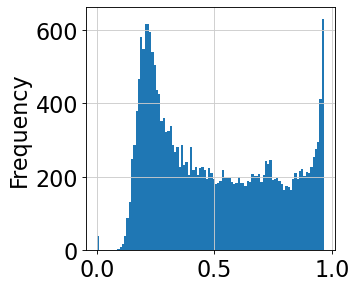

In [211]:
df_gini['GTEx Gini index'].plot.hist(bins=100)

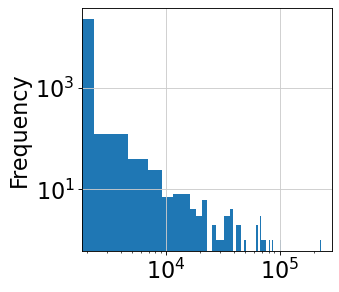

In [219]:
df_gini['GTEx max exp across tissues'].plot.hist(bins=100)
plt.xscale('log')
plt.yscale('log')

In [221]:
df_gini['GTEx max exp across tissues'].describe()

count     23043.000000
mean        215.249465
std        2587.815395
min           0.000000
25%           7.016250
50%          27.591357
75%          76.356334
max      230064.570448
Name: GTEx max exp across tissues, dtype: float64

computing score 'score_TRA'
    finished: added
    'score_TRA', score of gene set (adata.obs).
    677 total control genes are used. (0:00:00)


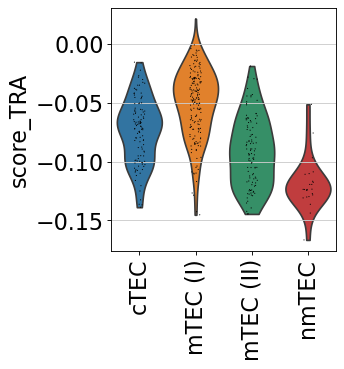

In [230]:
th_gini = 0.8
th_exp = 100

list_tra = list(df_gini[(df_gini['GTEx Gini index'] > th_gini) & (df_gini['GTEx max exp across tissues'] > th_exp)].index)
sc.tl.score_genes(adata, list_tra, use_raw=True, score_name='score_TRA')
sc.pl.violin(adata, ['score_TRA'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='score_TRA.pdf')

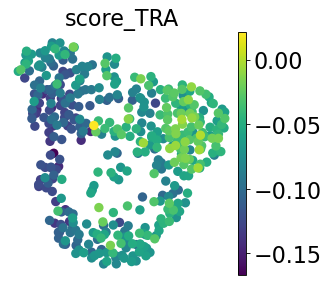

In [231]:
sc.pl.umap(adata, color='score_TRA')

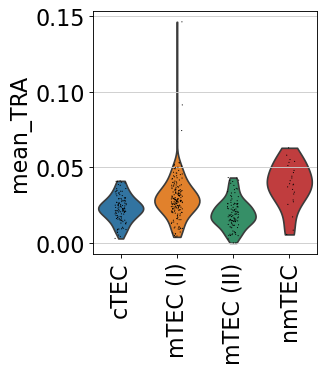

In [232]:
adata.obs['mean_TRA'.format(id_gs)] = np.array(adata.raw[:,list_tra].X.todense()).mean(axis=1)
sc.pl.violin(adata, ['mean_TRA'.format(id_gs)], groupby='TEC_cluster', log=False,
             rotation=90, save='TRA_mean.pdf'.format(id_gs))

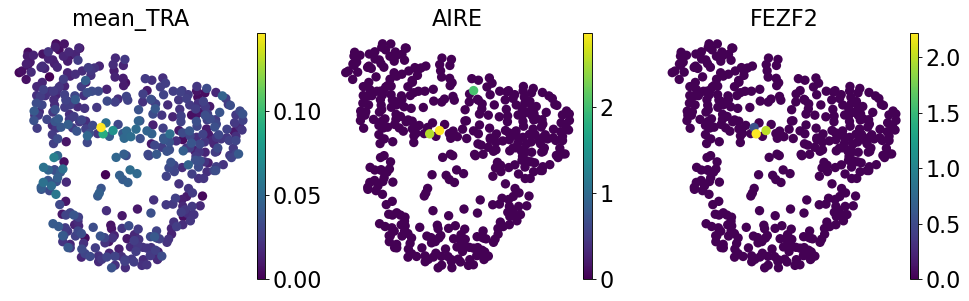

In [238]:
sc.pl.umap(adata, color=['mean_TRA', 'AIRE', 'FEZF2'], save='TRA.pdf')

In [247]:
df_gini

,GTEx tissues,GTEx mean exp across tissues,GTEx max exp across tissues,GTEx Gini index
MIR1302-2HG,"[Testis, Brain, Kidney, Thyroid, Heart, Liver,...",0.020279,0.065937,0.235067
FAM138A,"[Fallopian Tube, Testis, Cervix Uteri, Heart, ...",0.008179,0.016543,0.153983
OR4F5,"[Heart, Brain, Kidney, Liver, Adrenal Gland, M...",0.071635,0.171529,0.267975
AL627309.1,[nan],NaN,NaN,NaN
AL627309.3,[nan],NaN,NaN,NaN
...,...,...,...,...
AC141272.1,[nan],NaN,NaN,NaN
AC023491.2,[nan],NaN,NaN,NaN
AC007325.1,[nan],NaN,NaN,NaN
AC007325.4,[nan],NaN,NaN,NaN


In [250]:
pd.DataFrame(list(df_gini[(df_gini['GTEx Gini index'] > th_gini) & (df_gini['GTEx max exp across tissues'] > th_exp)].index)).to_csv(
    './data/gtexv8_tra_gini{}_exp{}.csv'.format(th_gini, th_exp))